# Penalaan Parameter PID Menggunakan Deep Learning pada Kit iTCLab

![PID_Deep_Learning](Deep_PID_iTCLab.jpg)
Proses penalaan nilai Kc, τI dan τD pada
pengendali PID menggunakan Deep Learning pada Kit iTCLab

In [18]:
import itclab
import numpy as np
import time
import matplotlib.pyplot as plt
from scipy.integrate import odeint
import random

In [19]:
# Machine Learning - Building Datasets and Model
# Impor `Sequential` dari` keras.models`
from keras.models import Sequential

# Impor `Dense` dari` keras.layers`
from keras.layers import Dense

# Inisialisasi konstruktor
model = Sequential()

# Tambahkan lapisan masukan 
model.add(Dense(2, activation='sigmoid', input_shape=(2,)))

# Tambahkan satu lapisan tersembunyi
model.add(Dense(3, activation='sigmoid'))

# Tambahkan lapisan keluaran
model.add(Dense(3, activation='sigmoid'))

# Data Latih.
X = np.array([
    [1, 1],
    [0.4, 1.2],
    [1.2, 0.1],
    [1, 0.1]
])

# Label untuk Data Latih.
y = np.array([
    [0.25, 4.31, 0.20],
    [0.2, 4.1, 0.1],
    [0.1, 4.0, 0],
    [0.1, 4.0, 0]
])

# Bentuk keluaran model
model.output_shape

# Ringkasan model
model.summary()

# Konfigurasi model
model.get_config()

# Buat daftar semua tensor bobot 
model.get_weights()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_6 (Dense)              (None, 2)                 6         
_________________________________________________________________
dense_7 (Dense)              (None, 3)                 9         
_________________________________________________________________
dense_8 (Dense)              (None, 3)                 12        
Total params: 27
Trainable params: 27
Non-trainable params: 0
_________________________________________________________________


[array([[6.5393162e-01, 6.7713737e-02],
        [5.0425529e-04, 1.0704283e+00]], dtype=float32),
 array([0., 0.], dtype=float32),
 array([[-0.93929756,  0.2688167 ,  0.72485137],
        [-0.41020244, -0.02721882, -0.94742715]], dtype=float32),
 array([0., 0., 0.], dtype=float32),
 array([[-0.4296105 ,  0.40214276,  0.4186678 ],
        [-0.47313523, -0.98684573, -0.50045466],
        [-0.6002219 , -0.28775287, -0.6932709 ]], dtype=float32),
 array([0., 0., 0.], dtype=float32)]

In [20]:
model.compile(loss='binary_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
                   
model.fit(X, y,epochs=100, batch_size=1, verbose=1)

Epoch 1/100
4/4 [==============================] - 0s 2ms/step - loss: 1.2397 - accuracy: 0.0000e+00
Epoch 2/100
4/4 [==============================] - 0s 2ms/step - loss: 1.2222 - accuracy: 0.0000e+00
Epoch 3/100
4/4 [==============================] - 0s 3ms/step - loss: 1.2049 - accuracy: 0.0000e+00
Epoch 4/100
4/4 [==============================] - 0s 3ms/step - loss: 1.1876 - accuracy: 0.0000e+00
Epoch 5/100
4/4 [==============================] - 0s 3ms/step - loss: 1.1704 - accuracy: 0.5000
Epoch 6/100
4/4 [==============================] - 0s 3ms/step - loss: 1.1532 - accuracy: 0.7500
Epoch 7/100
4/4 [==============================] - 0s 4ms/step - loss: 1.1362 - accuracy: 1.0000
Epoch 8/100
4/4 [==============================] - 0s 4ms/step - loss: 1.1191 - accuracy: 1.0000
Epoch 9/100
4/4 [==============================] - 0s 2ms/step - loss: 1.1021 - accuracy: 1.0000
Epoch 10/100
4/4 [==============================] - 0s 2ms/step - loss: 1.0852 - accuracy: 1.0000
Epoch 11/100


In [21]:
######################################################
# Use this script for evaluating model predictions   #
# and PID controller performance for the TCLab       #
# Adjust only PID and model sections                 #
######################################################

######################################################
# PID Controller                                     #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution
def pid(sp,pv,pv_last,ierr,dt):
    Kc   = 10.0 # K/%Heater
    tauI = 50.0 # sec
    tauD = 1.0  # sec
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0
    # calculate the error
    error = sp-pv
    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [22]:
######################################################
# PID Controller using Deep Learning                 #
######################################################
# inputs -----------------------------------
# sp = setpoint
# pv = current temperature
# pv_last = prior temperature
# ierr = integral error
# dt = time increment between measurements
# outputs ----------------------------------
# op = output of the PID controller
# P = proportional contribution
# I = integral contribution
# D = derivative contribution

def pid_dl(sp,pv,pv_last,ierr,dt):

    # calculate the error
    error = sp-pv
    d_error = sp-pv_last
    delta_error = (error - d_error)
    
    outDL = model.predict(np.array([[error,delta_error]]))
    
    Kc = outDL[0,0]
    tauI = outDL[0,1]
    tauD = outDL[0,2]
    
    # Parameters in terms of PID coefficients
    KP = Kc
    KI = Kc/tauI
    KD = Kc*tauD
    # ubias for controller (initial heater)
    op0 = 0 
    # upper and lower bounds on heater level
    ophi = 100
    oplo = 0

    # calculate the integral error
    ierr = ierr + KI * error * dt
    # calculate the measurement derivative
    dpv = (pv - pv_last) / dt
    # calculate the PID output
    P = KP * error
    I = ierr
    D = -KD * dpv
    op = op0 + P + I + D
    # implement anti-reset windup
    if op < oplo or op > ophi:
        I = I - KI * error * dt
        # clip output
        op = max(oplo,min(ophi,op))
    # return the controller output and PID terms
    return [op,P,I,D]

In [23]:
######################################################
# FOPDT model                                        #
######################################################
Kp = 0.5      # degC/%
tauP = 120.0  # seconds
thetaP = 10   # seconds (integer)
Tss = 23      # degC (ambient temperature)
Qss = 0       # % heater

######################################################
# Energy balance model                               #
######################################################
def heat(x,t,Q):
    # Parameters
    Ta = 23 + 273.15   # K
    U = 10.0           # W/m^2-K
    m = 4.0/1000.0     # kg
    Cp = 0.5 * 1000.0  # J/kg-K    
    A = 12.0 / 100.0**2 # Area in m^2
    alpha = 0.01       # W / % heater
    eps = 0.9          # Emissivity
    sigma = 5.67e-8    # Stefan-Boltzman

    # Temperature State 
    T = x[0]

    # Nonlinear Energy Balance
    dTdt = (1.0/(m*Cp))*(U*A*(Ta-T) \
            + eps * sigma * A * (Ta**4 - T**4) \
            + alpha*Q)
    return dTdt

Opening connection
iTCLab connected via Arduino on port COM3
LED On
Running Main Loop. Ctrl-C to end.
  Time     SP     PV     Q1   =  P   +  I  +   D
   0.0  25.00  29.92   0.00   0.00   0.00   0.00


<Figure size 720x504 with 0 Axes>

   1.0  25.00  29.86   0.00  -0.93   0.00   0.00


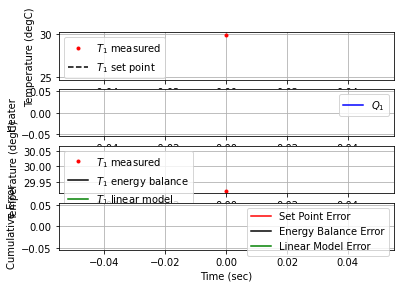

   3.3  25.00  29.78   0.00  -0.91   0.00   0.00


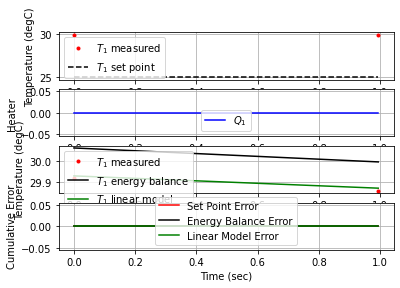

   4.6  25.00  29.74   0.00  -0.90   0.00   0.00


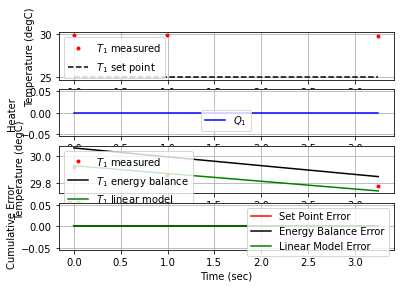

   6.1  25.00  29.54   0.00  -0.87   0.00   0.01


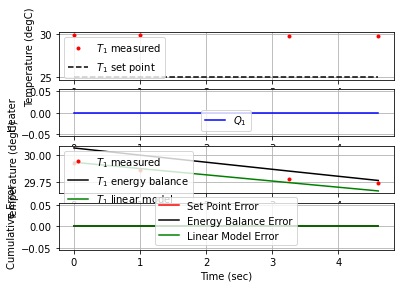

   7.4  25.00  29.48   0.00  -0.86   0.00   0.00


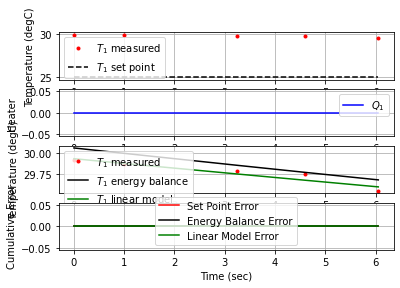

   8.8  25.00  29.58   0.00  -0.87   0.00  -0.00


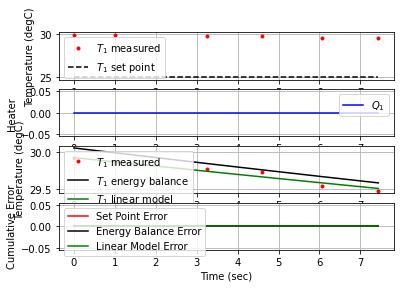

  10.3  25.00  29.50   0.00  -0.86   0.00   0.00


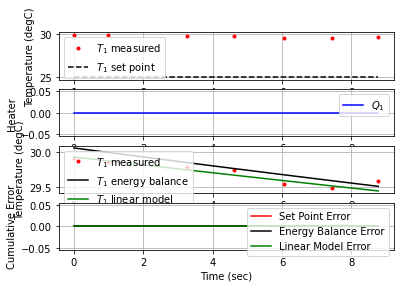

  11.5  25.00  29.62   0.00  -0.88   0.00  -0.00


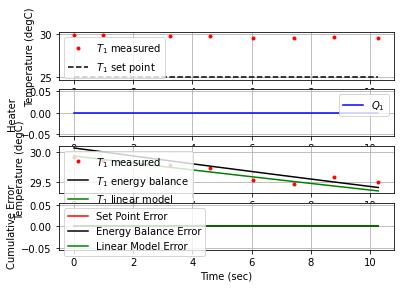

  12.8  25.00  29.34   0.00  -0.84   0.00   0.01


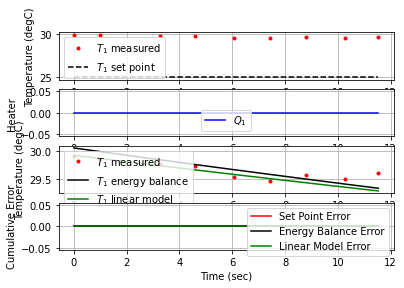

  14.2  25.00  29.49   0.00  -0.85   0.00  -0.01


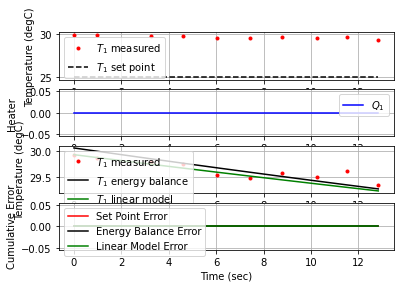

  15.5  25.00  29.57   0.00  -0.87   0.00  -0.00


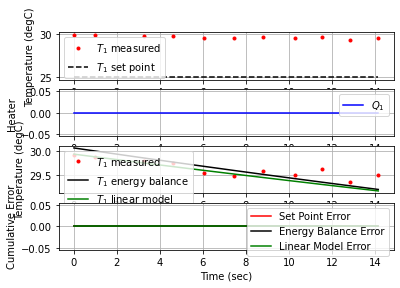

  16.9  25.00  29.51   0.00  -0.86   0.00   0.00


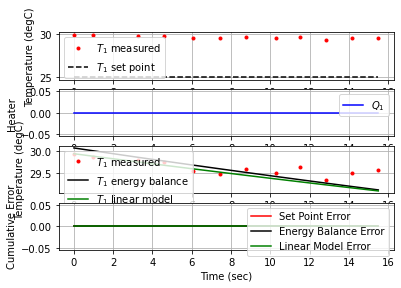

  18.4  25.00  29.47   0.00  -0.86   0.00   0.00


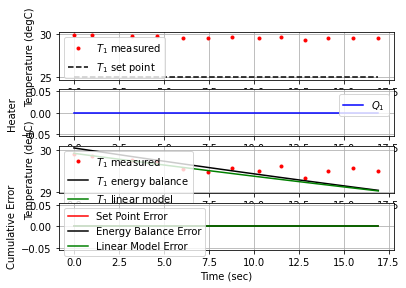

  19.8  25.00  29.51   0.00  -0.86   0.00  -0.00


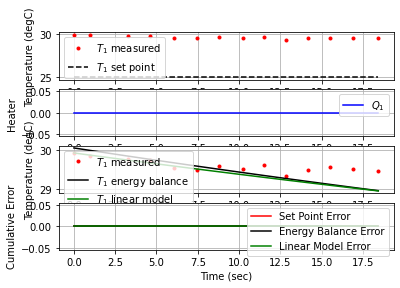

  21.2  25.00  29.40   0.00  -0.85   0.00   0.00


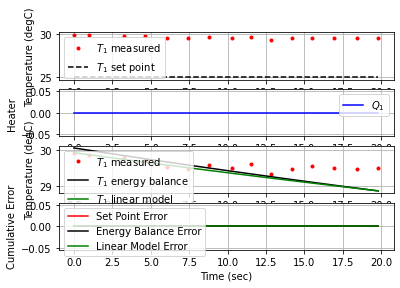

  22.5  25.00  29.61   0.00  -0.87   0.00  -0.01


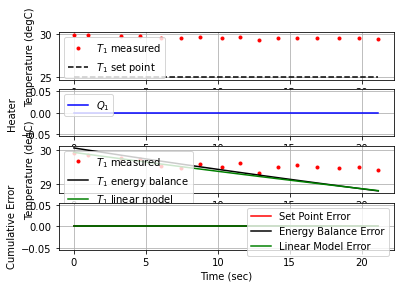

  23.9  25.00  29.46   0.00  -0.86   0.00   0.00


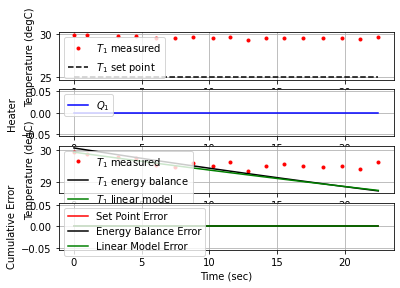

  25.2  25.00  29.39   0.00  -0.84   0.00   0.00


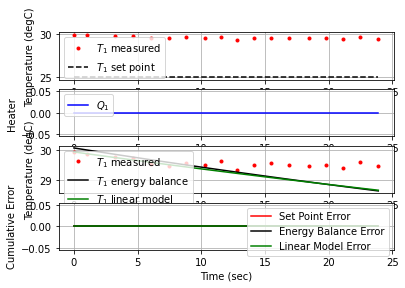

  26.5  25.00  29.41   0.00  -0.84   0.00  -0.00


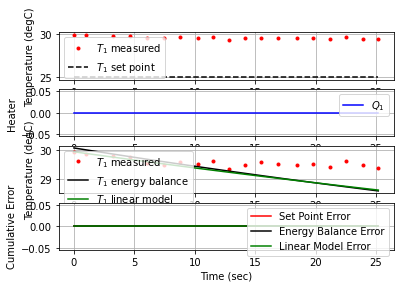

  27.8  25.00  29.25   0.00  -0.82   0.00   0.01


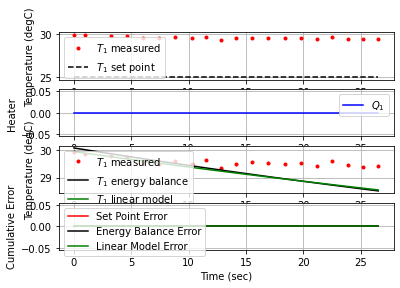

  29.1  25.00  29.35   0.00  -0.83   0.00  -0.00


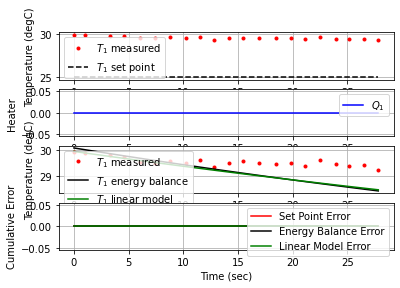

  30.4  25.00  29.32   0.00  -0.83   0.00   0.00


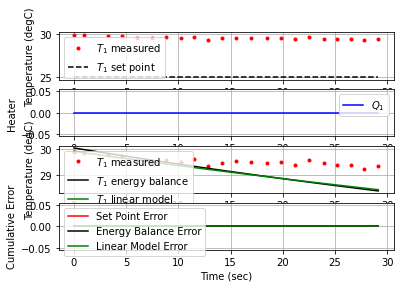

  31.9  25.00  29.31   0.00  -0.82   0.00   0.00


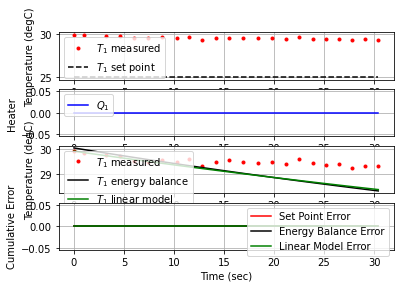

  33.3  25.00  29.10   0.00  -0.80   0.00   0.01


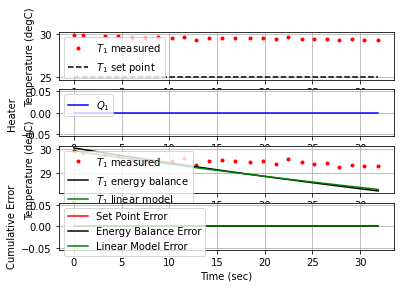

  34.6  25.00  29.21   0.00  -0.80   0.00  -0.00


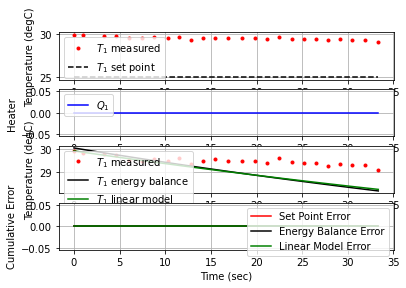

  36.0  25.00  29.24   0.00  -0.81   0.00  -0.00


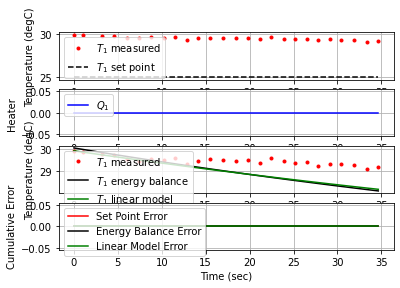

  37.5  25.00  29.14   0.00  -0.80   0.00   0.00


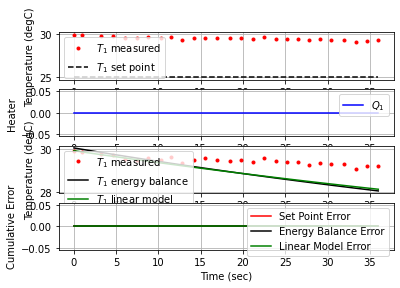

  39.0  25.00  29.06   0.00  -0.78   0.00   0.00


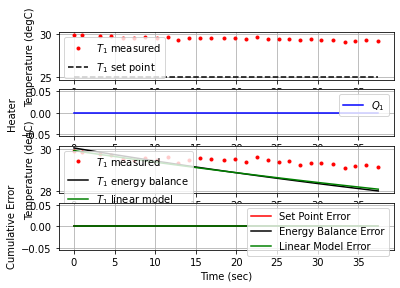

  40.3  25.00  29.12   0.00  -0.79   0.00  -0.00


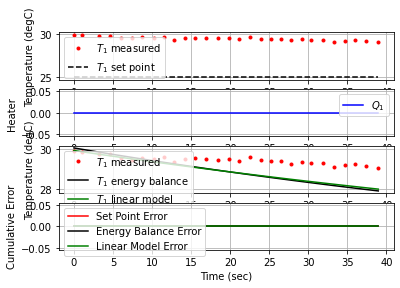

  41.7  25.00  29.27   0.00  -0.81   0.00  -0.00


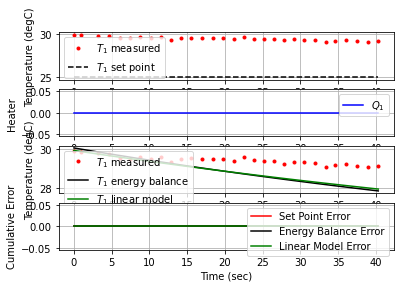

  43.1  25.00  29.27   0.00  -0.82   0.00  -0.00


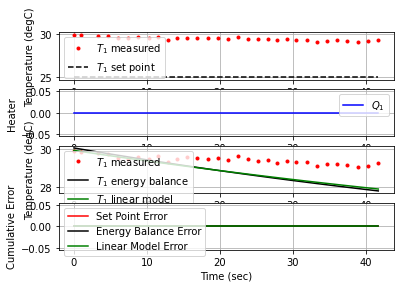

  44.4  25.00  29.40   0.00  -0.84   0.00  -0.00


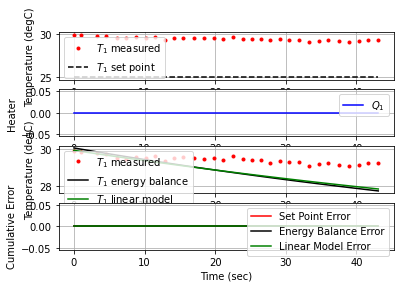

  45.8  25.00  29.31   0.00  -0.83   0.00   0.00


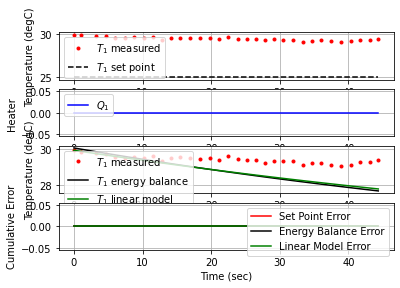

  47.1  25.00  29.36   0.00  -0.83   0.00  -0.00


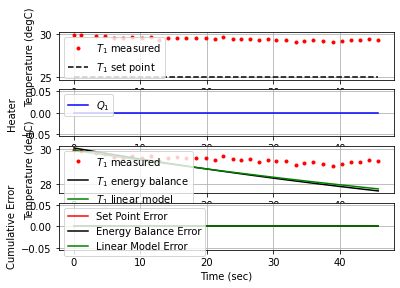

  48.4  25.00  29.44   0.00  -0.85   0.00  -0.00


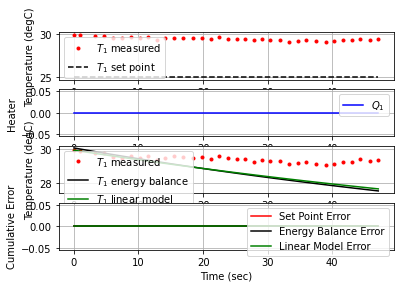

  49.7  25.00  29.39   0.00  -0.84   0.00   0.00


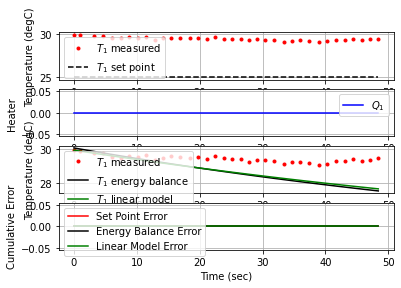

  51.0  25.00  29.29   0.00  -0.83   0.00   0.00


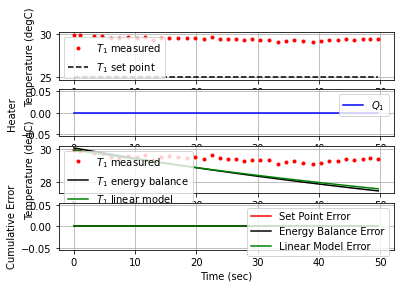

  52.4  25.00  29.28   0.00  -0.82   0.00   0.00


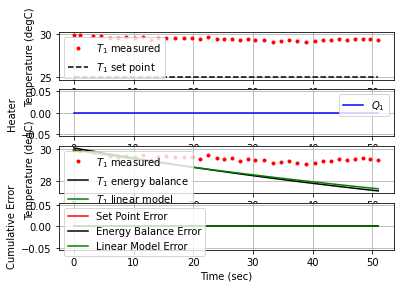

  53.7  25.00  29.33   0.00  -0.83   0.00  -0.00


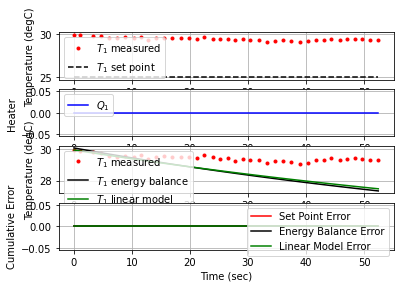

  55.0  25.00  29.20   0.00  -0.81   0.00   0.00


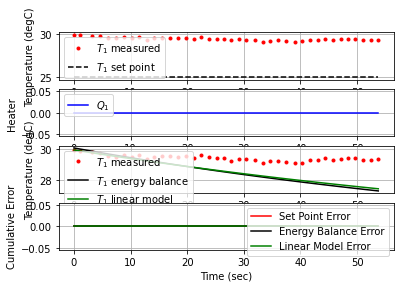

  56.3  25.00  29.21   0.00  -0.81   0.00  -0.00


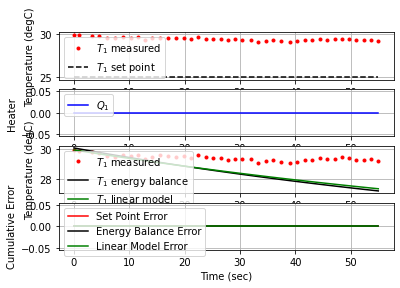

  57.7  25.00  29.32   0.00  -0.82   0.00  -0.00


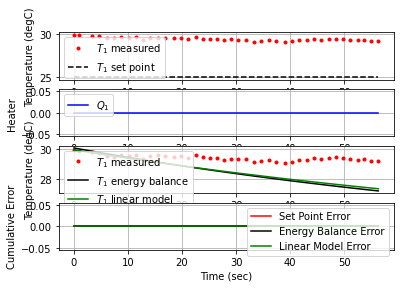

  59.0  25.00  29.11   0.00  -0.80   0.00   0.01


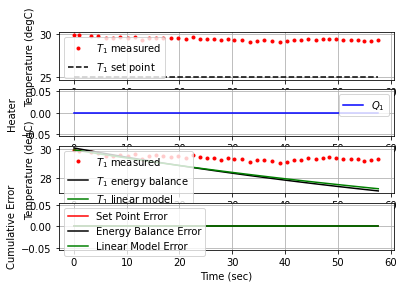

  60.4  25.00  29.04   0.00  -0.78   0.00   0.00


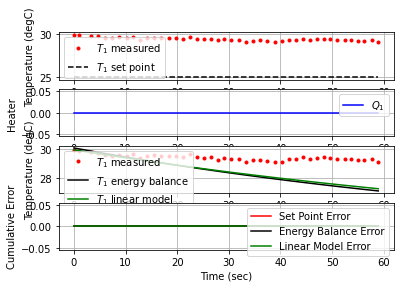

  61.8  25.00  28.92   0.00  -0.76   0.00   0.00


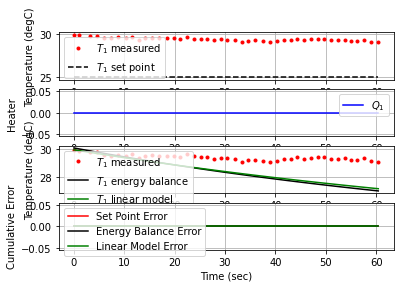

  63.1  25.00  28.94   0.00  -0.76   0.00  -0.00


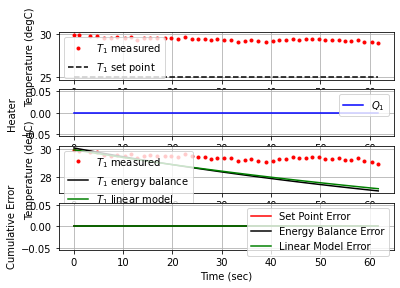

  64.4  25.00  28.79   0.00  -0.74   0.00   0.01


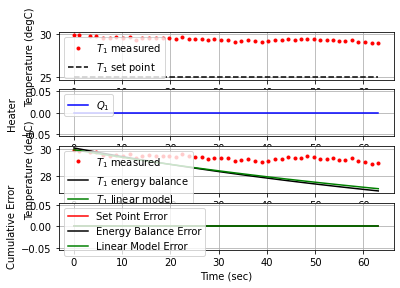

  65.7  25.00  28.85   0.00  -0.74   0.00  -0.00


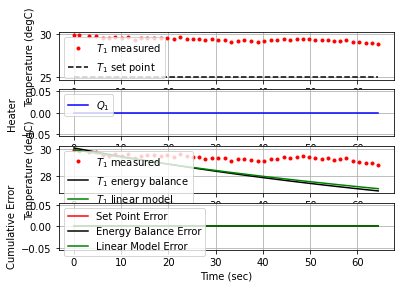

  67.3  25.00  28.60   0.00  -0.71   0.00   0.01


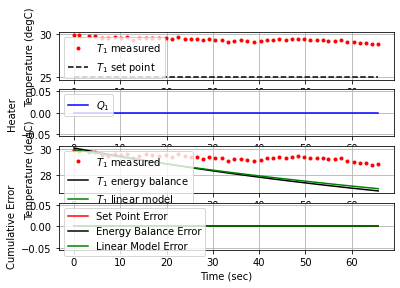

  68.6  25.00  28.71   0.00  -0.71   0.00  -0.00


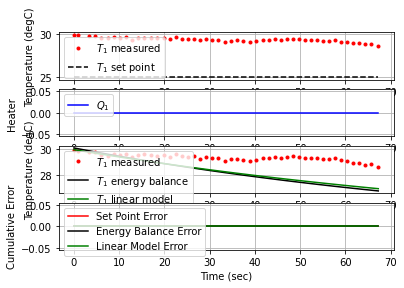

  69.9  25.00  28.68   0.00  -0.71   0.00   0.00


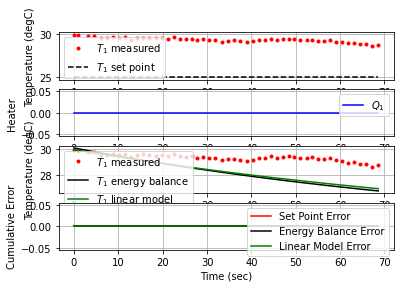

  71.3  25.00  28.55   0.00  -0.69   0.00   0.00


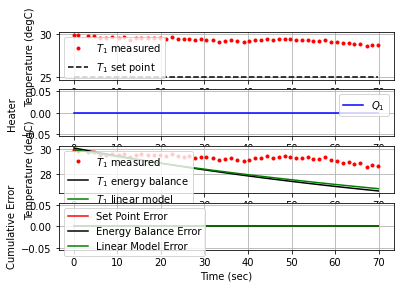

  72.7  25.00  28.54   0.00  -0.68   0.00   0.00


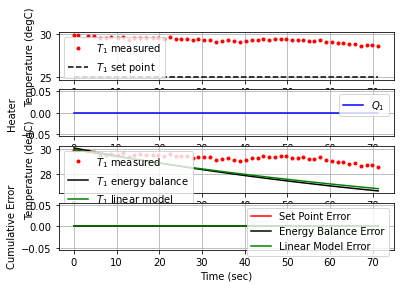

  74.2  25.00  28.79   0.00  -0.72   0.00  -0.01


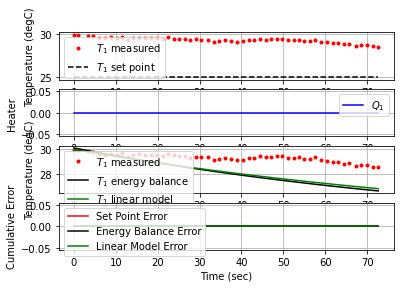

  75.5  25.00  28.48   0.00  -0.69   0.00   0.01


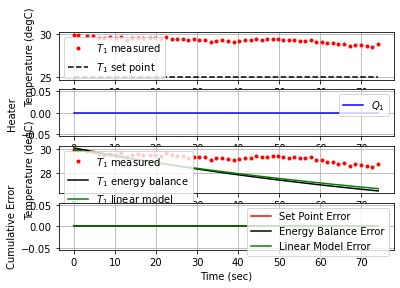

  77.0  25.00  28.45   0.00  -0.67   0.00   0.00


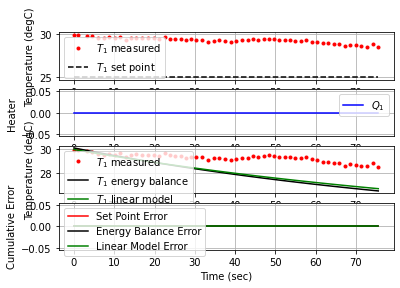

  78.3  25.00  28.58   0.00  -0.69   0.00  -0.00


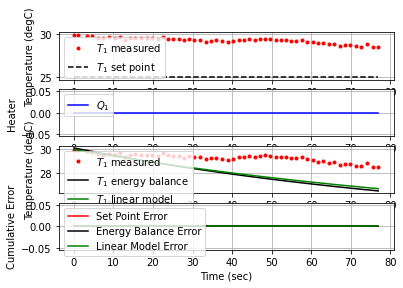

  79.7  25.00  28.56   0.00  -0.69   0.00   0.00


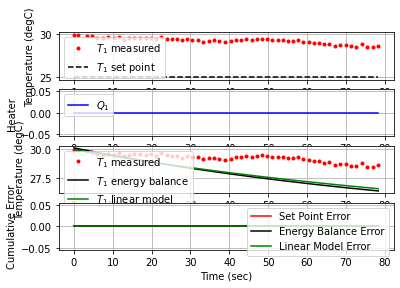

  81.2  25.00  28.42   0.00  -0.67   0.00   0.00


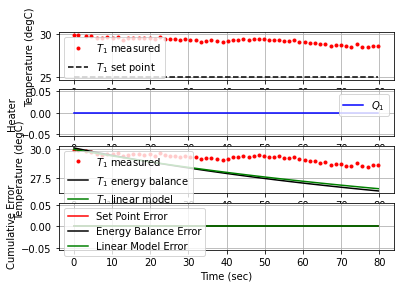

  82.6  45.00  28.39  11.27   3.61   7.65   0.00


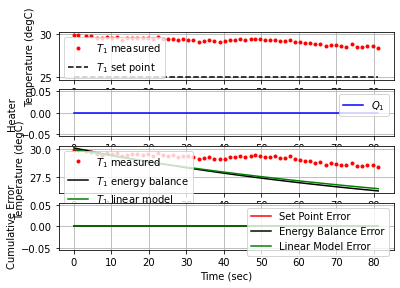

  84.0  45.00  28.28  19.01   3.64  15.37   0.00


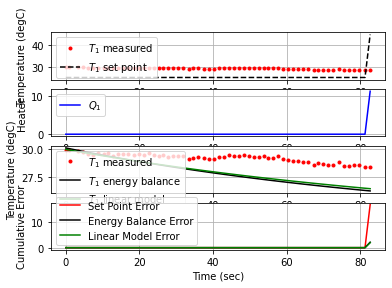

  85.3  45.00  28.21  25.72   3.65  22.07   0.00


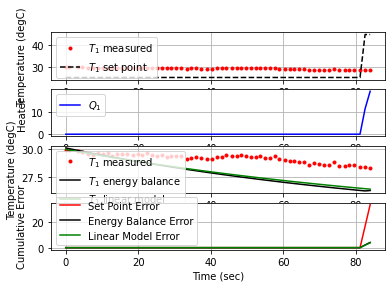

  86.6  45.00  28.30  33.32   3.63  29.69  -0.00


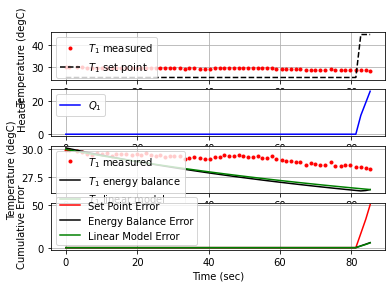

  87.9  45.00  28.32  40.05   3.63  36.42  -0.00


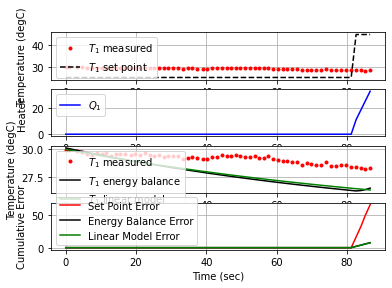

  89.1  45.00  28.43  46.80   3.61  43.20  -0.01


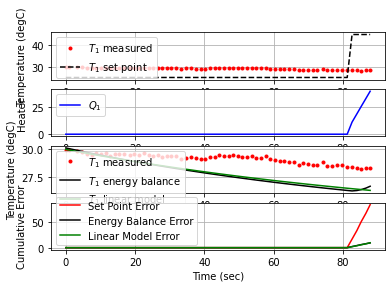

  90.3  45.00  28.41  53.44   3.61  49.83   0.00


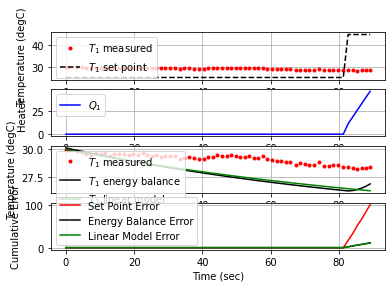

  91.6  45.00  28.37  60.26   3.62  56.64   0.00


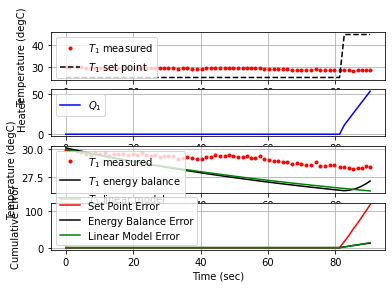

  92.8  45.00  28.39  67.06   3.61  63.45  -0.00


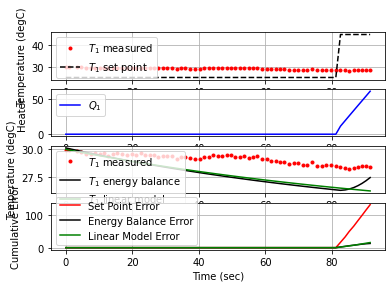

  94.2  45.00  28.49  74.48   3.59  70.90  -0.00


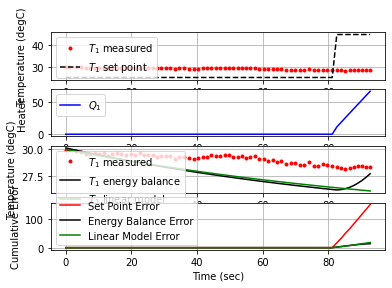

  95.4  45.00  28.72  80.94   3.54  77.40  -0.01


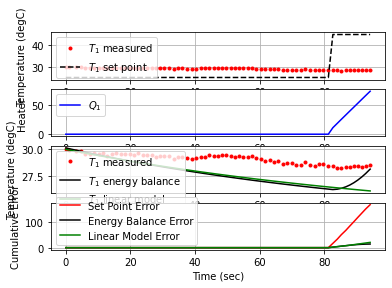

  96.7  45.00  28.52  87.92   3.59  84.33   0.01


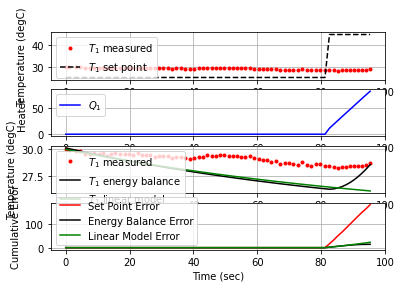

  97.9  45.00  28.57  94.63   3.58  91.06  -0.00


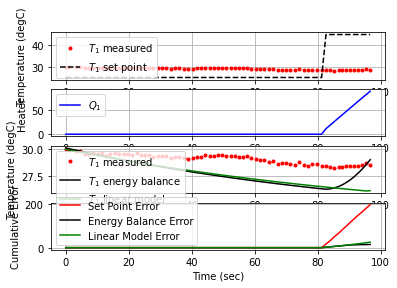

  99.2  45.00  28.59 100.00   3.57  91.06  -0.00


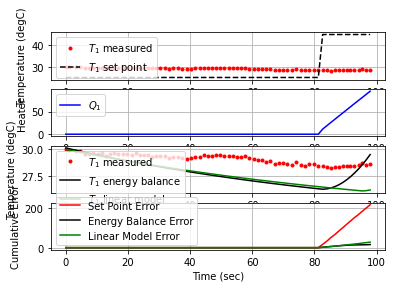

 100.4  45.00  28.75 100.00   3.54  91.06  -0.01


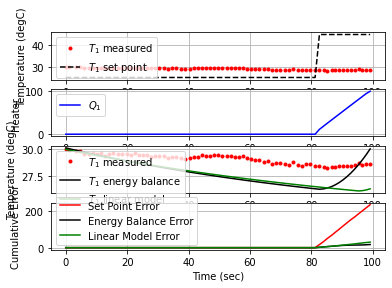

 101.8  45.00  28.90 100.00   3.50  91.06  -0.01


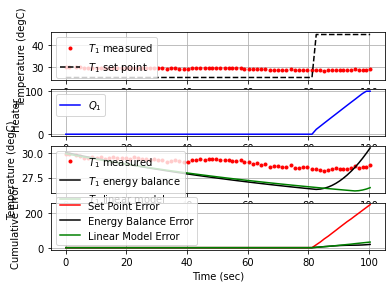

 103.1  45.00  28.99 100.00   3.48  91.06  -0.00


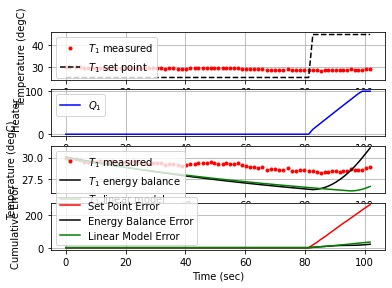

 104.3  45.00  29.08 100.00   3.46  91.06  -0.00


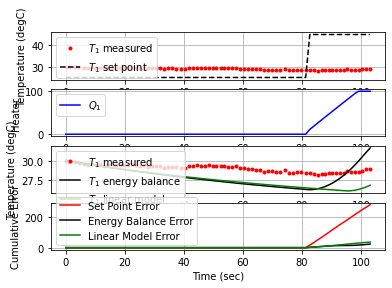

 105.6  45.00  29.14 100.00   3.45  91.06  -0.00


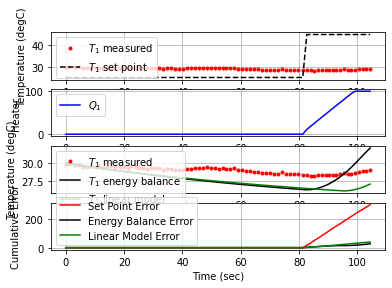

 107.0  45.00  29.16 100.00   3.45  91.06  -0.00


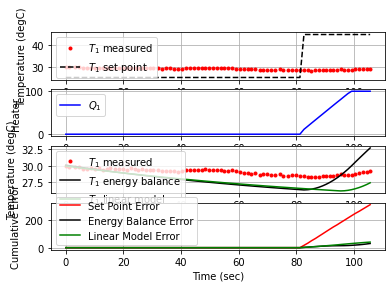

 108.4  45.00  29.34 100.00   3.41  91.06  -0.01


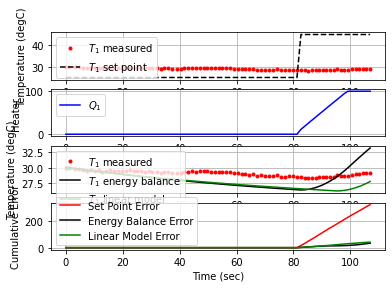

 109.6  45.00  29.45 100.00   3.38  91.06  -0.00


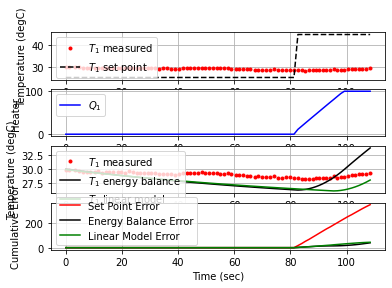

 111.0  45.00  29.53 100.00   3.37  91.06  -0.00


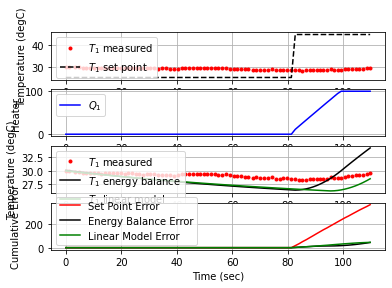

 112.3  45.00  29.51 100.00   3.37  91.06   0.00


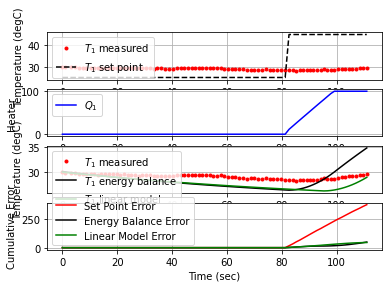

 113.5  45.00  29.52 100.00   3.37  91.06  -0.00


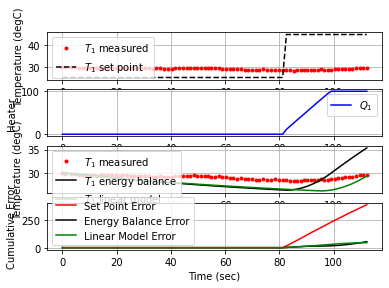

 114.8  45.00  29.79 100.00   3.31  91.06  -0.01


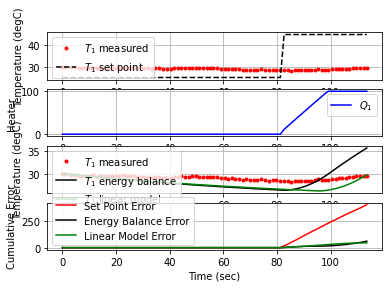

 116.1  45.00  29.90 100.00   3.29  91.06  -0.01


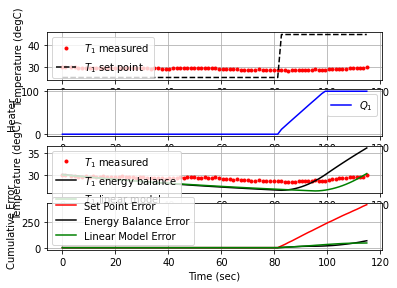

 117.4  45.00  30.19 100.00   3.22  91.06  -0.01


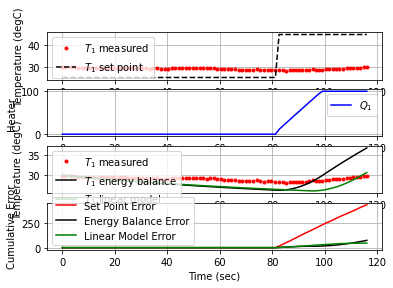

 118.7  45.00  30.32 100.00   3.19  91.06  -0.01


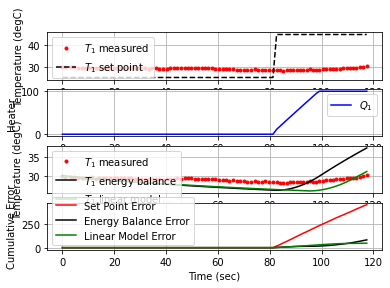

 119.9  45.00  30.38 100.00   3.18  91.06  -0.00


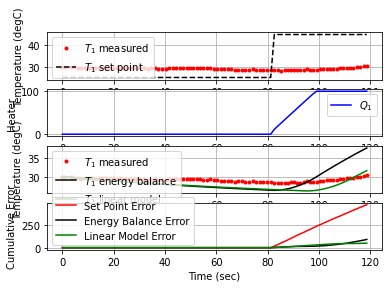

 121.2  45.00  30.51 100.00   3.15  91.06  -0.01


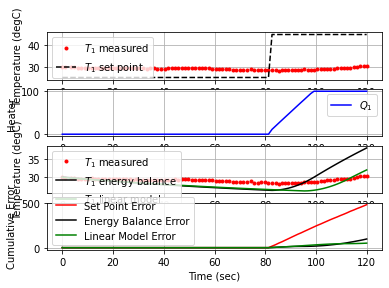

 122.6  45.00  30.58 100.00   3.14  91.06  -0.00


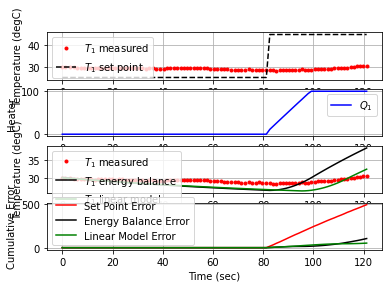

 123.9  45.00  30.60 100.00   3.13  91.06  -0.00


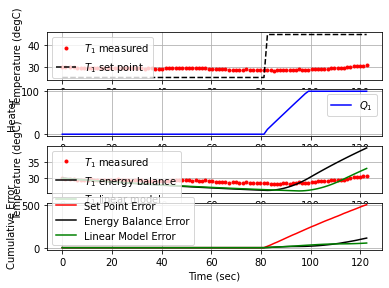

 125.2  45.00  30.83 100.00   3.08  91.06  -0.01


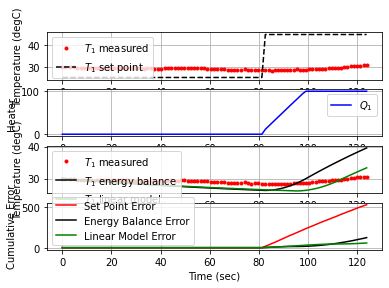

 126.4  45.00  30.86  99.99   3.08  96.92  -0.00


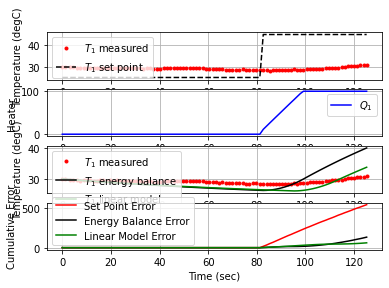

 127.7  45.00  30.85 100.00   3.08  96.92   0.00


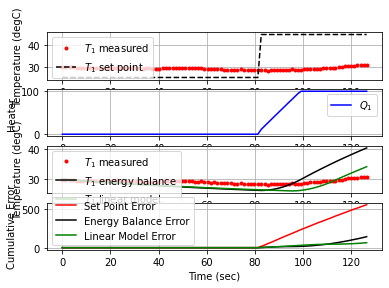

 129.1  45.00  30.79 100.00   3.09  96.92   0.00


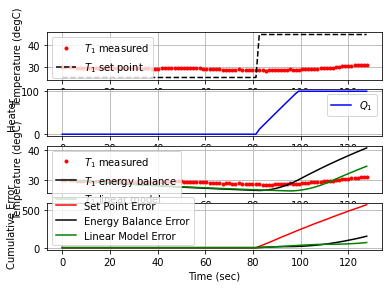

 130.4  45.00  31.01 100.00   3.04  96.92  -0.01


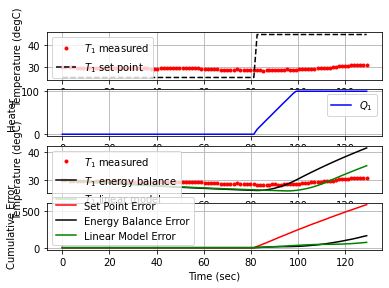

 131.6  45.00  30.98 100.00   3.05  96.92   0.00


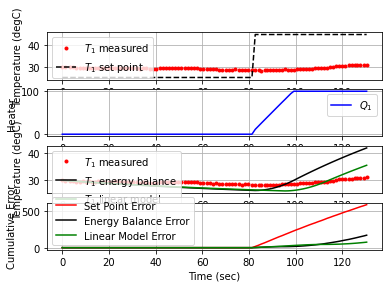

 132.9  45.00  31.12 100.00   3.02  96.92  -0.01


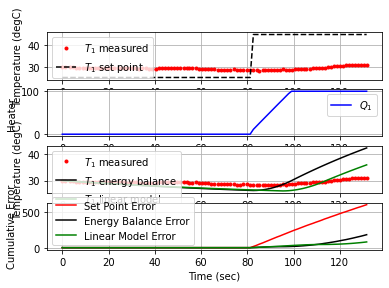

 134.2  45.00  31.24 100.00   2.99  96.92  -0.01


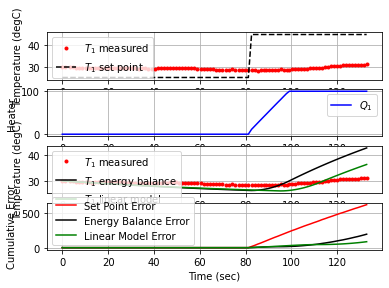

 135.5  45.00  31.45 100.00   2.95  96.92  -0.01


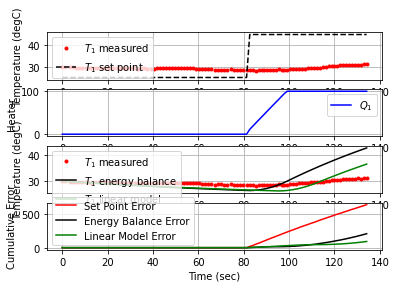

 137.0  45.00  31.63 100.00   2.91  96.92  -0.01


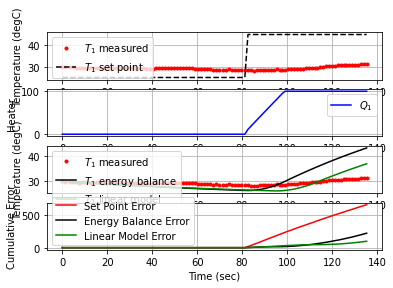

 138.3  45.00  31.68 100.00   2.90  96.92  -0.00


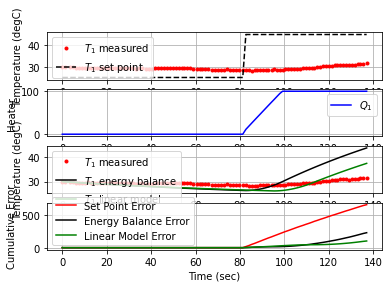

 139.6  45.00  31.81 100.00   2.87  96.92  -0.01


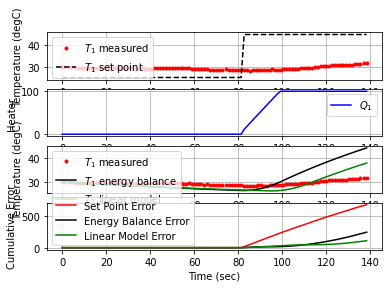

 140.9  45.00  31.96 100.00   2.84  96.92  -0.01


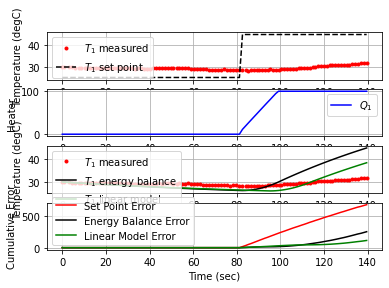

 142.3  45.00  32.08 100.00   2.81  96.92  -0.00


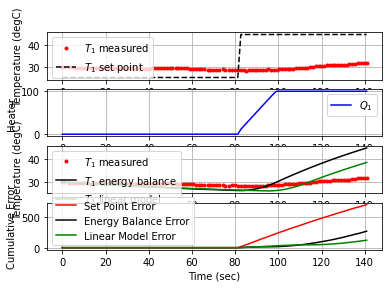

 143.7  45.00  32.28 100.00   2.77  96.92  -0.01


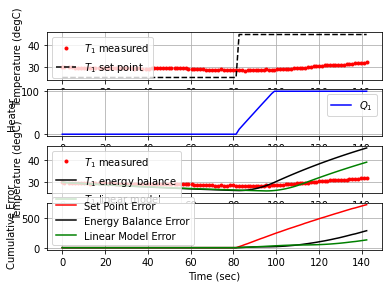

 145.0  45.00  32.34 100.00   2.75  96.92  -0.00


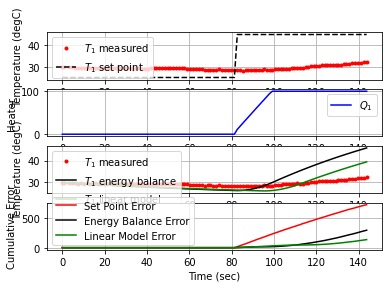

 146.3  45.00  32.64 100.00   2.69  96.92  -0.01


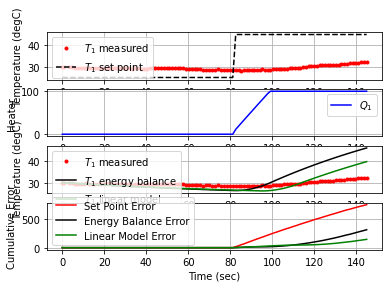

 147.6  45.00  32.75 100.00   2.66  96.92  -0.00


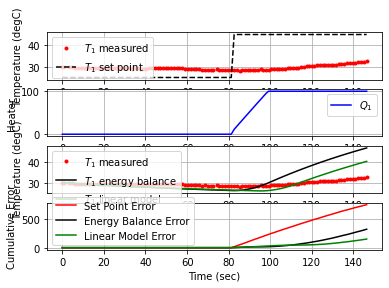

 148.9  45.00  32.86 100.00   2.64  96.92  -0.00


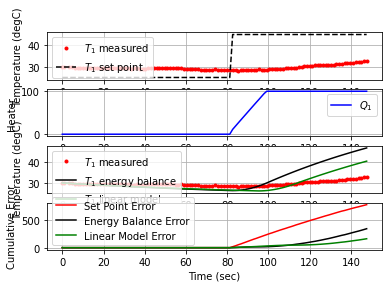

 150.4  45.00  33.10 100.00   2.59  96.92  -0.01


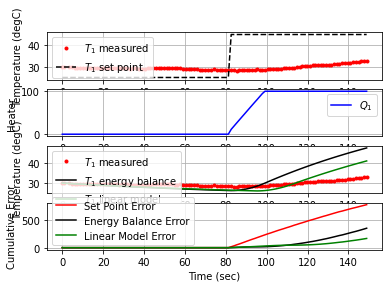

 151.7  45.00  33.33 100.00   2.54  96.92  -0.01


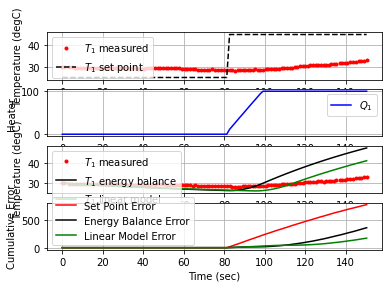

 153.0  45.00  33.57 100.00   2.48  96.92  -0.01


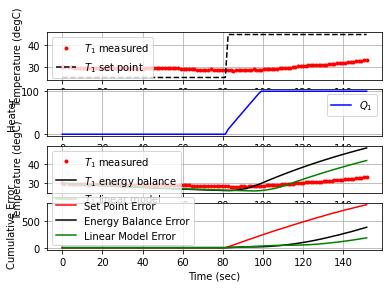

 154.3  45.00  33.45 100.00   2.51  96.92   0.01


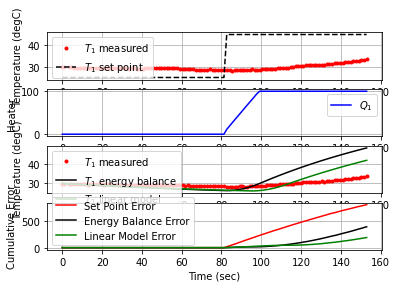

 155.6  45.00  33.87 100.00   2.42  96.92  -0.02


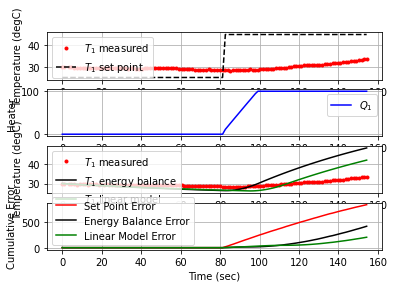

 157.0  45.00  34.15 100.00   2.36  96.92  -0.01


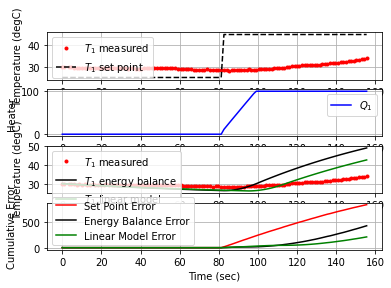

 158.5  45.00  34.20 100.00   2.35  96.92  -0.00


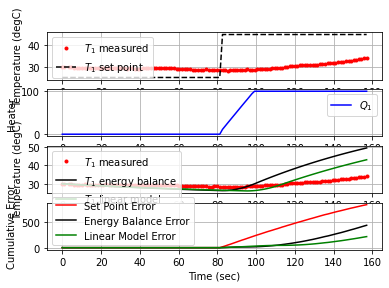

 159.8  45.00  34.25 100.00   2.34  96.92  -0.00


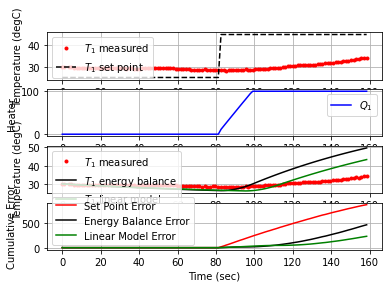

 161.1  45.00  34.21 100.00   2.35  96.92   0.00


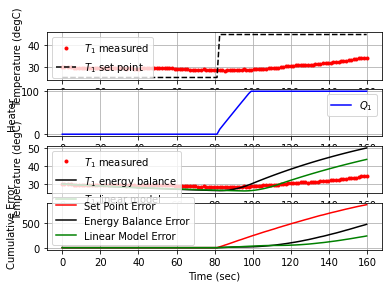

 162.5  45.00  34.26 100.00   2.33  96.92  -0.00


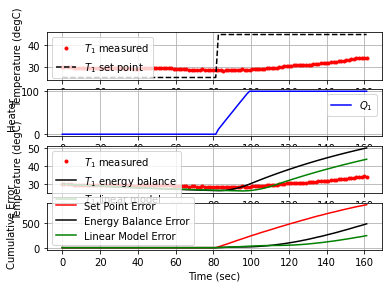

 164.0  45.00  34.15 100.00   2.36  96.92   0.00


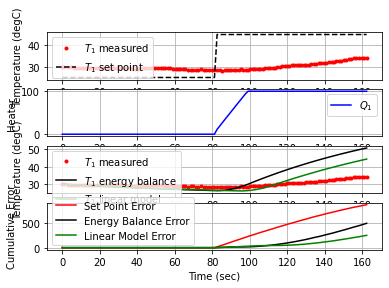

 165.3  45.00  34.06 100.00   2.38  96.92   0.00


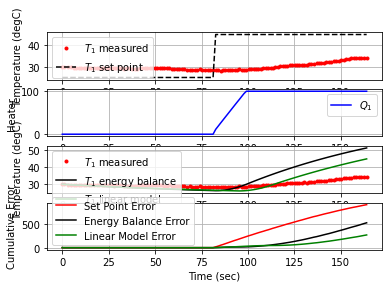

 166.6  45.00  33.95 100.00   2.40  96.92   0.00


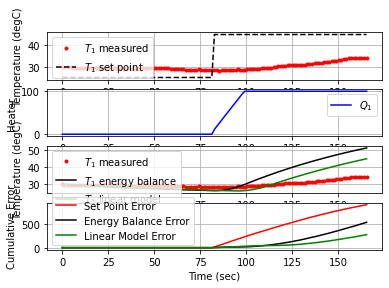

 167.9  45.00  33.94 100.00   2.41  96.92   0.00


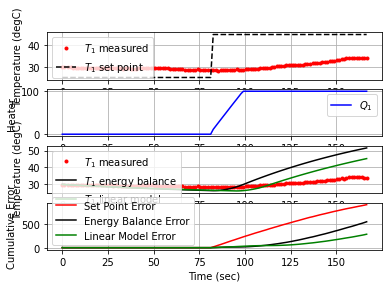

 169.2  45.00  33.90 100.00   2.41  96.92   0.00


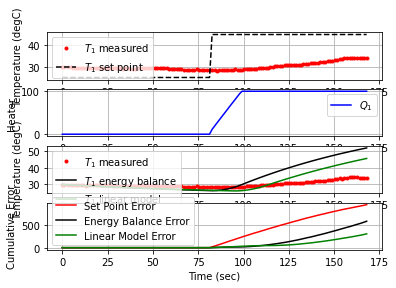

 170.5  45.00  33.81 100.00   2.43  96.92   0.00


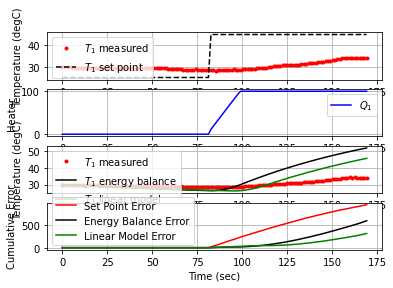

 172.0  45.00  33.63 100.00   2.47  96.92   0.01


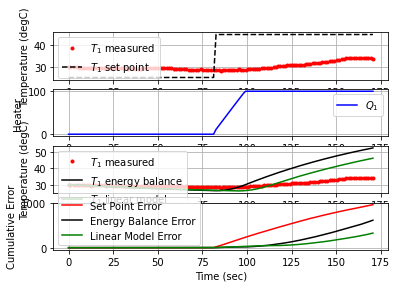

 173.3  45.00  33.60 100.00   2.48  96.92   0.00


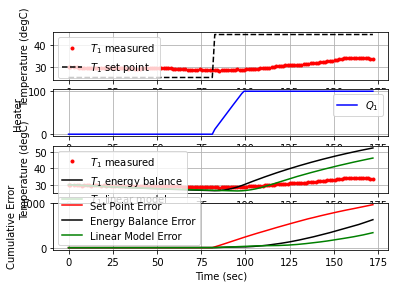

 174.6  45.00  33.85 100.00   2.42  96.92  -0.01


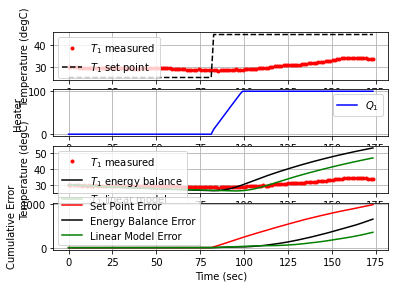

 175.9  45.00  33.76 100.00   2.44  96.92   0.00


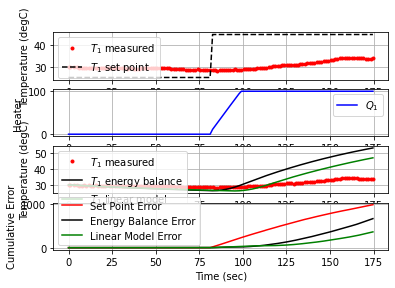

 177.3  45.00  33.89 100.00   2.42  96.92  -0.01


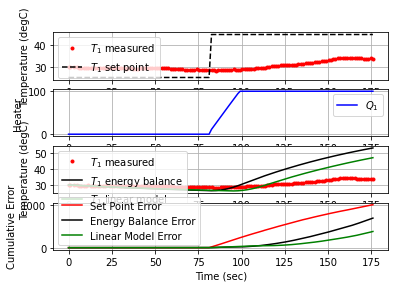

 178.8  45.00  33.87 100.00   2.42  96.92   0.00


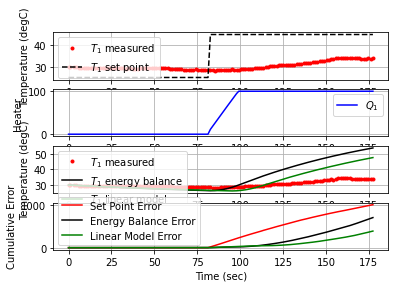

 180.1  45.00  34.12 100.00   2.36  96.92  -0.01


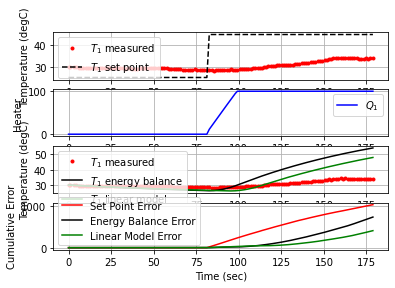

 181.4  45.00  34.16 100.00   2.36  96.92  -0.00


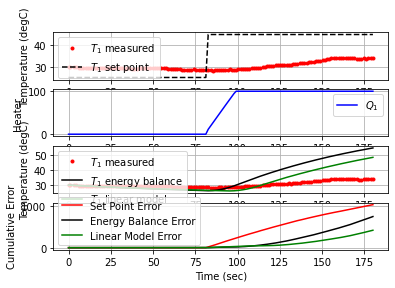

 182.7  45.00  34.78 100.00   2.21  96.92  -0.03


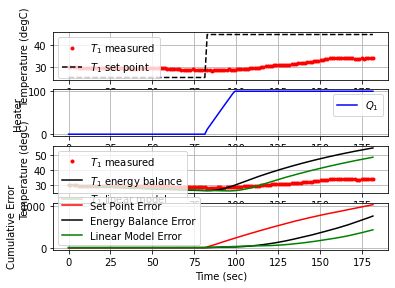

 184.0  45.00  34.88 100.00   2.20  96.92  -0.00


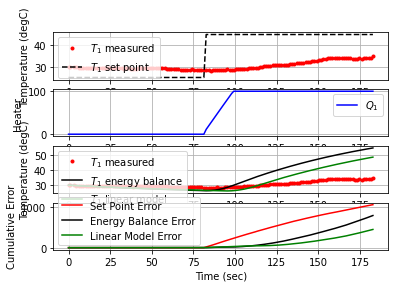

 185.5  45.00  35.15 100.00   2.14  96.92  -0.01


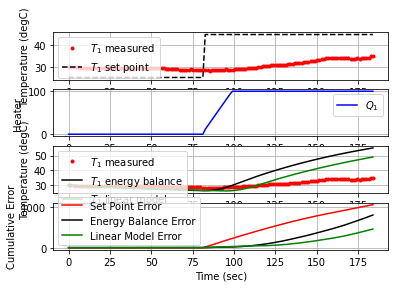

 186.9  45.00  35.52 100.00   2.05  96.92  -0.02


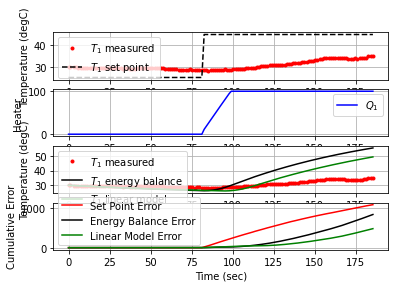

 188.2  45.00  35.68 100.00   2.02  96.92  -0.01


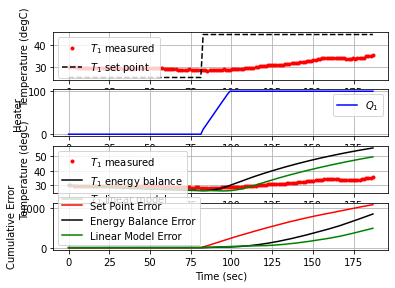

 189.5  45.00  35.95 100.00   1.96  96.92  -0.01


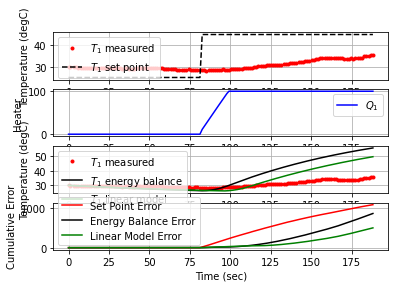

 190.8  45.00  36.14 100.00   1.92  96.92  -0.01


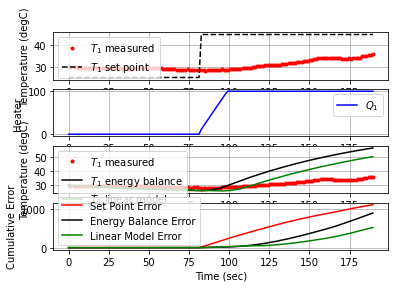

 192.3  45.00  36.44 100.00   1.85  96.92  -0.01


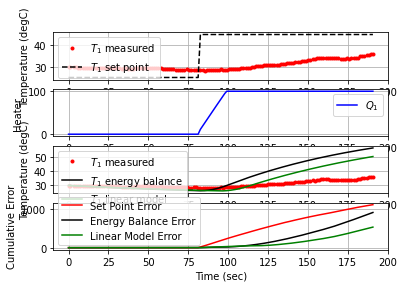

 193.6  45.00  36.63 100.00   1.81  96.92  -0.01


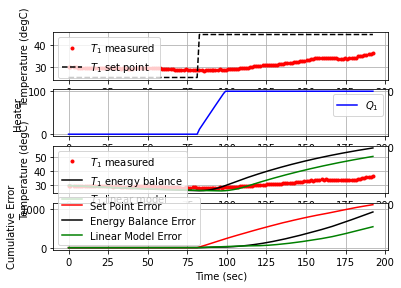

 194.9  45.00  36.84 100.00   1.77  96.92  -0.01


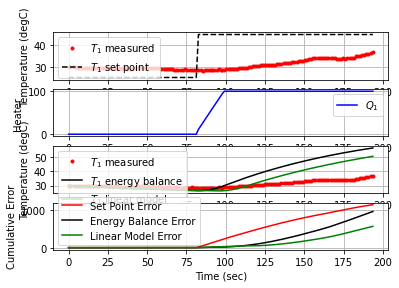

 196.3  45.00  37.01 100.00   1.73  96.92  -0.01


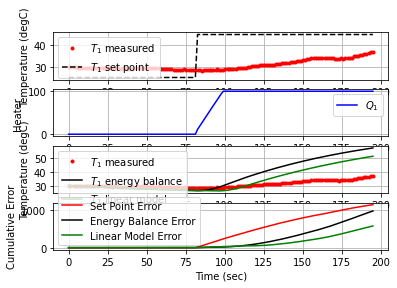

 197.8  45.00  37.13 100.00   1.71  96.92  -0.00


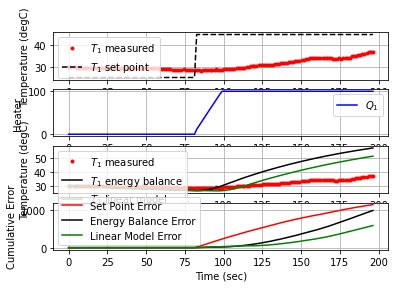

 199.2  45.00  37.12 100.00   1.71  96.92   0.00


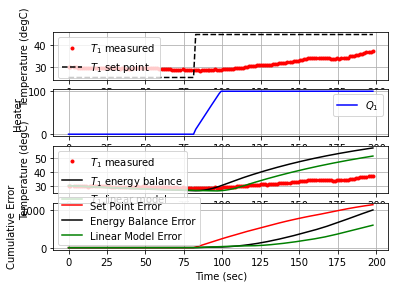

 200.5  45.00  37.30 100.00   1.67  96.92  -0.01


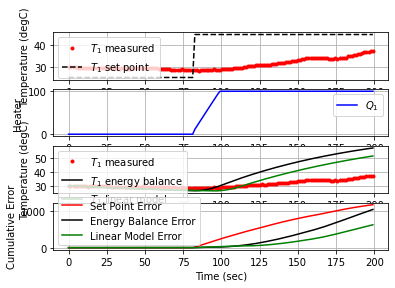

 201.8  45.00  37.38 100.00   1.65  96.92  -0.00


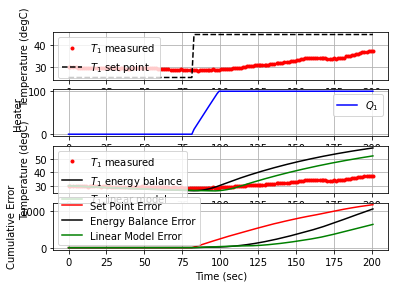

 203.2  45.00  37.22 100.00   1.69  96.92   0.01


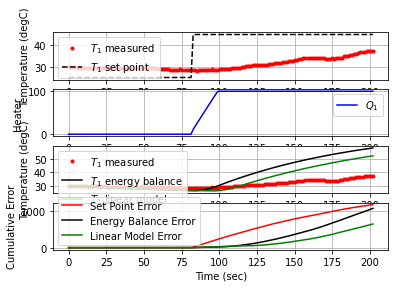

 204.7  45.00  37.15 100.00   1.70  96.92   0.00


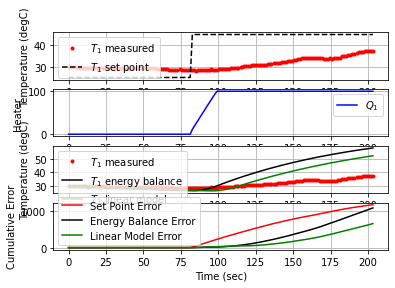

 206.0  45.00  37.14 100.00   1.71  96.92   0.00


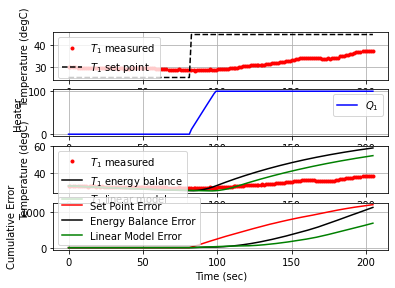

 207.4  45.00  37.09 100.00   1.72  96.92   0.00


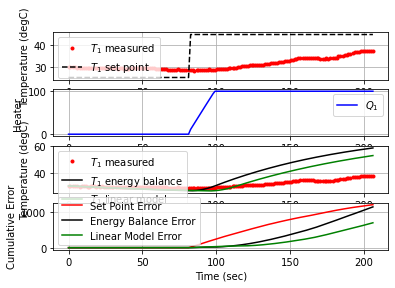

 208.6  45.00  37.10 100.00   1.71  96.92  -0.00


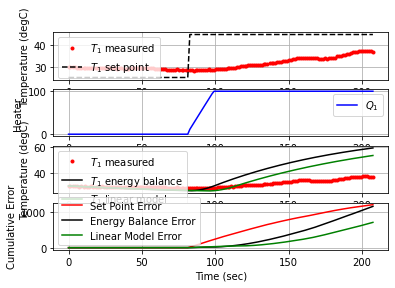

 209.9  45.00  36.99 100.00   1.74  96.92   0.01


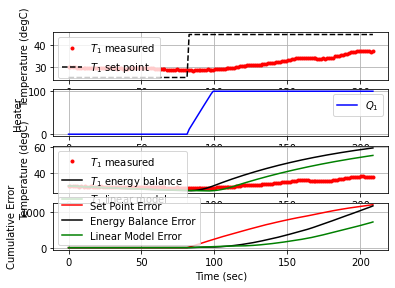

 211.2  45.00  37.10 100.00   1.71  96.92  -0.00


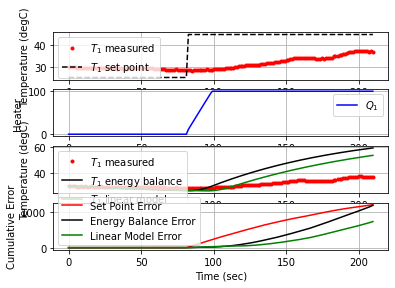

 212.5  45.00  37.42 100.00   1.64  96.92  -0.01


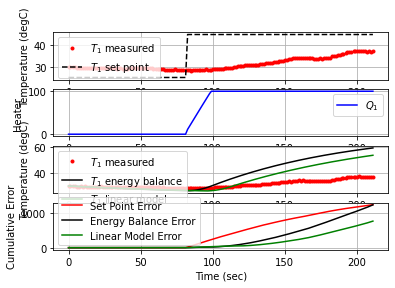

 213.7  45.00  37.71 100.00   1.57  96.92  -0.01


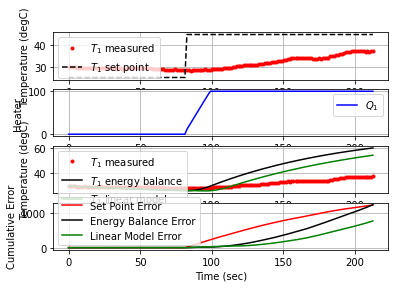

 215.0  45.00  37.86 100.00   1.54  96.92  -0.01


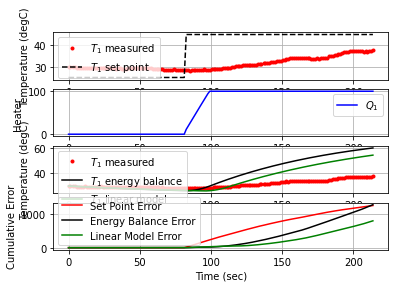

 216.2  45.00  37.85 100.00   1.55  96.92   0.00


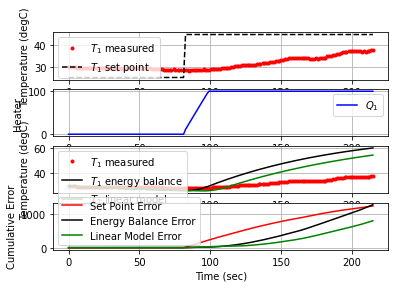

 217.5  45.00  38.07 100.00   1.50  96.92  -0.01


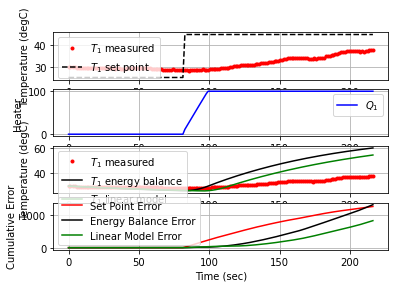

 218.9  45.00  38.17 100.00   1.48  96.92  -0.00


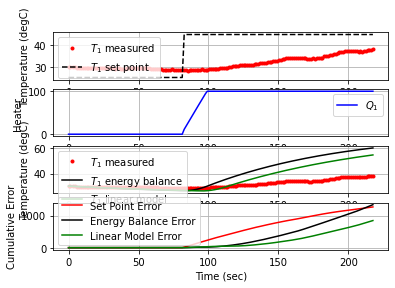

 220.1  45.00  38.18 100.00   1.48  96.92  -0.00


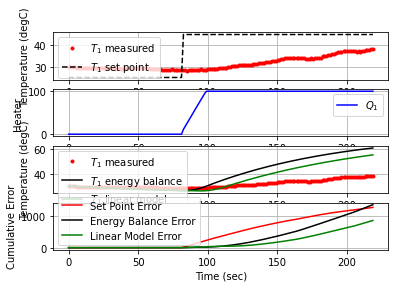

 221.4  45.00  38.61 100.00   1.37  96.92  -0.02


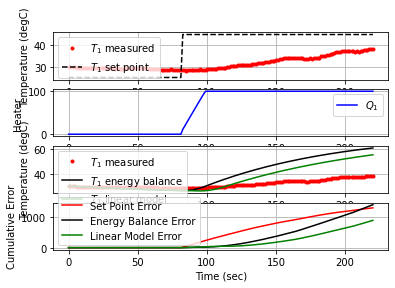

 222.6  45.00  38.71 100.00   1.36  96.92  -0.00


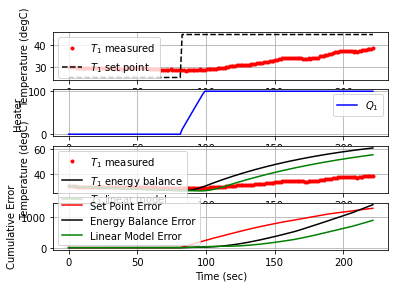

 223.8  45.00  38.80 100.00   1.34  96.92  -0.00


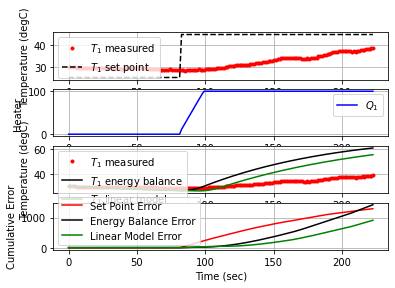

 225.0  45.00  38.74 100.00   1.35  96.92   0.00


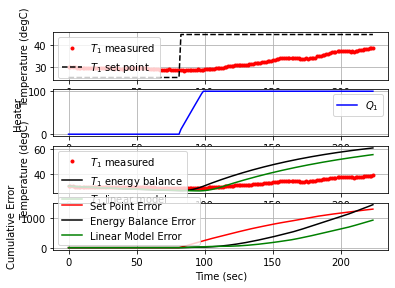

 226.4  45.00  38.93 100.00   1.31  96.92  -0.01


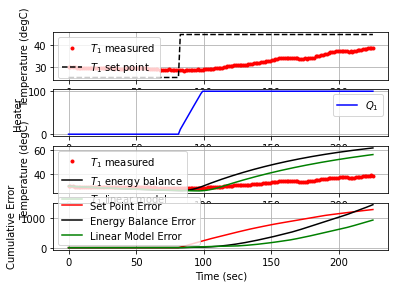

 227.6  45.00  39.15 100.00   1.26  96.92  -0.01


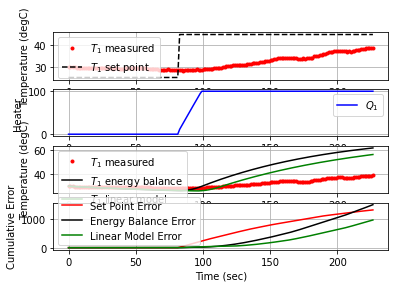

 228.9  45.00  39.24 100.00   1.24  96.92  -0.00


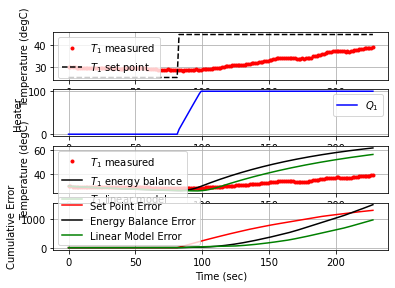

 230.1  45.00  39.39 100.00   1.21  96.92  -0.01


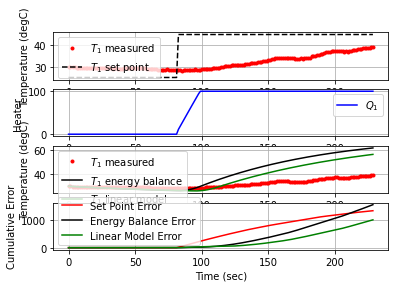

 231.4  45.00  39.61 100.00   1.16  96.92  -0.01


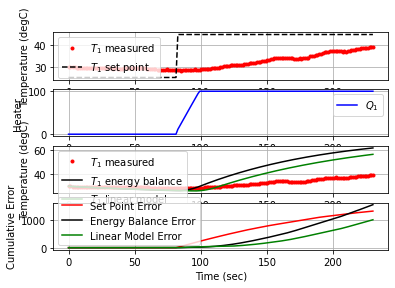

 232.8  45.00  40.02 100.00   1.06  96.92  -0.02


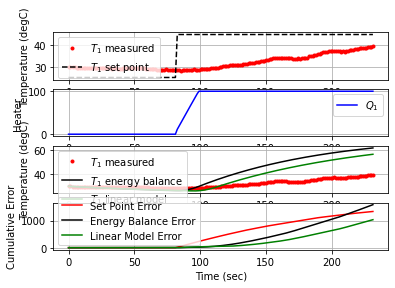

 234.0  45.00  39.76 100.00   1.13  96.92   0.01


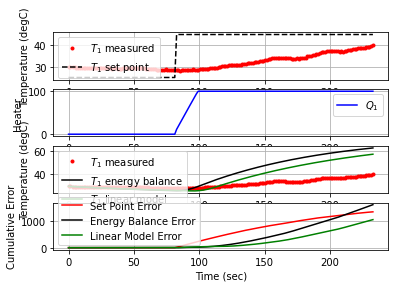

 235.2  45.00  39.93 100.00   1.09  96.92  -0.01


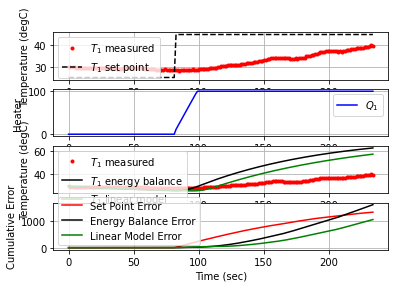

 236.4  45.00  40.03  99.95   1.07  98.89  -0.00


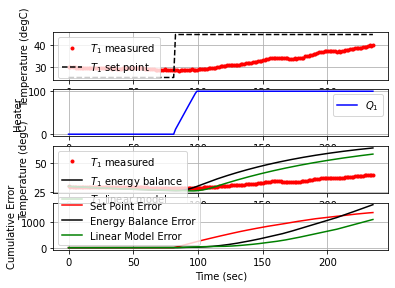

 237.7  45.00  40.07 100.00   1.06  98.89  -0.00


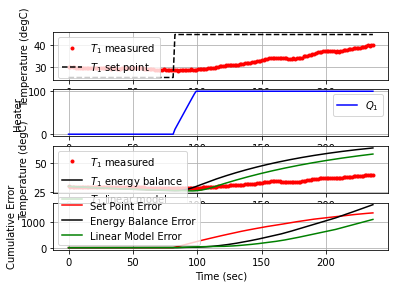

 238.9  45.00  40.37 100.00   0.99  98.89  -0.01


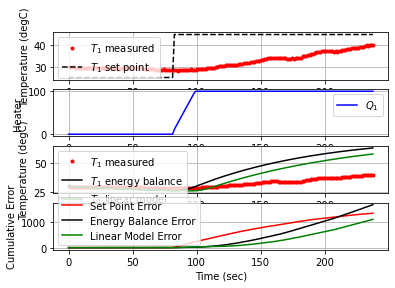

 240.3  45.00  40.37 100.00   0.99  98.89  -0.00


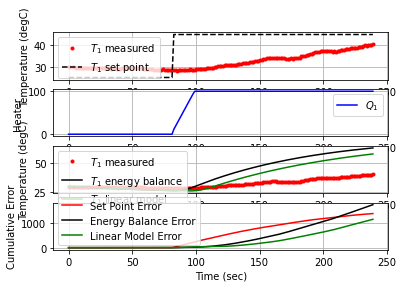

 241.6  45.00  40.23 100.00   1.03  98.89   0.01


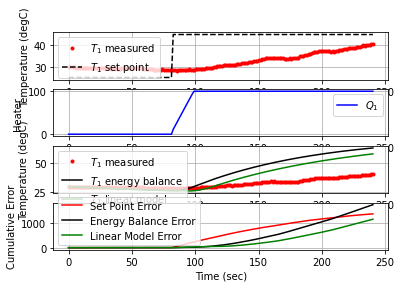

 242.9  45.00  39.98 100.00   1.09  98.89   0.01


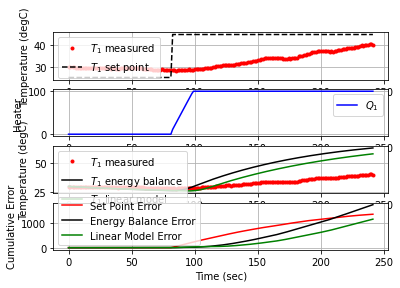

 244.1  45.00  39.77 100.00   1.13  98.89   0.01


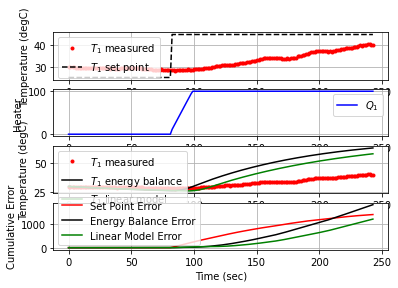

 245.4  45.00  39.81 100.00   1.12  98.89  -0.00


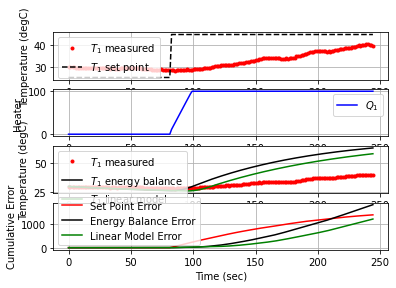

 246.9  45.00  39.70 100.00   1.14  98.89   0.00


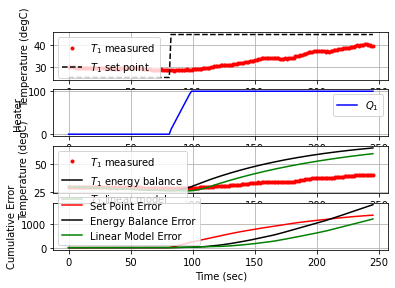

 248.2  45.00  39.50 100.00   1.19  98.89   0.01


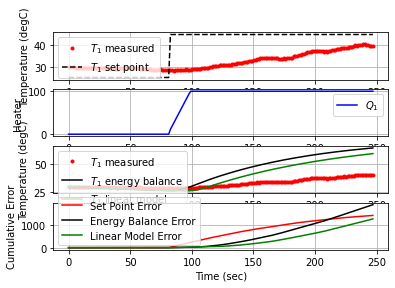

 249.8  45.00  39.28 100.00   1.24  98.89   0.01


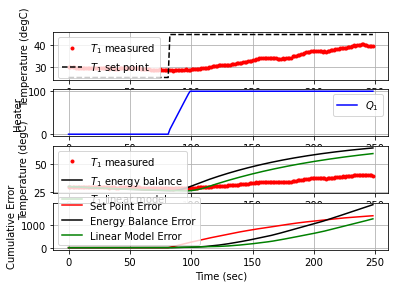

 251.6  45.00  39.12 100.00   1.27  98.89   0.01


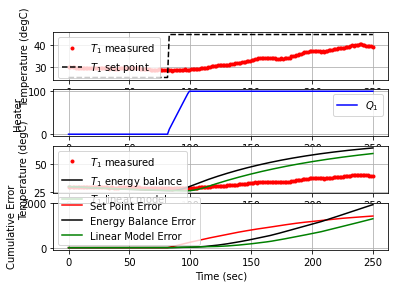

 253.5  45.00  39.44 100.00   1.19  98.89  -0.01


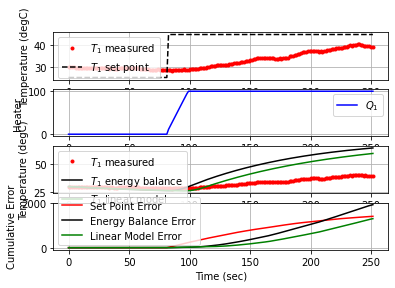

 255.0  45.00  39.82 100.00   1.10  98.89  -0.01


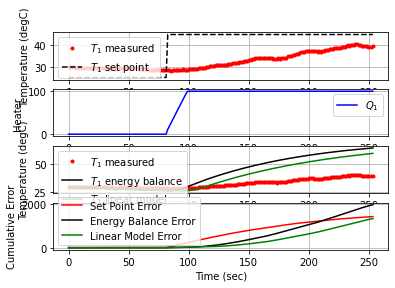

 256.7  45.00  39.84 100.00   1.11  98.89  -0.00


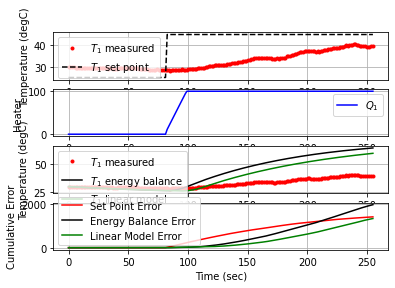

 258.0  45.00  39.76 100.00   1.13  98.89   0.00


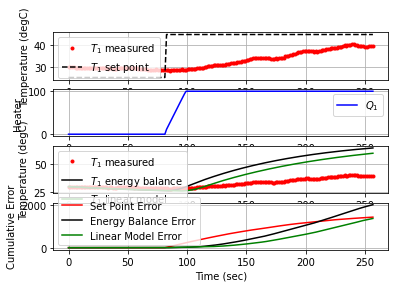

 259.3  45.00  39.85 100.00   1.11  98.89  -0.00


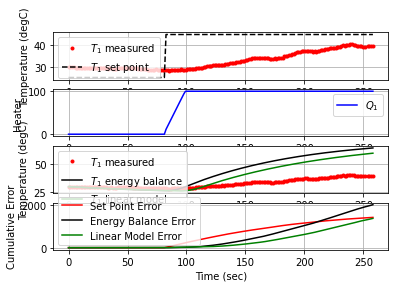

 260.7  45.00  40.34 100.00   0.98  98.89  -0.02


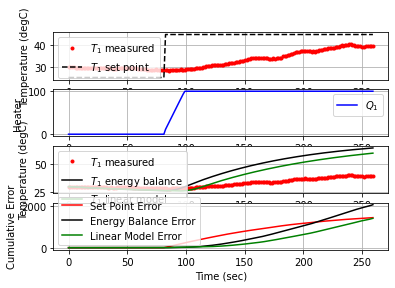

 262.0  45.00  40.36 100.00   1.00  98.89  -0.00


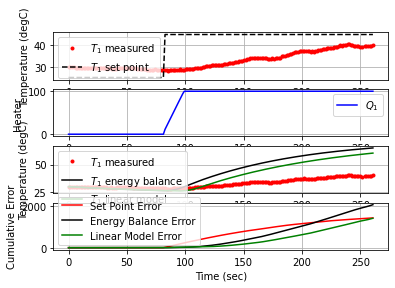

 263.6  45.00  40.15 100.00   1.05  98.89   0.01


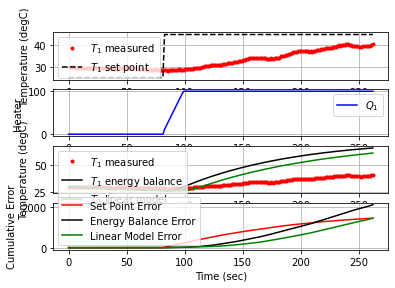

 265.1  45.00  40.53 100.00   0.95  98.89  -0.01


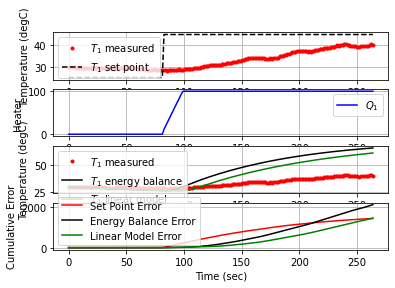

 266.5  45.00  40.86 100.00   0.88  98.89  -0.01


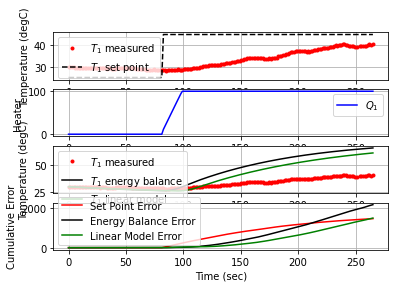

 267.8  45.00  40.95 100.00   0.86  98.89  -0.00


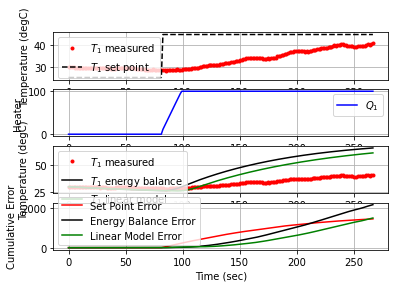

 269.1  45.00  41.26 100.00   0.79  98.89  -0.01


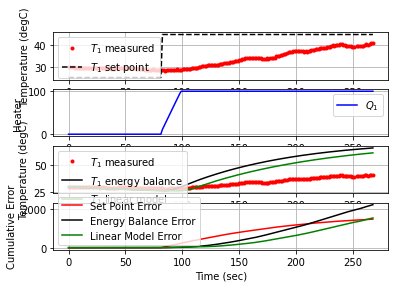

 270.4  45.00  41.30 100.00   0.79  98.89  -0.00


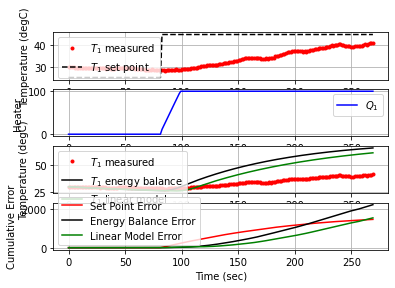

 271.8  45.00  41.56 100.00   0.73  98.89  -0.01


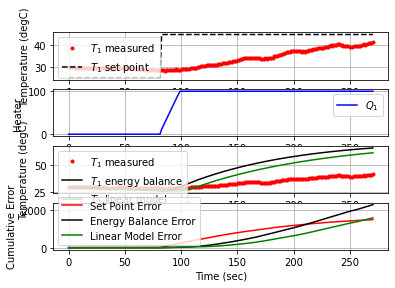

 273.2  45.00  41.62 100.00   0.72  98.89  -0.00


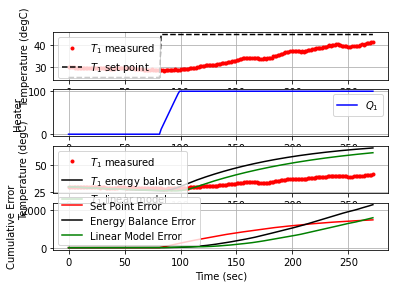

 274.6  45.00  41.66 100.00   0.71  98.89  -0.00


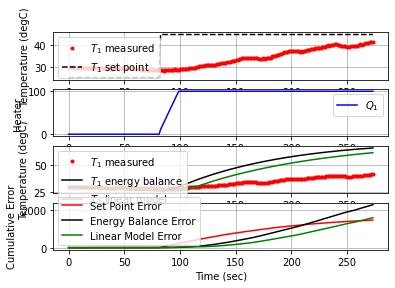

 276.0  45.00  41.80 100.00   0.68  98.89  -0.01


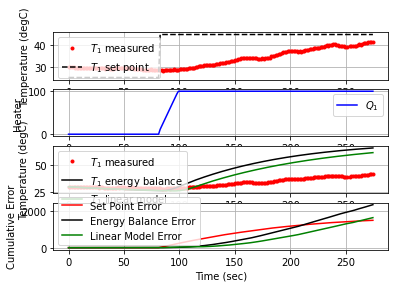

 277.5  45.00  42.06 100.00   0.62  98.89  -0.01


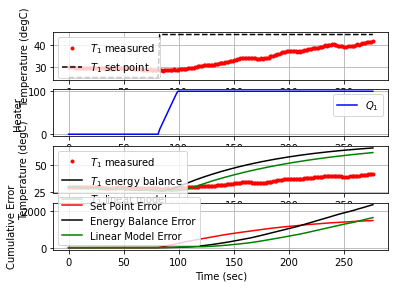

 279.0  45.00  42.41 100.00   0.54  98.89  -0.01


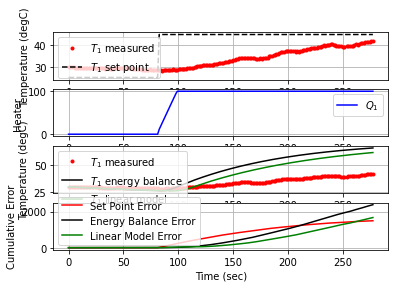

 280.3  45.00  42.31 100.00   0.57  98.89   0.00


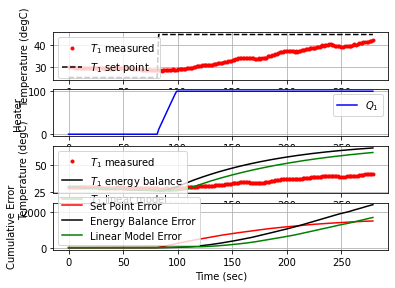

 281.7  45.00  42.35 100.00   0.56  98.89  -0.00


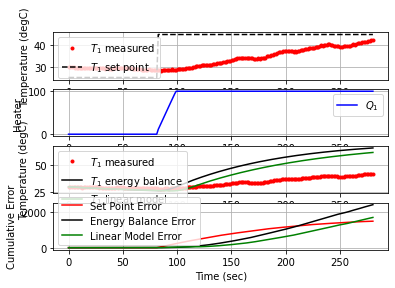

 283.1  45.00  42.22 100.00   0.59  98.89   0.01


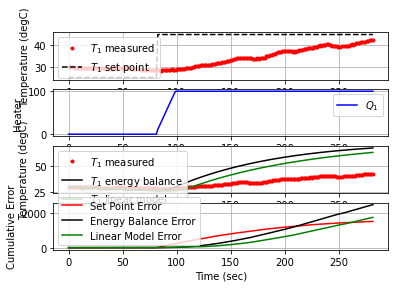

 284.4  45.00  41.83 100.00   0.68  98.89   0.02


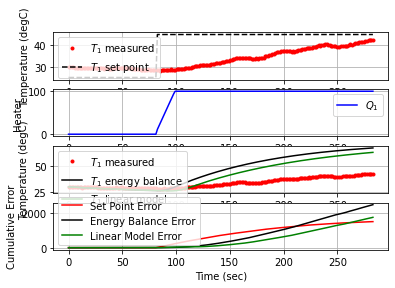

 285.7  45.00  41.95 100.00   0.64  98.89  -0.01


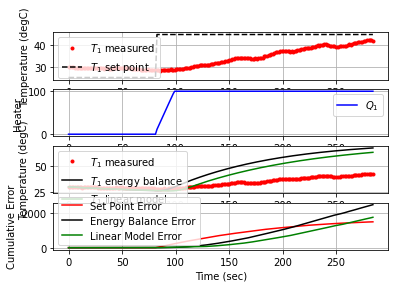

 287.2  45.00  41.98 100.00   0.64  98.89  -0.00


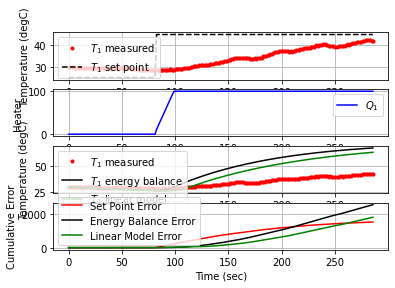

 288.5  45.00  41.86 100.00   0.67  98.89   0.01


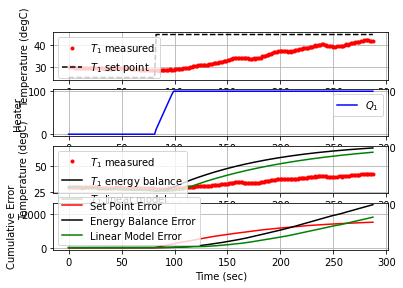

 289.8  45.00  41.86 100.00   0.67  98.89  -0.00


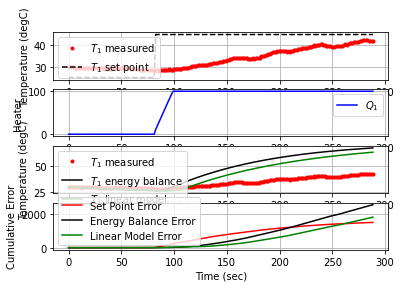

 291.1  45.00  41.77 100.00   0.69  98.89   0.00


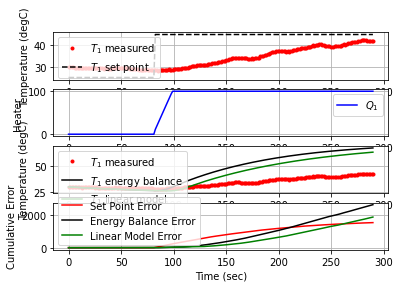

 292.6  45.00  41.76 100.00   0.69  98.89   0.00


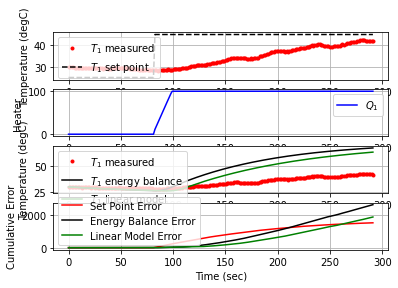

 294.0  45.00  41.54 100.00   0.74  98.89   0.01


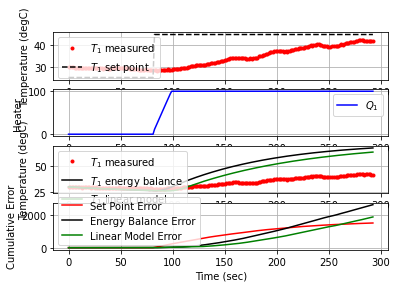

 295.4  45.00  41.61 100.00   0.72  98.89  -0.00


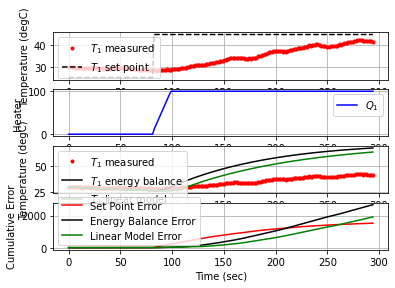

 296.8  45.00  41.71 100.00   0.70  98.89  -0.00


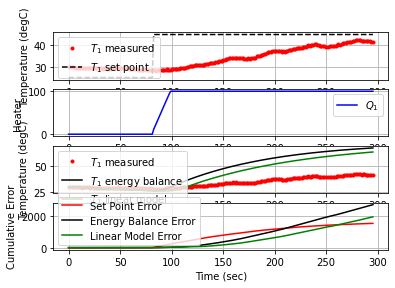

 298.2  45.00  41.77 100.00   0.69  98.89  -0.00


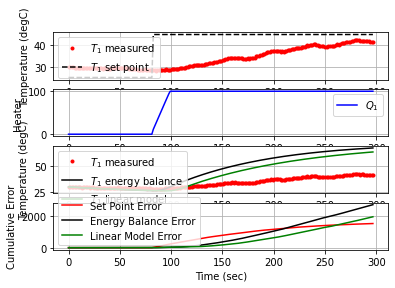

 299.6  45.00  41.88 100.00   0.66  98.89  -0.00


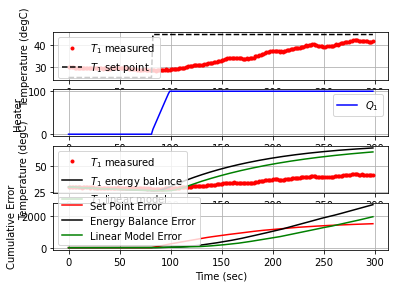

 301.1  45.00  42.00 100.00   0.63  98.89  -0.00


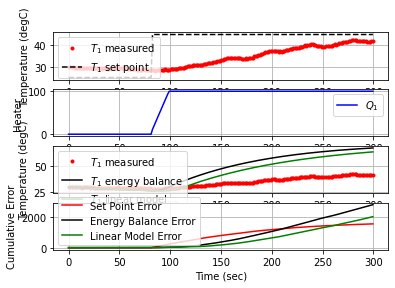

 302.7  45.00  42.15 100.00   0.60  98.89  -0.01


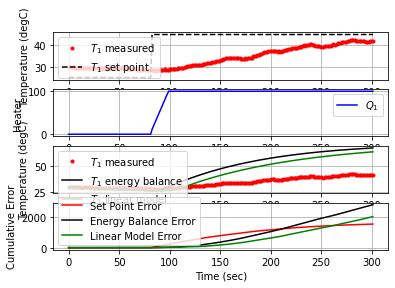

 304.2  45.00  42.46 100.00   0.53  98.89  -0.01


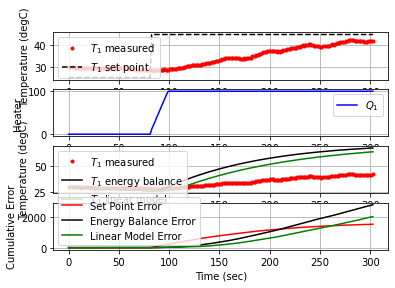

 305.5  45.00  42.31 100.00   0.57  98.89   0.01


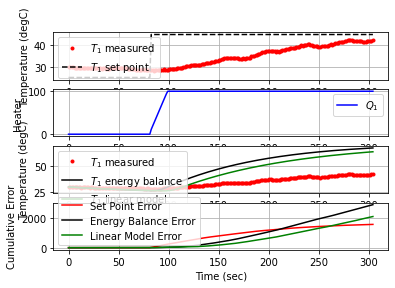

 307.0  45.00  42.71 100.00   0.47  98.89  -0.01


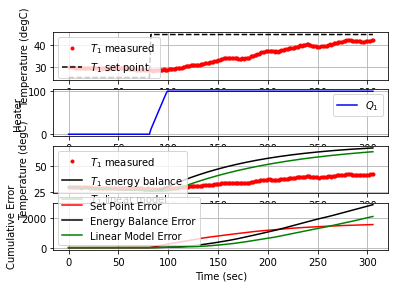

 308.4  45.00  42.72 100.00   0.48  98.89  -0.00


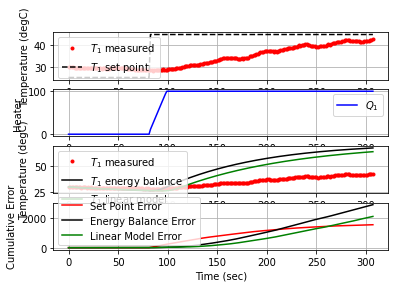

 310.0  45.00  42.76 100.00   0.47  98.89  -0.00


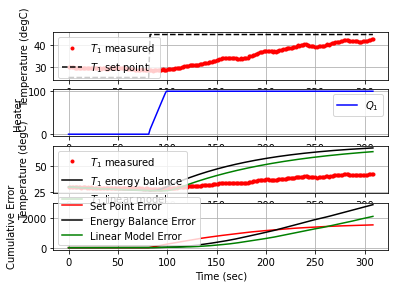

 311.4  45.00  42.70 100.00   0.49  98.89   0.00


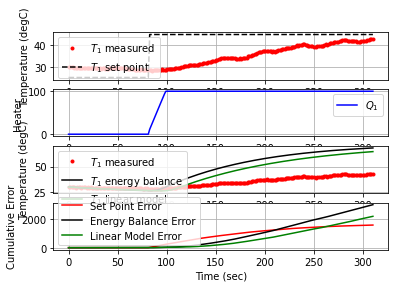

 312.7  45.00  42.84 100.00   0.45  98.89  -0.01


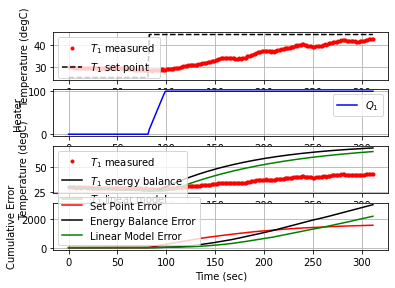

 314.1  45.00  43.29  99.91   0.35  99.58  -0.02


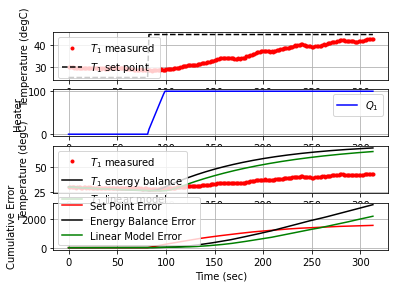

 315.4  45.00  43.58 100.00   0.29  99.58  -0.01


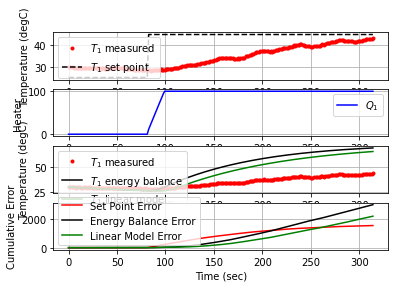

 316.8  45.00  43.49 100.00   0.32  99.58   0.00


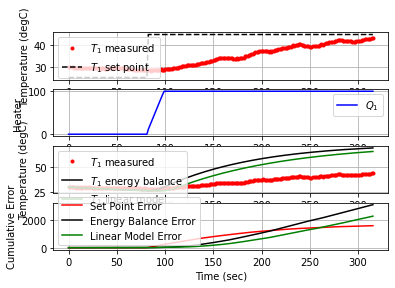

 318.2  45.00  43.61 100.00   0.29  99.58  -0.00


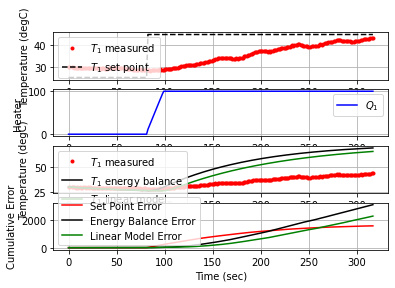

 319.6  45.00  43.13 100.00   0.40  99.58   0.02


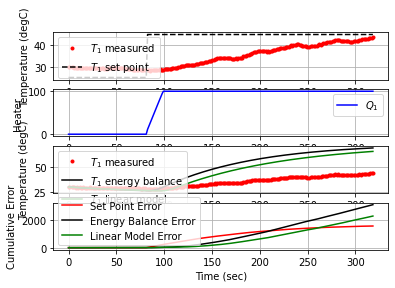

 321.0  45.00  42.98 100.00   0.43  99.58   0.01


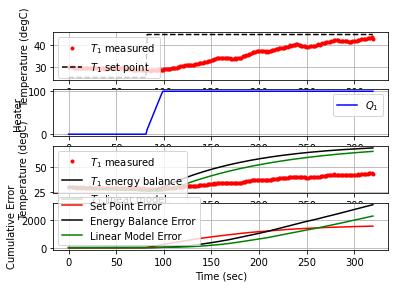

 322.5  45.00  42.86 100.00   0.45  99.58   0.00


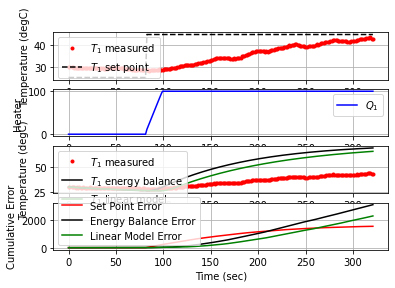

 323.8  45.00  42.64 100.00   0.50  99.58   0.01


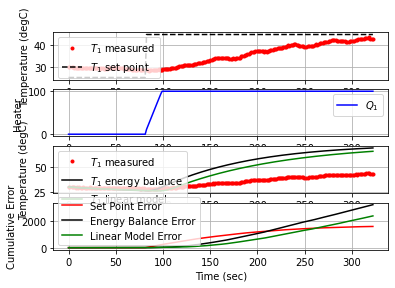

 325.4  45.00  42.34 100.00   0.57  99.58   0.01


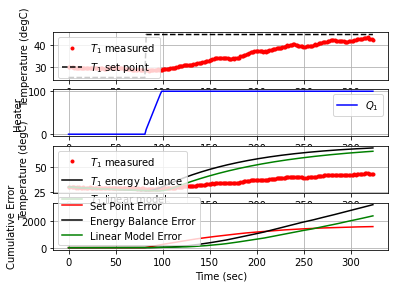

 326.8  45.00  42.12 100.00   0.62  99.58   0.01


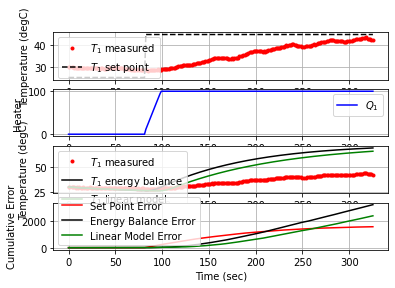

 328.2  45.00  41.98 100.00   0.65  99.58   0.01


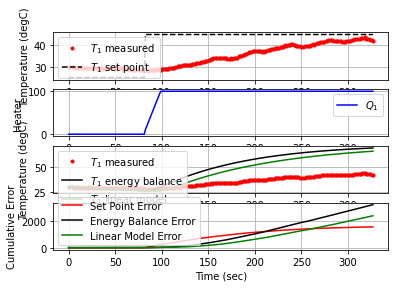

 329.5  45.00  41.89 100.00   0.66  99.58   0.00


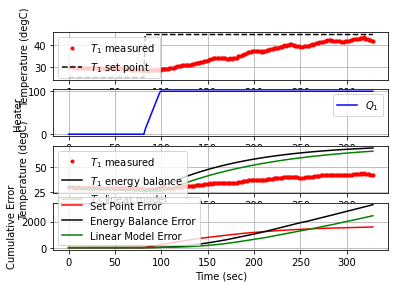

 330.9  45.00  41.92 100.00   0.65  99.58  -0.00


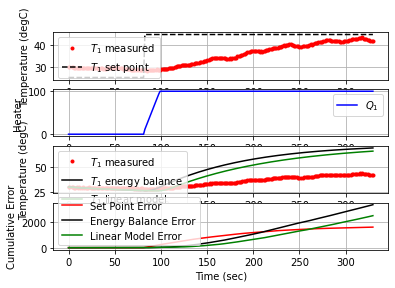

 332.4  45.00  42.30 100.00   0.56  99.58  -0.01


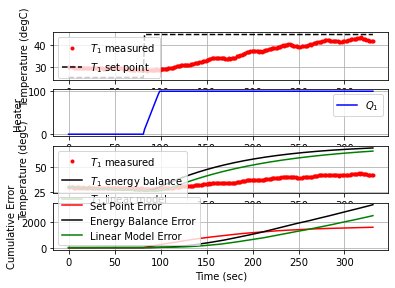

 333.9  45.00  42.46 100.00   0.53  99.58  -0.01


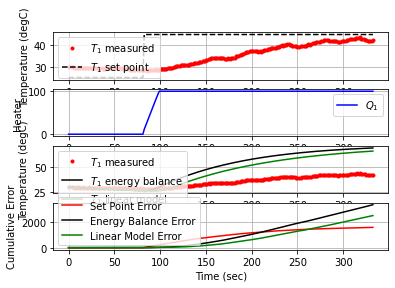

 335.4  45.00  42.86 100.00   0.44  99.58  -0.01


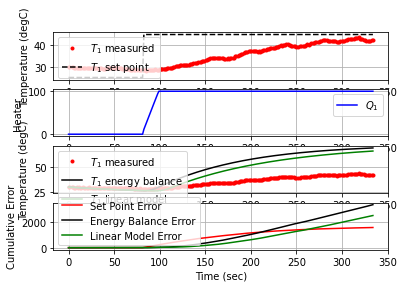

 336.8  45.00  43.36 100.00   0.33  99.58  -0.02


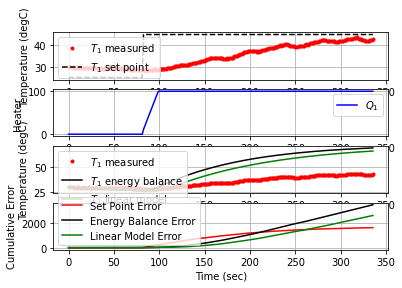

 338.2  45.00  43.55 100.00   0.30  99.58  -0.01


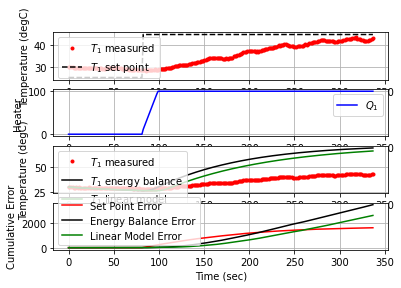

 339.7  45.00  43.65 100.00   0.28  99.58  -0.00


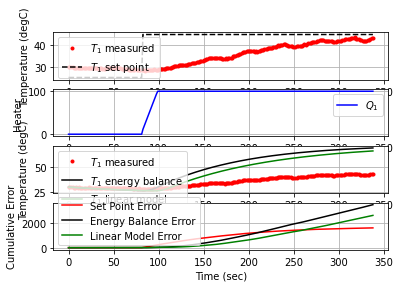

 341.2  45.00  43.72 100.00   0.27  99.58  -0.00


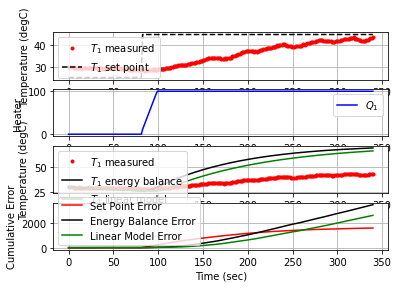

 342.6  45.00  43.89 100.00   0.23  99.58  -0.01


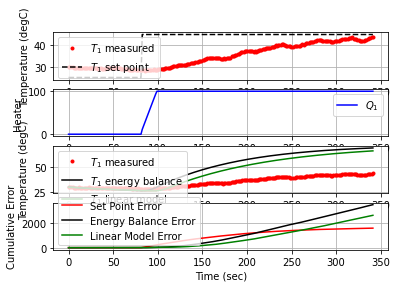

 344.0  45.00  44.16 100.00   0.17  99.58  -0.01


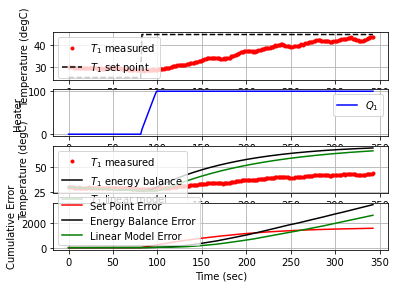

 345.5  45.00  44.27 100.00   0.15  99.58  -0.00


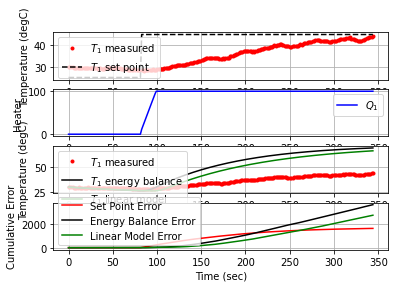

 347.0  45.00  44.45  99.95   0.11  99.84  -0.01


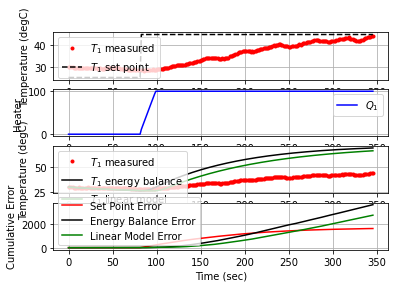

 348.6  45.00  45.23  99.67  -0.04  99.73  -0.02


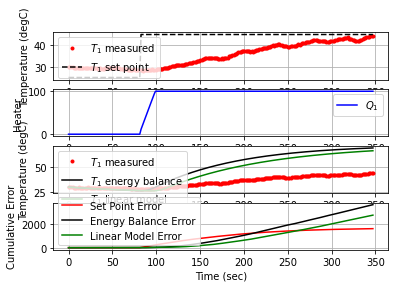

 350.0  45.00  45.03  99.72  -0.01  99.72   0.01


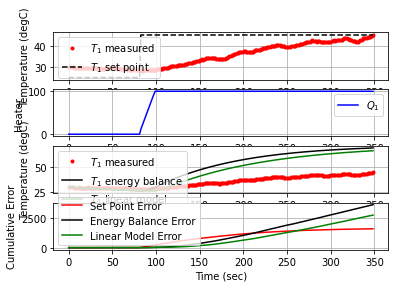

 351.4  45.00  44.97  99.74   0.01  99.73   0.00


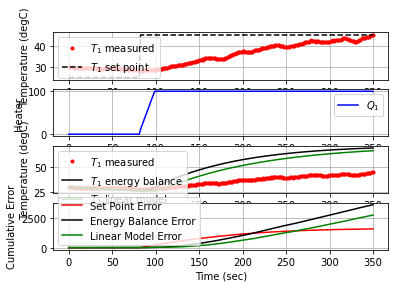

 352.7  45.00  45.27  99.56  -0.05  99.62  -0.01


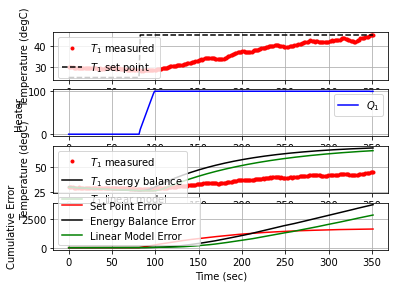

 354.1  45.00  45.48  99.32  -0.10  99.43  -0.01


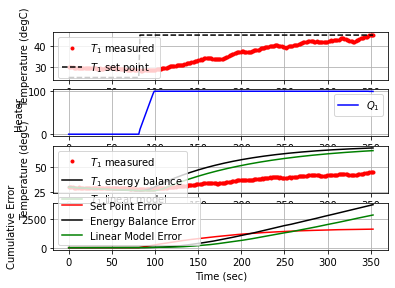

 355.6  45.00  45.68  98.98  -0.14  99.12  -0.01


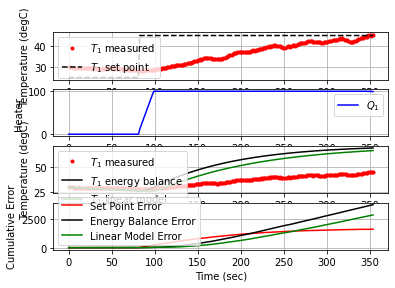

 356.9  45.00  45.68  98.70  -0.14  98.84  -0.00


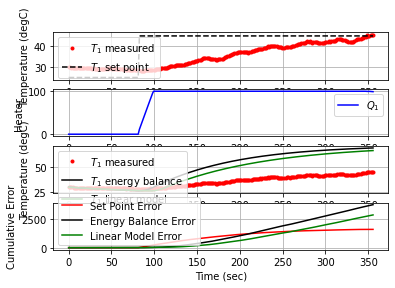

 358.3  45.00  45.79  98.36  -0.16  98.53  -0.00


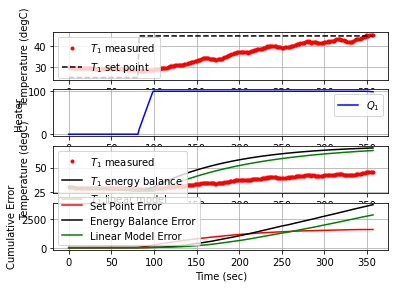

 359.7  45.00  45.95  97.92  -0.19  98.12  -0.01


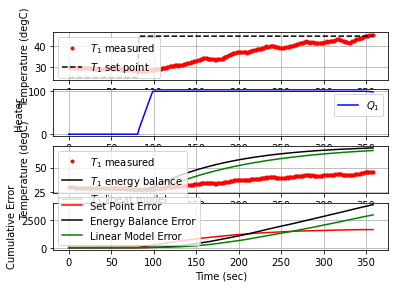

 361.1  45.00  45.89  97.55  -0.18  97.73   0.00


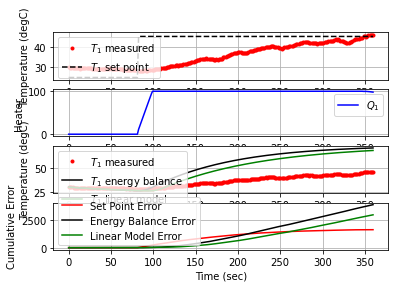

 362.8  45.00  45.83  97.16  -0.17  97.33   0.00


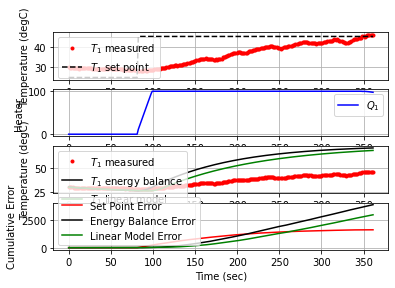

 364.3  45.00  45.74  96.83  -0.15  96.98   0.00


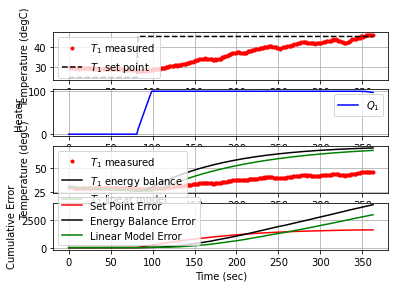

 365.7  45.00  45.91  96.42  -0.18  96.61  -0.01


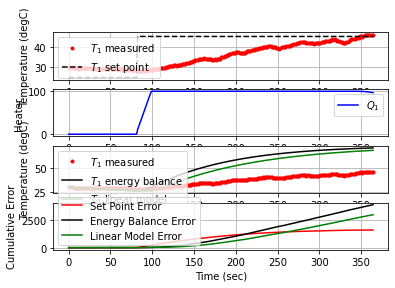

 367.2  45.00  46.03  95.91  -0.21  96.12  -0.00


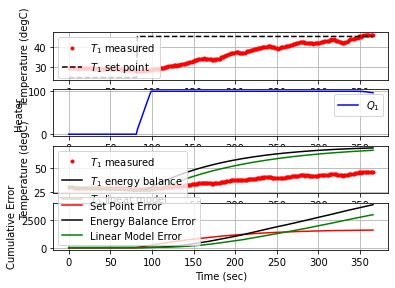

 368.7  45.00  46.03  95.47  -0.21  95.67  -0.00


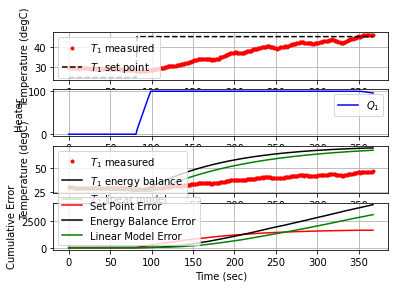

 370.2  45.00  46.00  95.01  -0.20  95.21   0.00


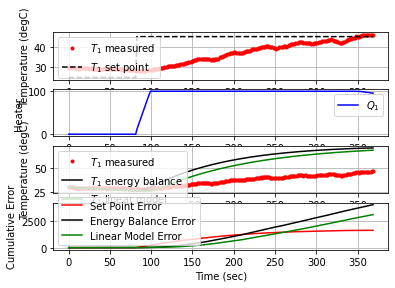

 371.6  45.00  45.80  94.71  -0.16  94.87   0.01


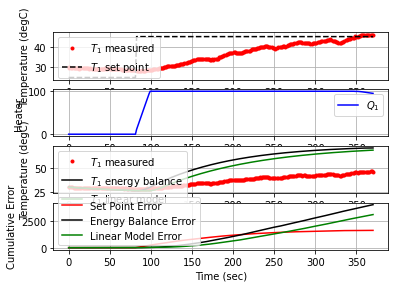

 373.0  45.00  45.94  94.30  -0.19  94.49  -0.01


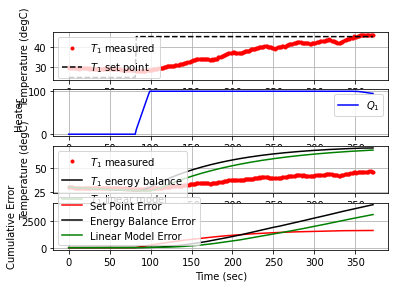

 374.3  45.00  46.28  93.72  -0.25  93.98  -0.01


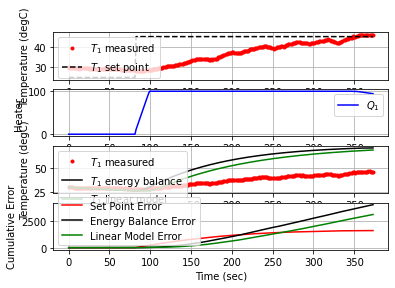

 375.6  45.00  46.12  93.31  -0.23  93.53   0.01


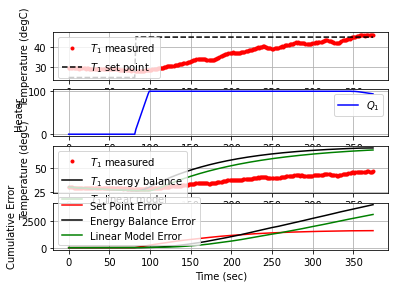

 377.2  45.00  45.83  92.97  -0.17  93.13   0.01


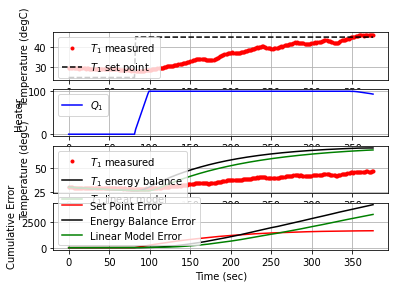

 378.6  45.00  45.60  92.75  -0.12  92.86   0.01


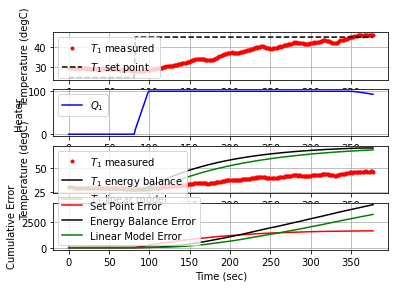

 380.1  45.00  45.28  92.69  -0.06  92.74   0.01


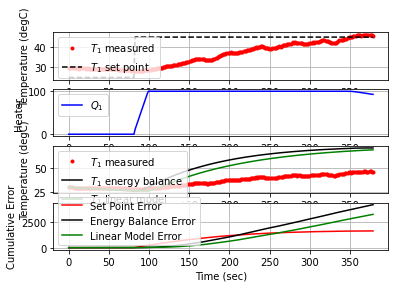

 381.4  45.00  45.44  92.46  -0.09  92.56  -0.01


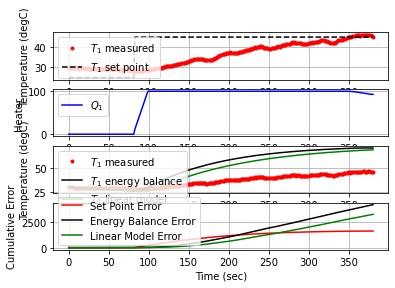

 382.9  45.00  45.63  92.16  -0.13  92.29  -0.01


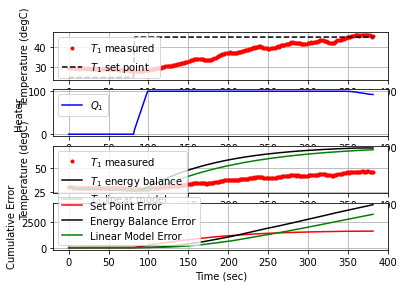

 384.5  45.00  46.08  91.55  -0.21  91.78  -0.01


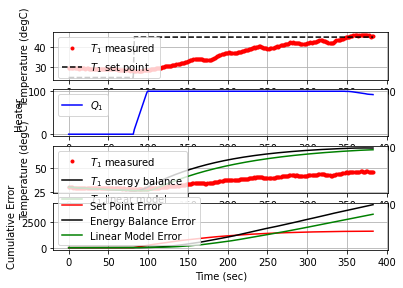

 385.9  45.00  46.10  91.07  -0.22  91.29  -0.00


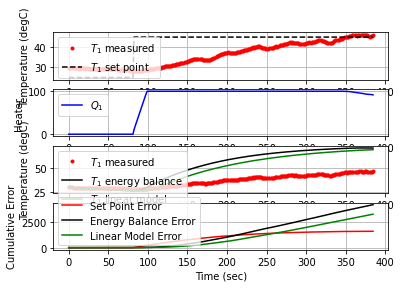

 387.5  45.00  46.00  90.63  -0.20  90.83   0.00


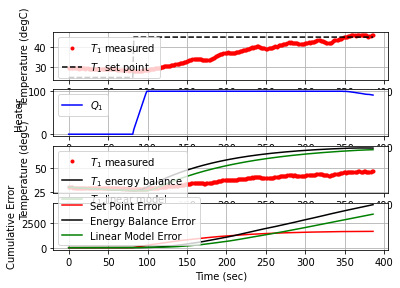

 388.9  45.00  46.15  90.11  -0.23  90.34  -0.01


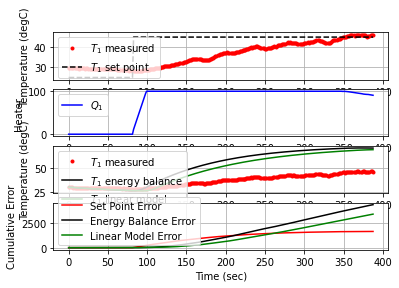

 390.4  45.00  46.40  89.44  -0.27  89.72  -0.01


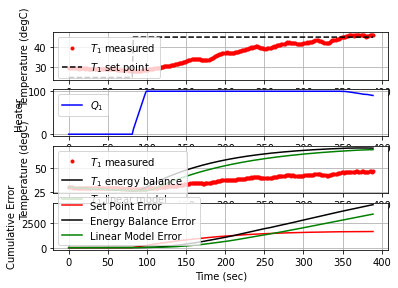

 391.9  45.00  46.63  88.68  -0.32  89.01  -0.01


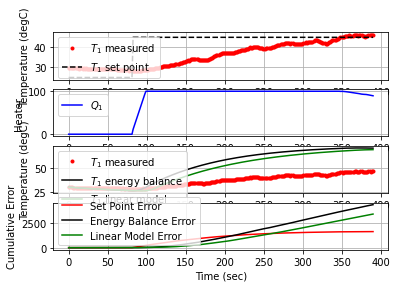

 393.3  45.00  46.73  87.93  -0.34  88.28  -0.00


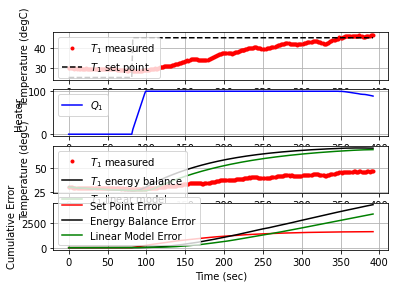

 394.7  45.00  46.78  87.18  -0.35  87.53  -0.00


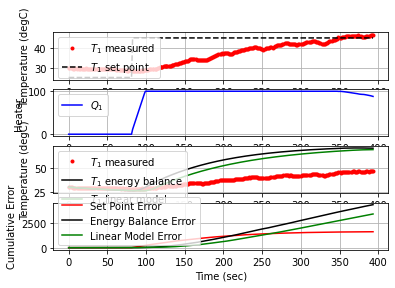

 396.1  45.00  46.90  86.39  -0.37  86.77  -0.00


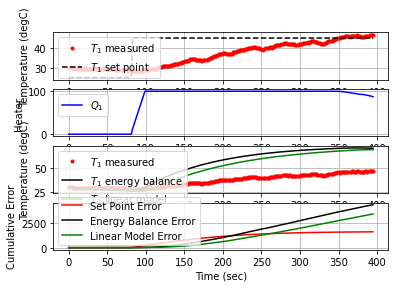

 397.8  45.00  47.17  85.28  -0.42  85.71  -0.01


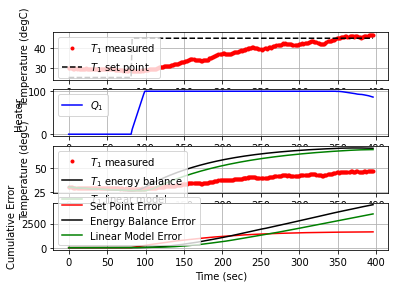

 399.2  45.00  47.33  84.24  -0.45  84.70  -0.01


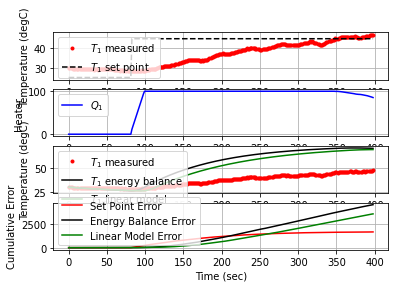

 400.7  45.00  47.54  83.12  -0.49  83.62  -0.01


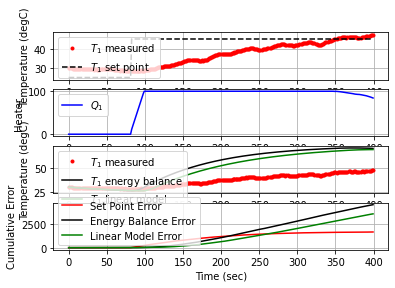

 402.2  45.00  47.63  81.99  -0.51  82.50  -0.00


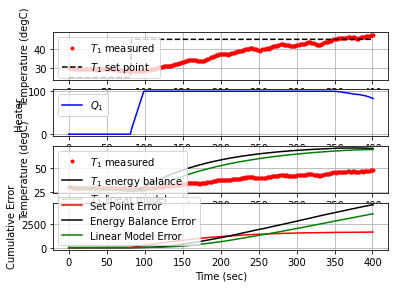

 403.6  45.00  47.38  81.00  -0.48  81.47   0.01


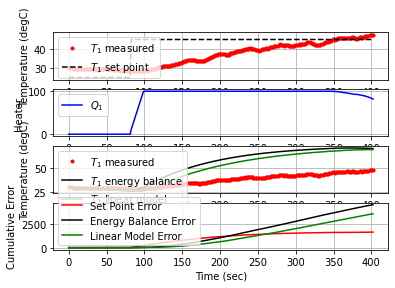

 405.2  45.00  47.46  79.85  -0.48  80.34  -0.00


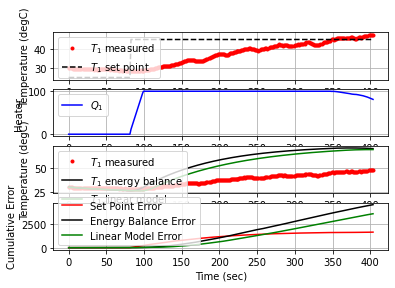

 406.6  45.00  47.43  78.88  -0.48  79.35   0.00


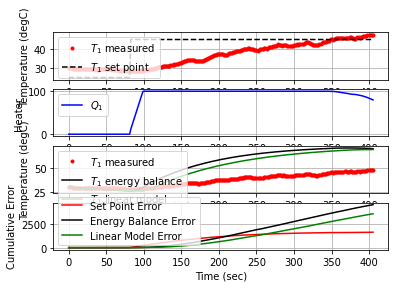

 407.9  45.00  47.44  77.89  -0.48  78.37  -0.00


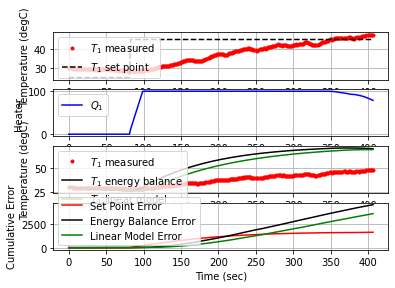

 409.3  45.00  47.52  76.87  -0.49  77.37  -0.00


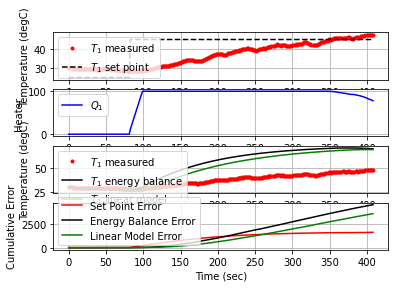

 410.8  45.00  47.61  75.73  -0.51  76.24  -0.00


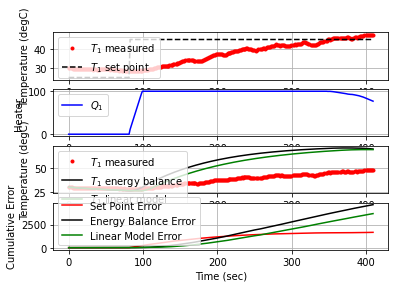

 412.3  45.00  47.61  74.57  -0.51  75.08  -0.00


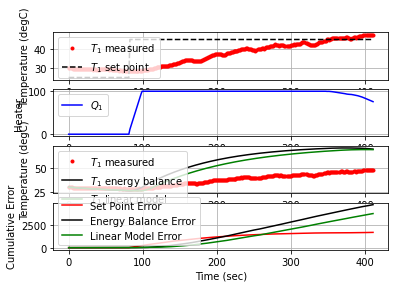

 413.6  45.00  47.66  73.55  -0.52  74.07  -0.00


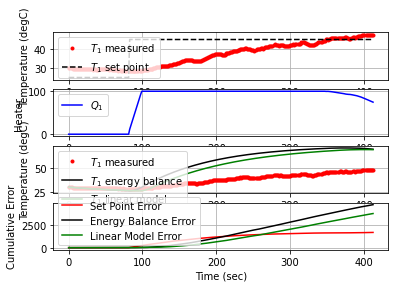

 414.9  45.00  47.93  72.42  -0.56  73.00  -0.01


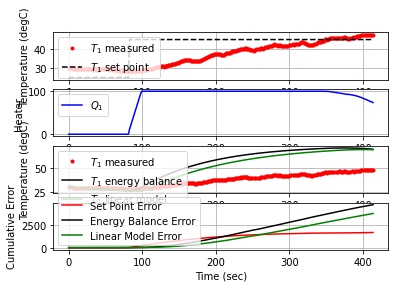

 416.3  45.00  48.07  71.16  -0.59  71.76  -0.00


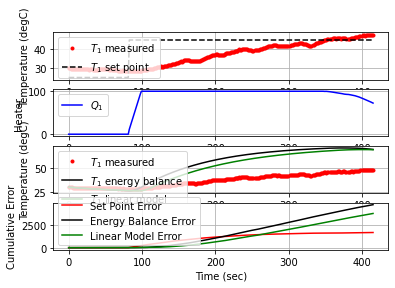

 417.7  45.00  48.03  69.92  -0.59  70.51   0.00


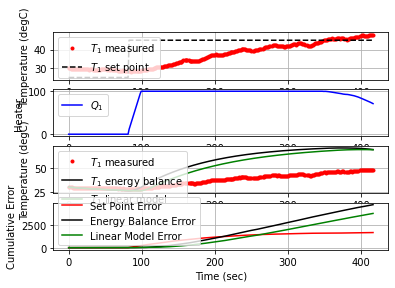

 418.9  45.00  48.01  68.81  -0.59  69.39   0.00


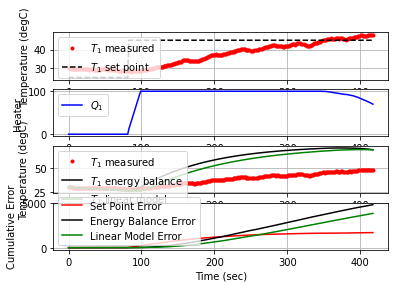

 420.4  45.00  48.18  67.45  -0.61  68.06  -0.01


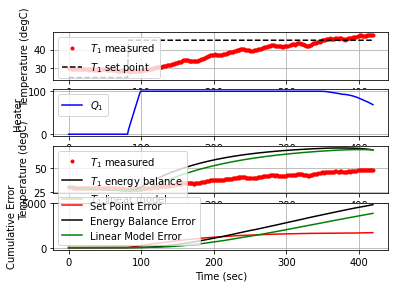

 421.7  45.00  48.19  66.23  -0.62  66.85  -0.00


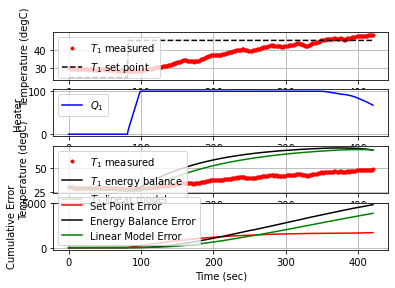

 423.1  45.00  47.93  65.06  -0.58  65.64   0.01


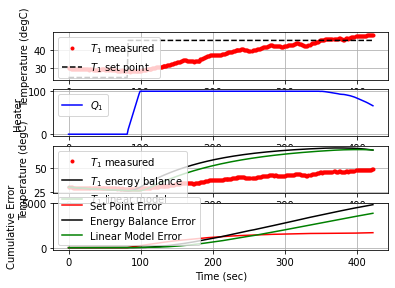

 424.5  45.00  47.59  64.07  -0.52  64.57   0.01


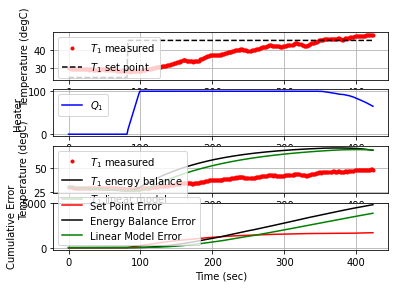

 425.8  45.00  47.16  63.27  -0.44  63.70   0.02


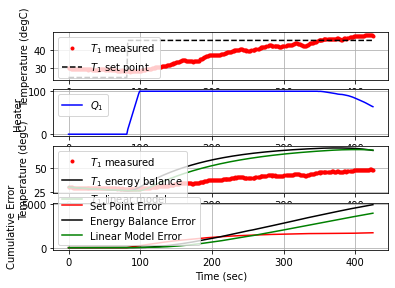

 427.2  45.00  46.79  62.61  -0.36  62.96   0.01


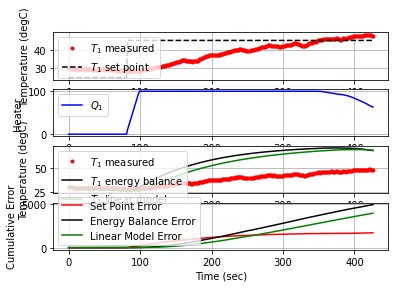

 428.6  45.00  46.55  61.99  -0.31  62.30   0.01


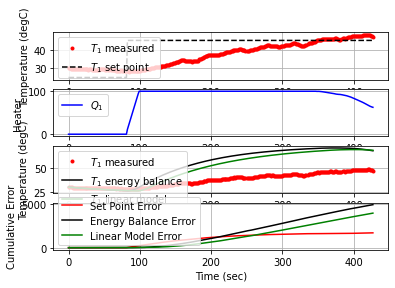

 429.9  45.00  46.68  61.31  -0.33  61.65  -0.00


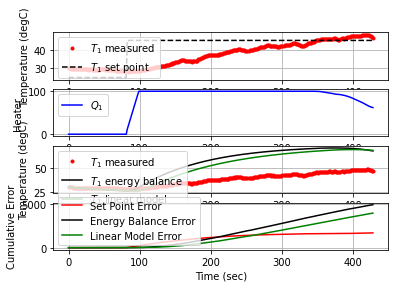

 431.1  45.00  46.74  60.66  -0.34  61.00  -0.00


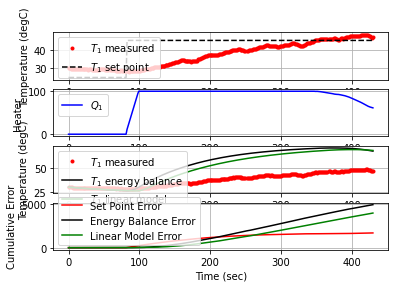

 432.4  45.00  46.54  60.10  -0.31  60.40   0.01


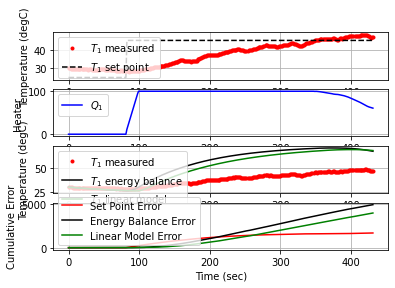

 433.7  45.00  46.60  59.48  -0.32  59.80  -0.00


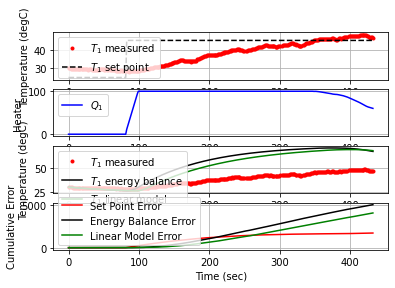

 435.1  45.00  46.23  59.00  -0.25  59.24   0.01


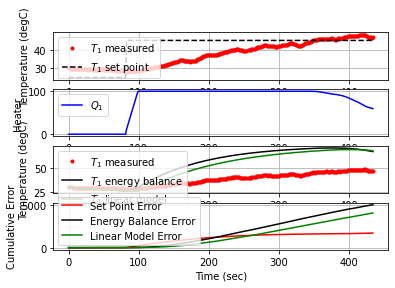

 436.5  45.00  46.12  58.57  -0.23  58.79   0.00


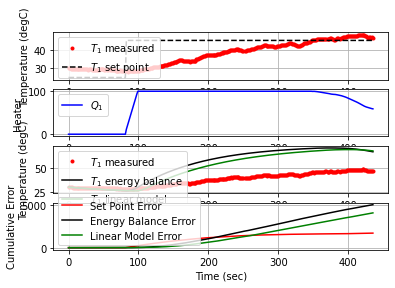

 437.8  45.00  45.98  58.19  -0.20  58.38   0.01


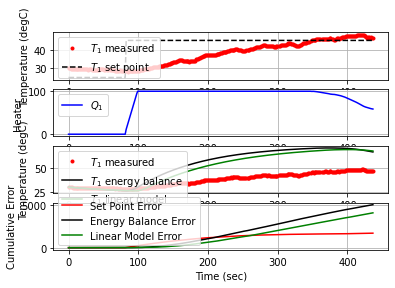

 439.1  45.00  45.69  57.98  -0.14  58.11   0.01


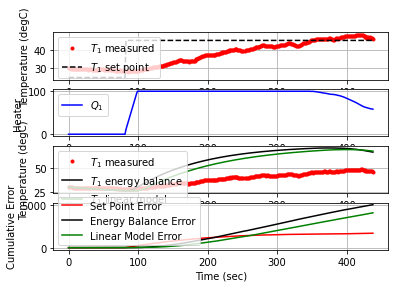

 440.5  45.00  45.53  57.78  -0.11  57.89   0.01


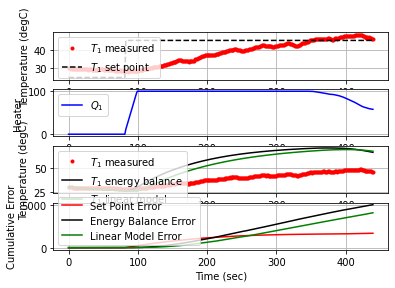

 441.8  45.00  45.01  57.90  -0.00  57.88   0.02


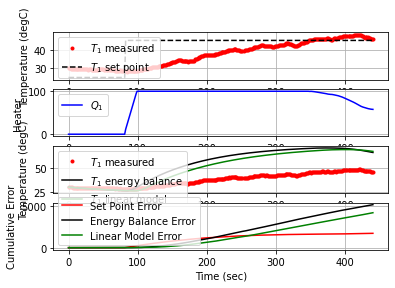

 443.3  45.00  45.04  57.86  -0.01  57.87  -0.00


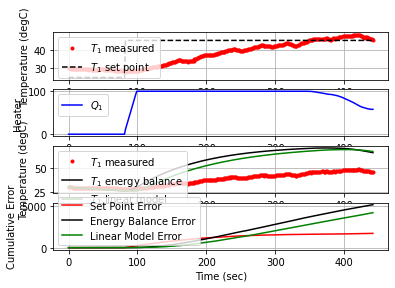

 444.5  45.00  44.88  57.94   0.02  57.91   0.01


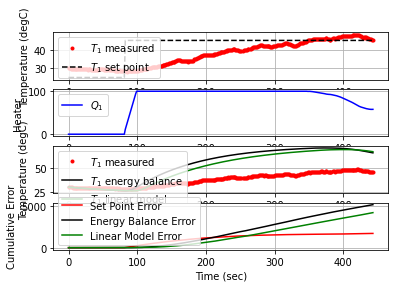

 445.8  45.00  45.14  57.82  -0.03  57.86  -0.01


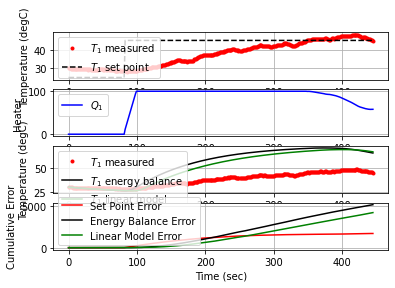

 447.1  45.00  45.47  57.57  -0.09  57.67  -0.01


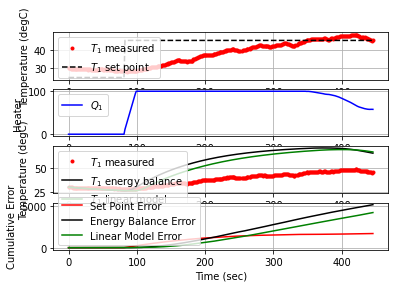

 448.4  45.00  45.45  57.41  -0.09  57.50   0.00


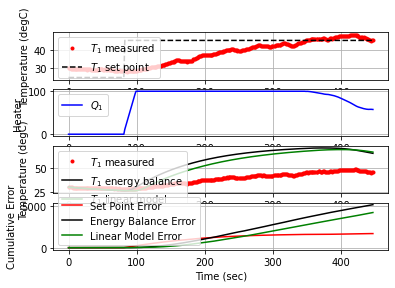

 449.8  45.00  45.76  57.02  -0.15  57.18  -0.01


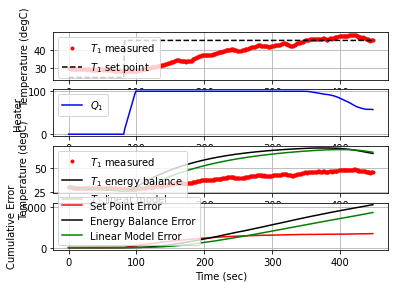

 451.1  45.00  45.80  56.72  -0.16  56.88  -0.00


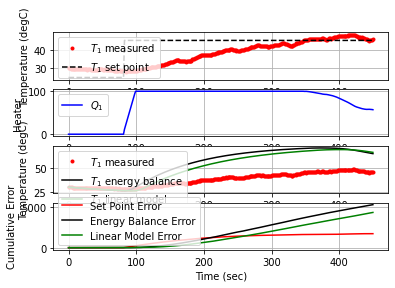

 452.3  45.00  46.42  56.08  -0.27  56.37  -0.02


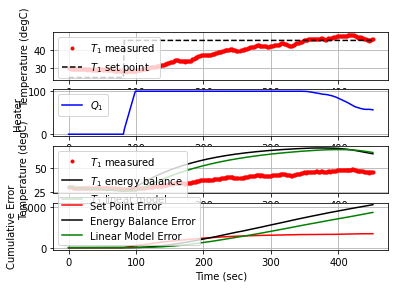

 453.6  45.00  46.63  55.40  -0.32  55.73  -0.01


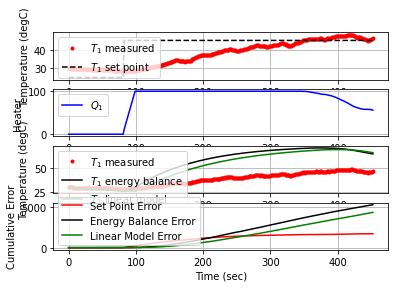

 455.0  45.00  47.00  54.53  -0.39  54.93  -0.01


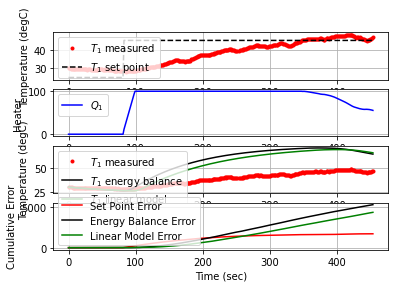

 456.3  45.00  47.25  53.63  -0.44  54.08  -0.01


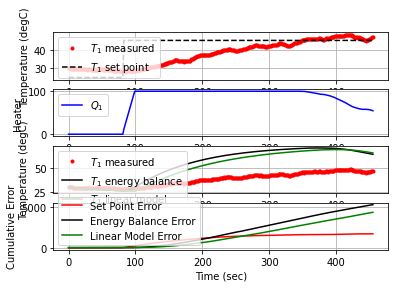

 457.8  45.00  47.32  52.63  -0.45  53.09  -0.00


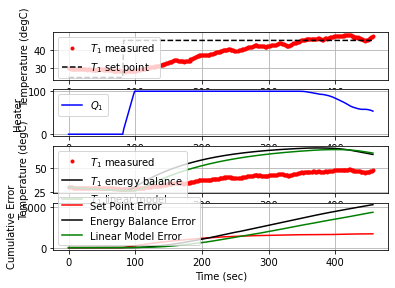

 459.1  45.00  47.17  51.82  -0.43  52.25   0.01


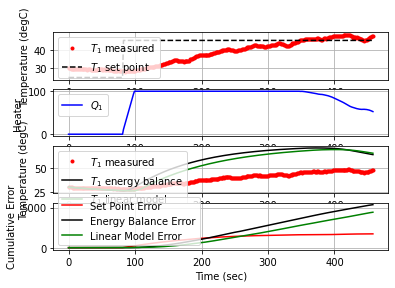

 460.4  45.00  47.39  50.86  -0.46  51.34  -0.01


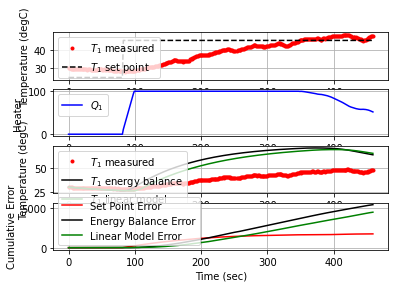

 461.8  45.00  47.57  49.75  -0.50  50.25  -0.01


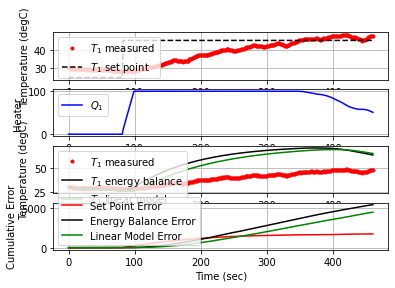

 463.1  45.00  47.96  48.61  -0.56  49.19  -0.01


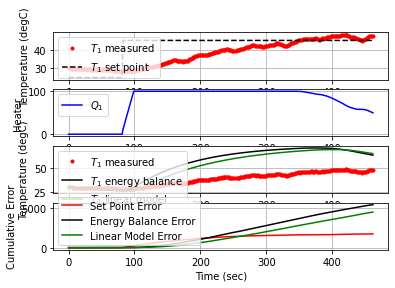

 464.6  45.00  48.27  47.14  -0.62  47.77  -0.01


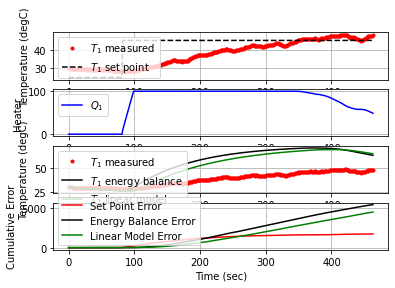

 465.8  45.00  48.24  46.03  -0.63  46.65   0.00


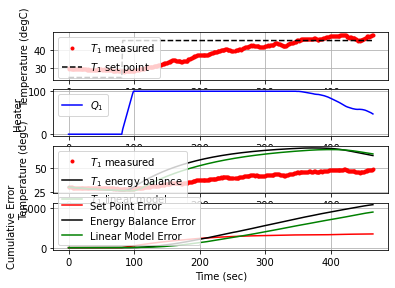

 467.1  45.00  48.42  44.66  -0.66  45.32  -0.01


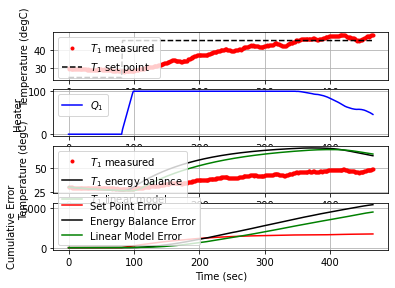

 468.5  45.00  48.71  43.22  -0.70  43.93  -0.01


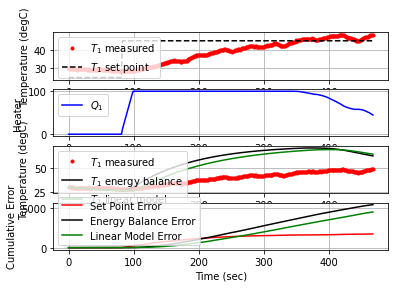

 469.8  45.00  48.86  41.73  -0.74  42.47  -0.01


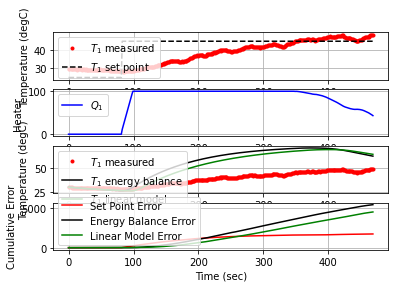

 471.1  45.00  48.96  40.15  -0.76  40.91  -0.00


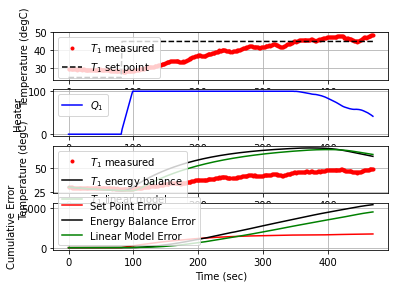

 472.6  45.00  49.29  38.31  -0.81  39.13  -0.01


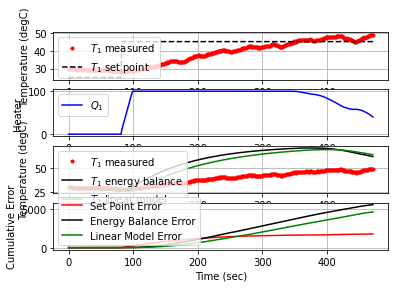

 474.0  45.00  49.18  36.71  -0.81  37.51   0.00


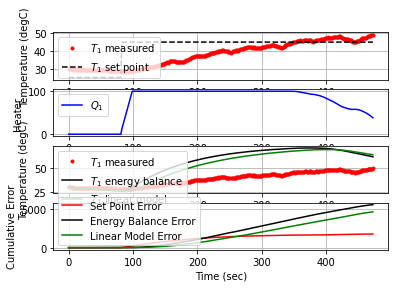

 475.3  45.00  49.22  35.04  -0.81  35.85  -0.00


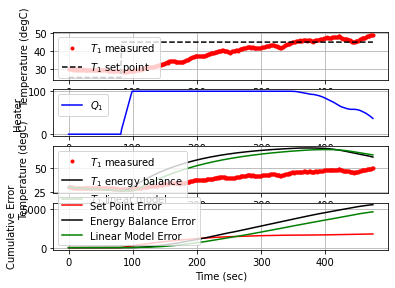

 476.6  45.00  49.51  33.32  -0.85  34.18  -0.01


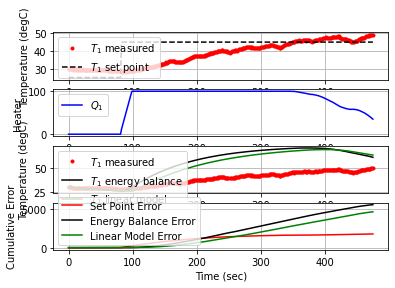

 478.0  45.00  49.34  31.63  -0.84  32.46   0.01


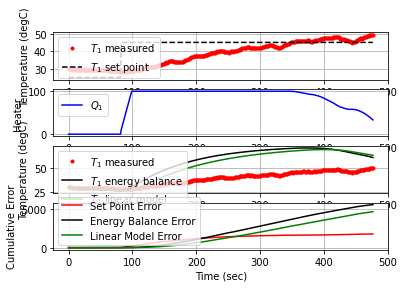

 479.6  45.00  49.40  29.64  -0.84  30.48  -0.00


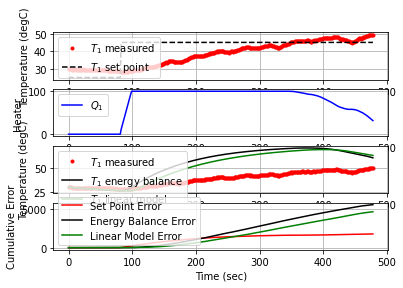

 480.9  45.00  49.58  27.86  -0.87  28.74  -0.01


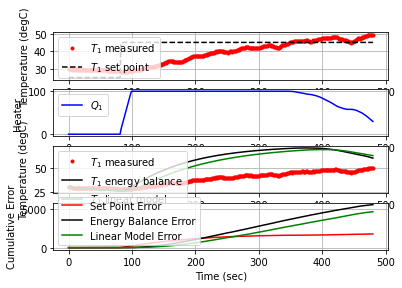

 482.3  45.00  49.60  26.06  -0.88  26.93  -0.00


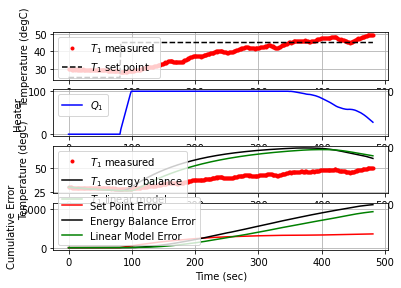

 483.6  45.00  49.13  24.57  -0.81  25.36   0.02


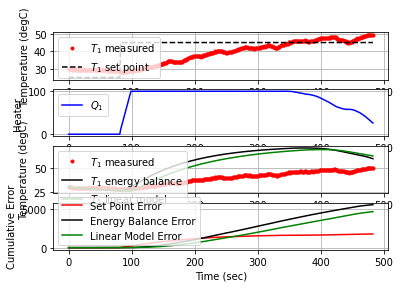

 484.9  45.00  49.35  22.92  -0.82  23.75  -0.01


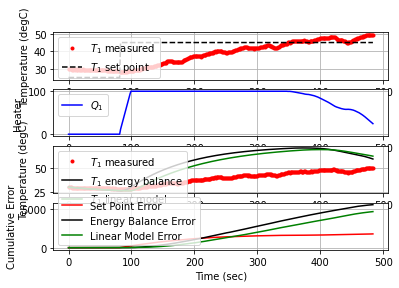

 486.3  45.00  49.35  21.14  -0.83  21.98  -0.00


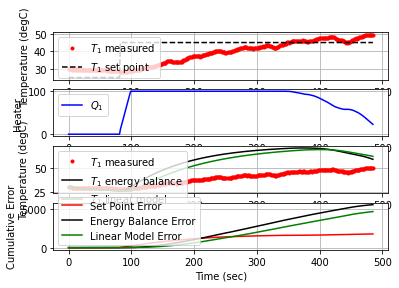

 487.9  45.00  49.37  19.21  -0.83  20.04  -0.00


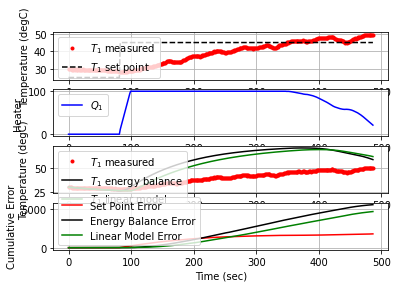

 489.4  45.00  49.64  17.12  -0.87  18.00  -0.01


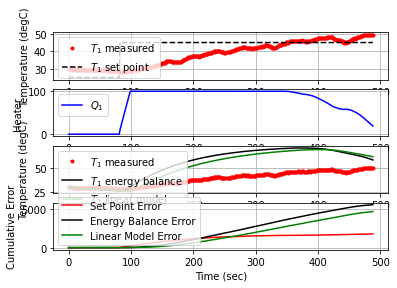

 490.7  45.00  49.42  15.50  -0.85  16.34   0.01


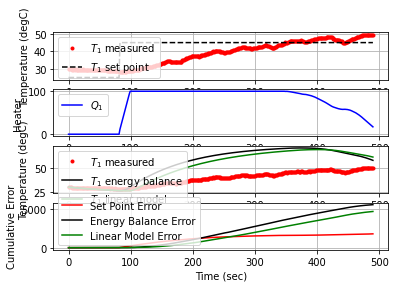

 492.1  45.00  49.44  13.79  -0.85  14.64  -0.00


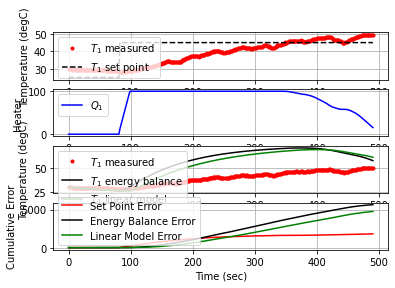

 493.4  30.00  49.60   4.03  -3.61   7.64  -0.01


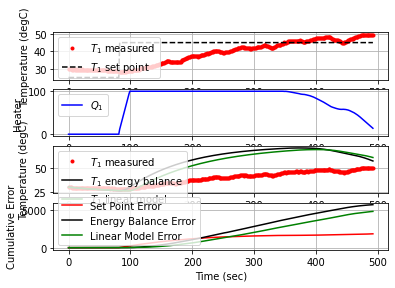

 494.7  30.00  49.66   0.00  -3.62   7.64  -0.00


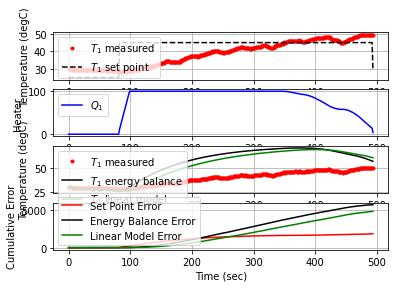

 496.0  30.00  49.90   0.00  -3.66   7.64  -0.01


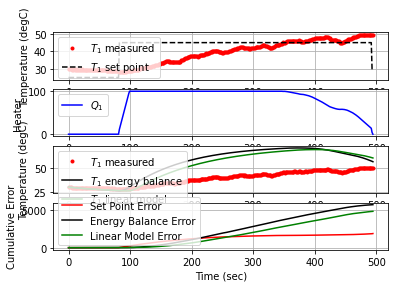

 497.4  30.00  49.92   0.00  -3.67   7.64  -0.00


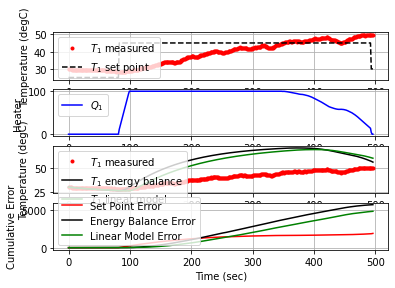

 498.7  30.00  49.58   0.00  -3.60   7.64   0.01


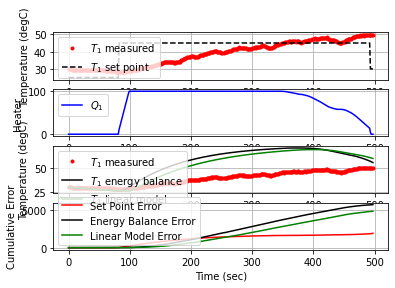

 500.0  30.00  49.48   0.00  -3.59   7.64   0.00


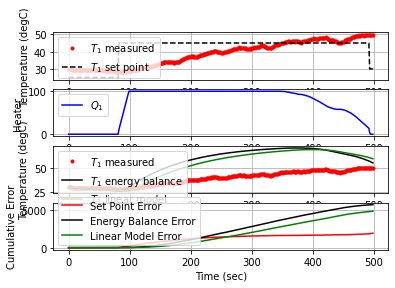

 501.4  30.00  49.56   0.00  -3.60   7.64  -0.00


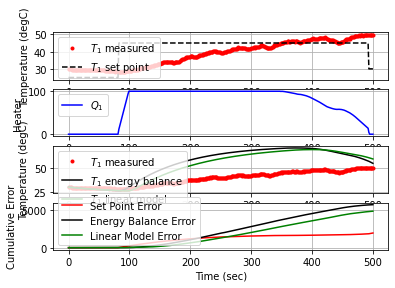

 502.6  30.00  49.63   0.00  -3.61   7.64  -0.00


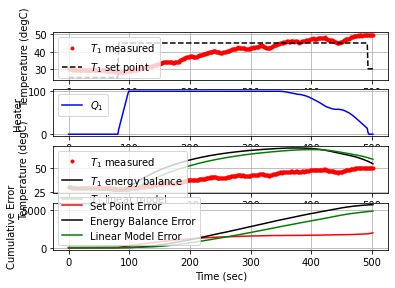

 503.9  30.00  49.84   0.00  -3.65   7.64  -0.01


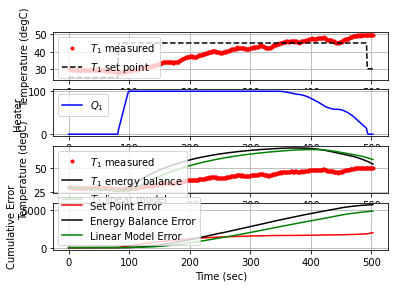

 505.2  30.00  49.80   0.00  -3.64   7.64   0.00


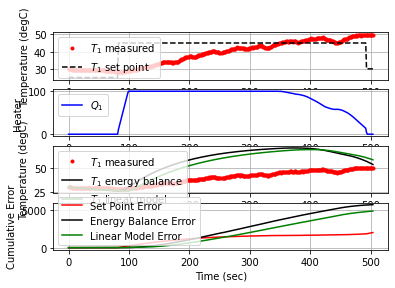

 506.5  30.00  49.93   0.00  -3.67   7.64  -0.00


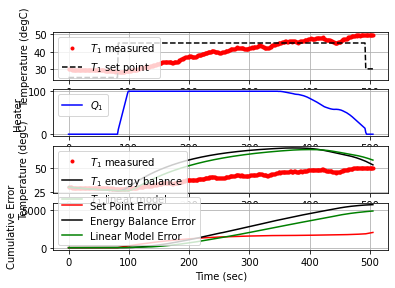

 507.8  30.00  49.50   0.00  -3.59   7.64   0.01


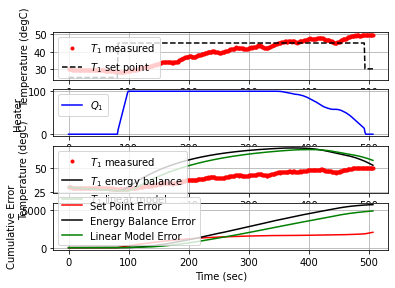

 509.3  30.00  49.35   0.00  -3.56   7.64   0.00


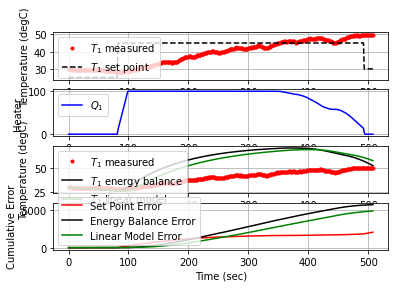

 510.7  30.00  49.25   0.00  -3.54   7.64   0.00


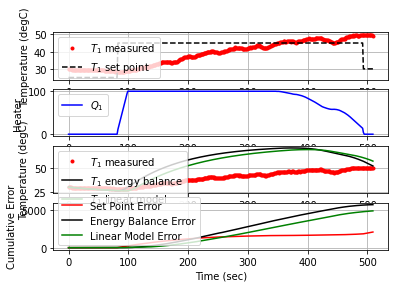

 512.0  30.00  49.17   0.00  -3.53   7.64   0.00


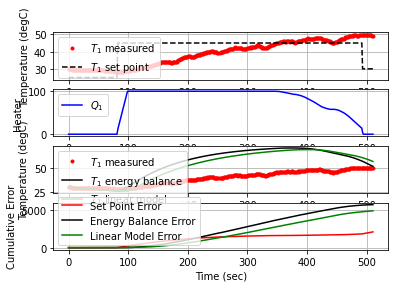

 513.4  30.00  48.89   0.00  -3.48   7.64   0.01


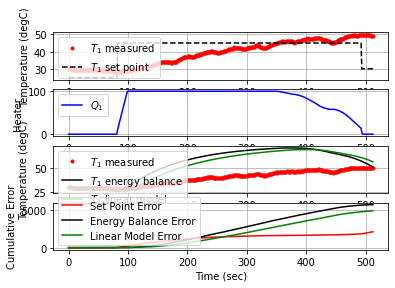

 514.8  30.00  48.83   0.00  -3.47   7.64   0.00


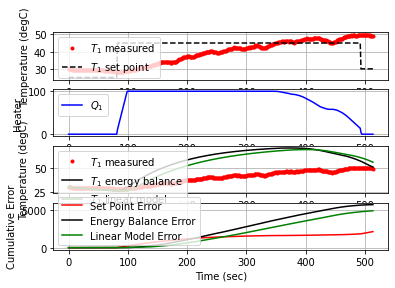

 516.4  30.00  48.70   0.00  -3.44   7.64   0.00


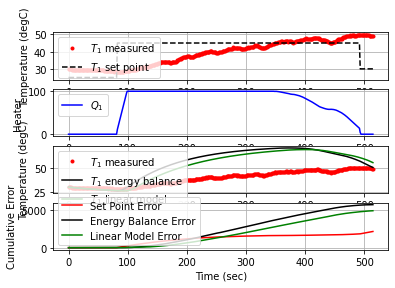

 517.8  30.00  48.68   0.00  -3.44   7.64   0.00


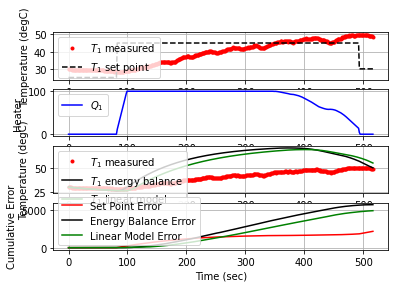

 519.2  30.00  48.54   0.00  -3.41   7.64   0.00


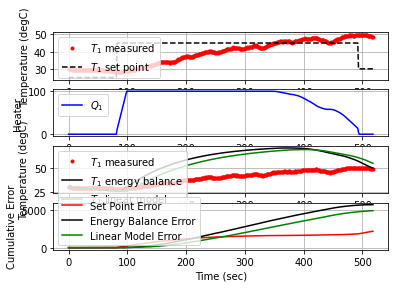

 520.5  30.00  48.66   0.00  -3.43   7.64  -0.00


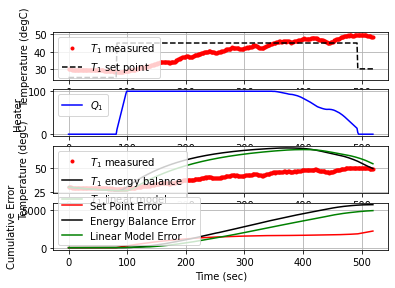

 521.8  30.00  48.50   0.00  -3.41   7.64   0.01


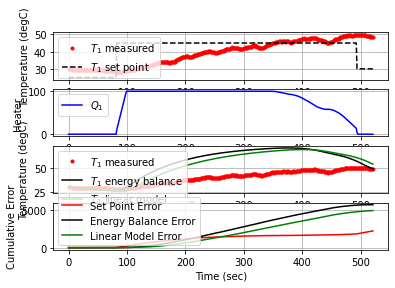

 523.2  30.00  48.50   0.00  -3.41   7.64  -0.00


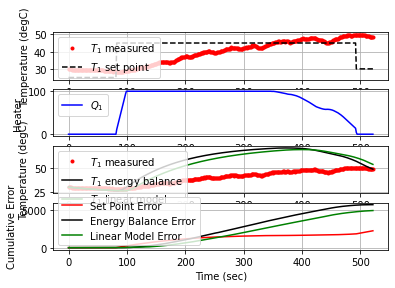

 524.7  30.00  48.56   0.00  -3.42   7.64  -0.00


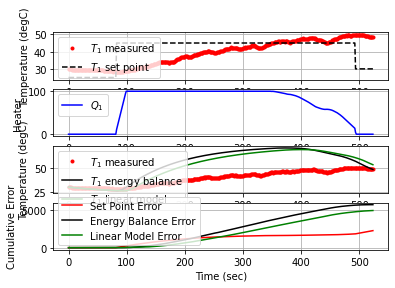

 526.1  30.00  48.45   0.00  -3.40   7.64   0.00


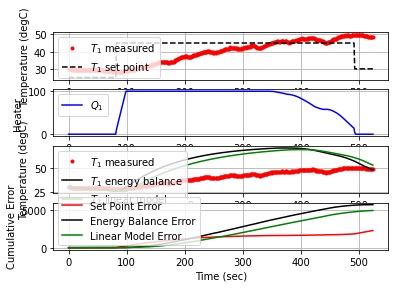

 527.5  30.00  48.36   0.00  -3.38   7.64   0.00


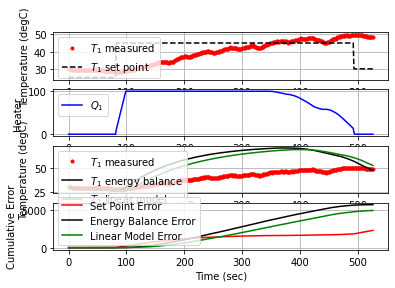

 528.9  30.00  48.25   0.00  -3.36   7.64   0.00


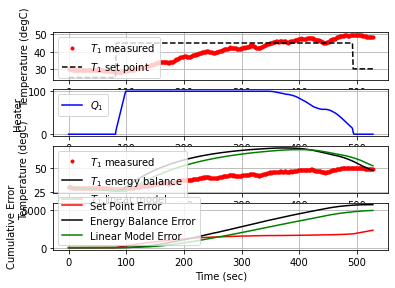

 530.4  30.00  48.22   0.00  -3.35   7.64   0.00


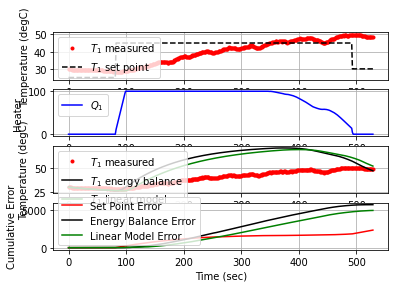

 531.9  30.00  47.50   0.00  -3.22   7.64   0.02


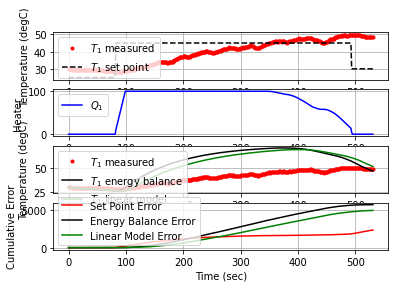

 533.2  30.00  47.38   0.00  -3.20   7.64   0.00


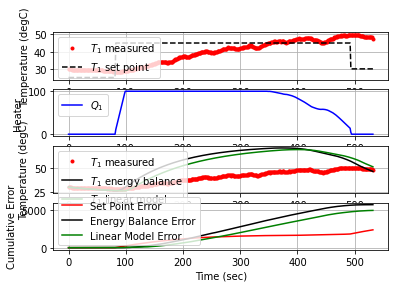

 534.5  30.00  47.32   0.00  -3.19   7.64   0.00


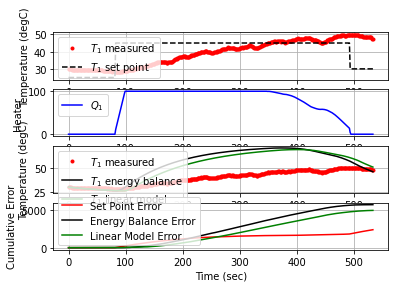

 536.0  30.00  47.34   0.00  -3.19   7.64  -0.00


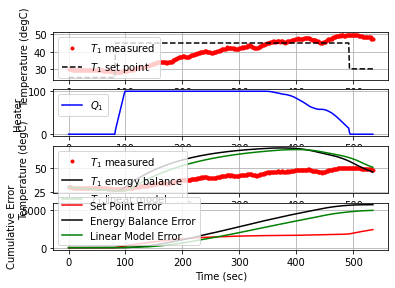

 537.4  30.00  46.94   0.00  -3.12   7.64   0.01


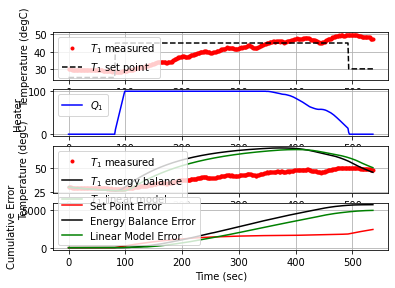

 538.9  30.00  46.62   0.00  -3.06   7.64   0.01


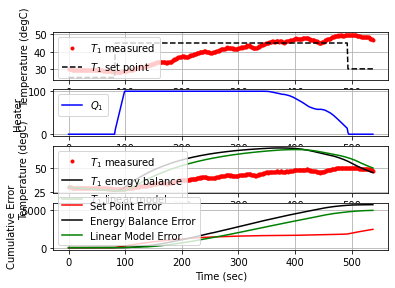

 540.3  30.00  46.46   0.00  -3.03   7.64   0.00


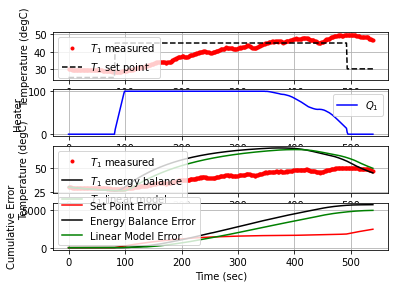

 541.6  30.00  46.12   0.00  -2.97   7.64   0.01


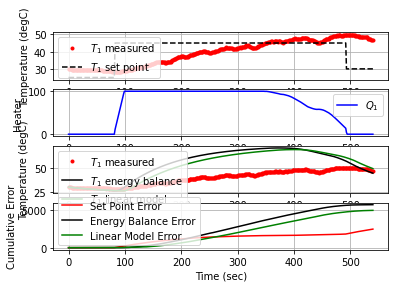

 543.0  30.00  45.98   0.00  -2.94   7.64   0.00


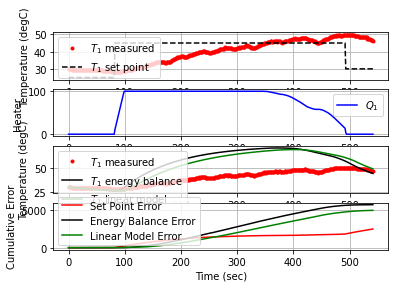

 544.3  30.00  45.88   0.00  -2.92   7.64   0.00


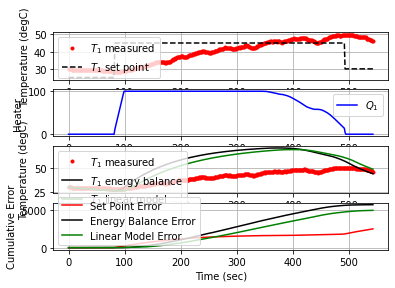

 545.7  30.00  45.79   0.00  -2.91   7.64   0.00


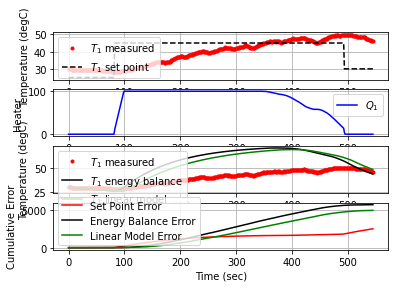

 547.3  30.00  45.64   0.00  -2.88   7.64   0.00


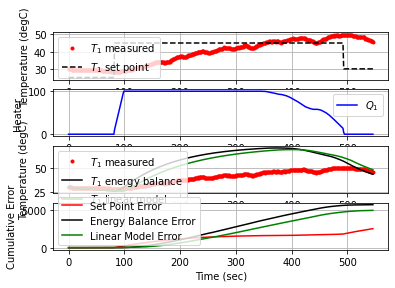

 548.7  30.00  45.75   0.00  -2.90   7.64  -0.00


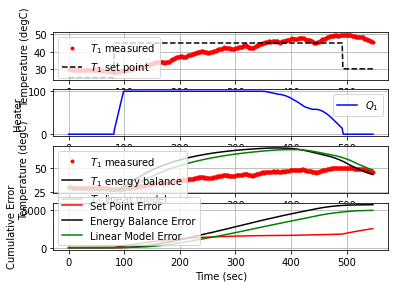

 549.9  30.00  45.43   0.00  -2.84   7.64   0.01


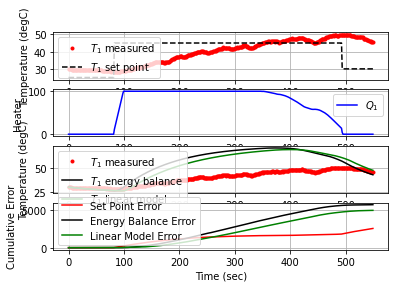

 551.2  30.00  44.96   0.00  -2.76   7.64   0.02


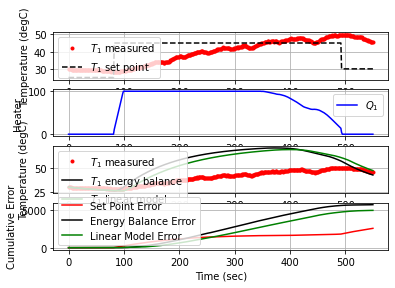

 552.5  30.00  44.93   0.00  -2.75   7.64   0.00


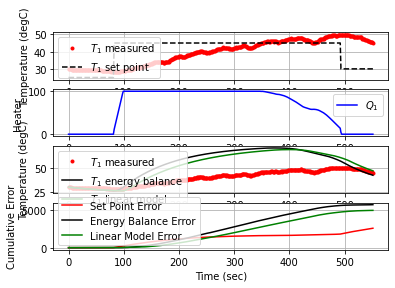

 553.8  30.00  44.99   0.00  -2.76   7.64  -0.00


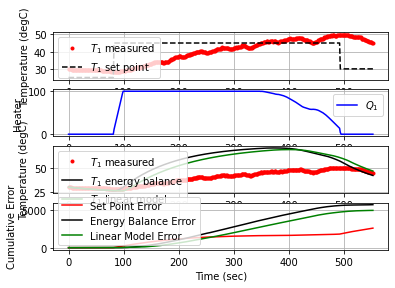

 555.2  30.00  44.98   0.00  -2.76   7.64   0.00


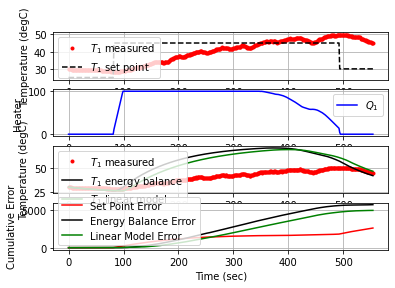

 556.4  30.00  45.07   0.00  -2.77   7.64  -0.00


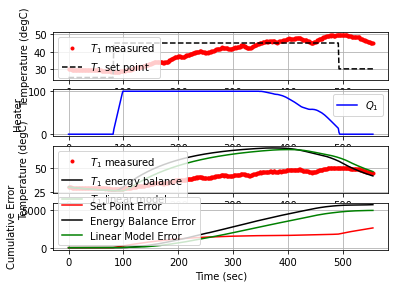

 557.8  30.00  44.93   0.00  -2.75   7.64   0.00


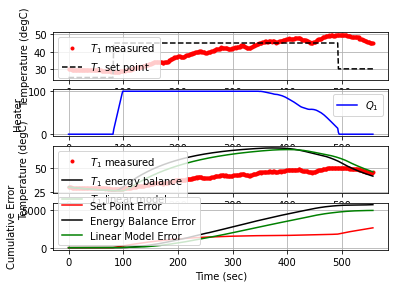

 559.2  30.00  44.81   0.00  -2.73   7.64   0.00


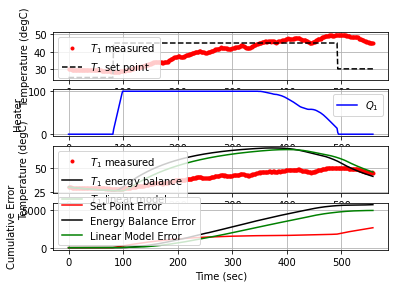

 560.6  30.00  44.74   0.00  -2.72   7.64   0.00


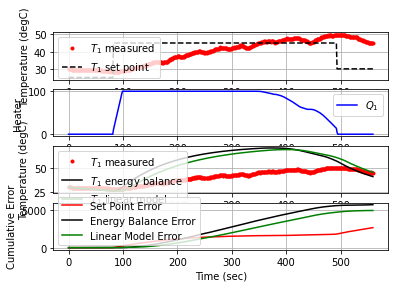

 562.0  30.00  44.50   0.00  -2.67   7.64   0.01


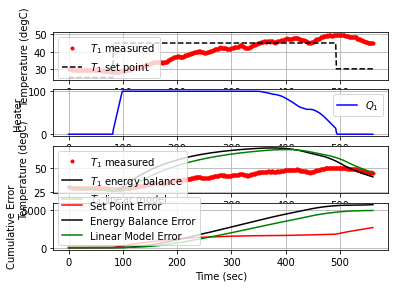

 563.3  30.00  44.30   0.00  -2.64   7.64   0.01


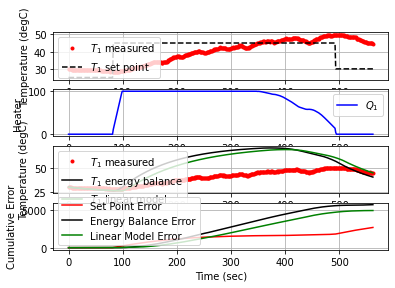

 564.6  30.00  44.32   0.00  -2.64   7.64  -0.00


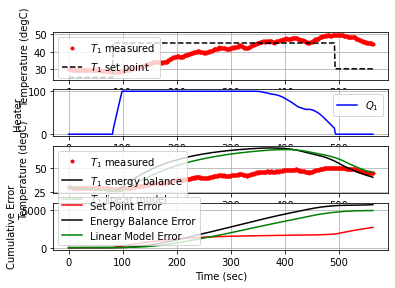

 565.9  30.00  44.16   0.00  -2.61   7.64   0.01


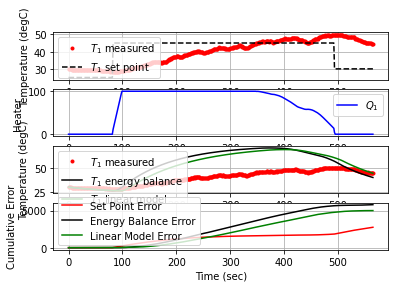

 567.3  30.00  44.31   0.00  -2.64   7.64  -0.00


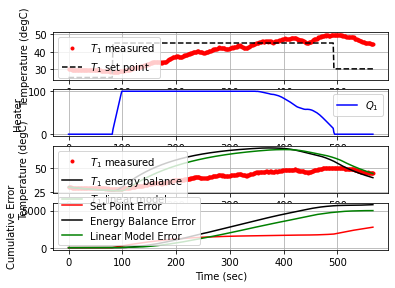

 568.6  30.00  44.19   0.00  -2.61   7.64   0.00


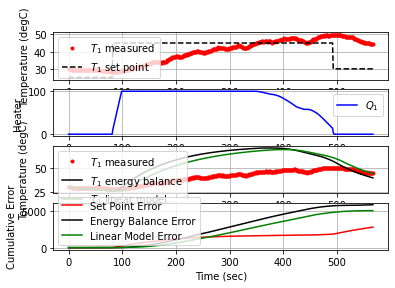

 570.0  30.00  44.03   0.00  -2.59   7.64   0.00


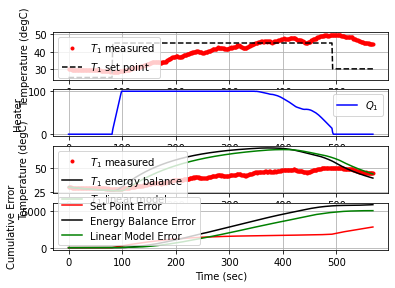

 571.3  30.00  43.74   0.23  -2.53   2.76   0.01


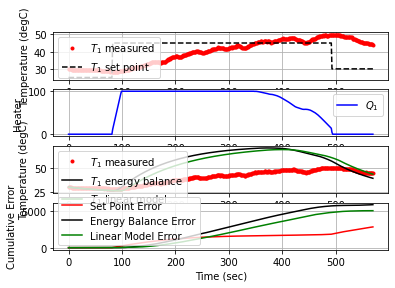

 572.6  30.00  43.43   0.00  -2.48   2.76   0.01


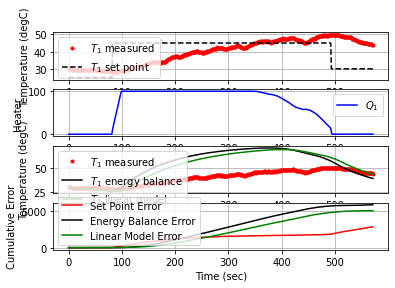

 573.8  30.00  43.29   0.00  -2.45   2.76   0.00


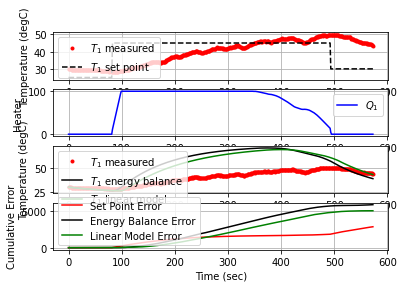

 575.1  30.00  43.34   0.00  -2.46   2.76  -0.00


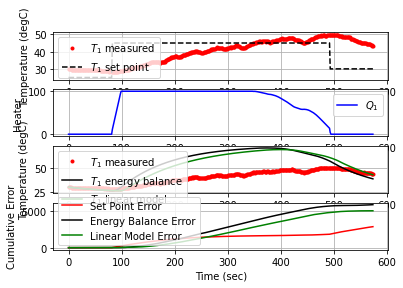

 576.6  30.00  43.20   0.00  -2.43   2.76   0.00


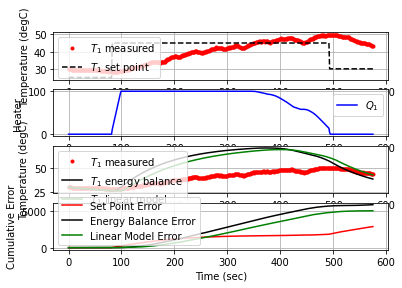

 578.0  30.00  43.23   0.00  -2.44   2.76  -0.00


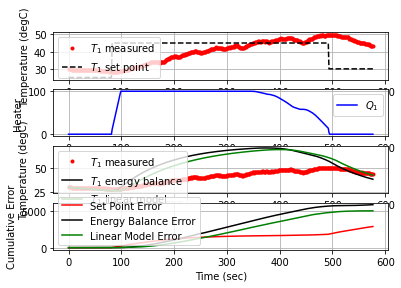

 579.3  30.00  43.15   0.00  -2.42   2.76   0.00


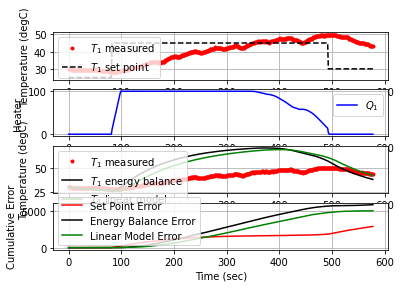

 580.6  30.00  43.03   0.00  -2.40   2.76   0.00


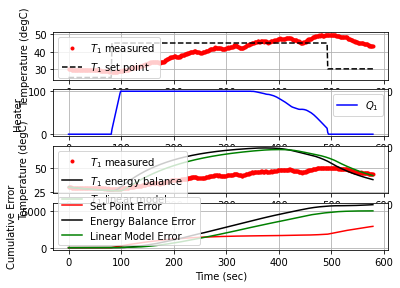

 581.9  30.00  42.90   0.00  -2.38   2.76   0.00


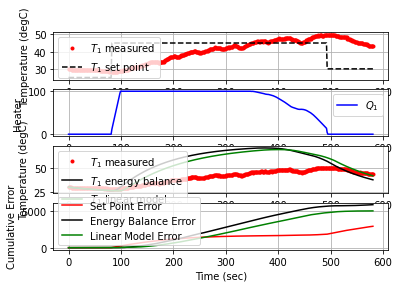

 583.2  30.00  42.83   0.00  -2.37   2.76   0.00


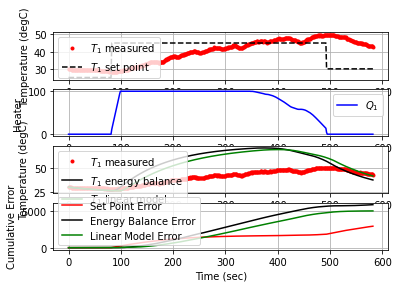

 584.7  30.00  42.70   0.00  -2.34   2.76   0.00


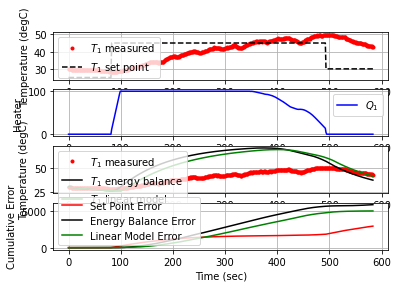

 586.0  30.00  42.69   0.00  -2.34   2.76   0.00


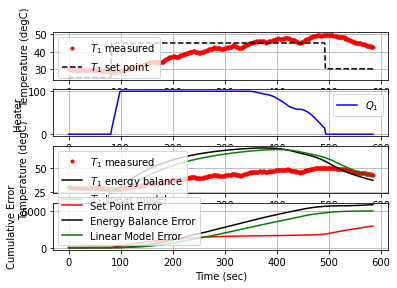

 587.5  30.00  42.59   0.00  -2.32   2.76   0.00


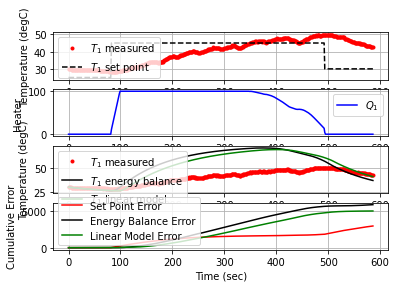

 588.8  30.00  42.43   0.00  -2.29   2.76   0.01


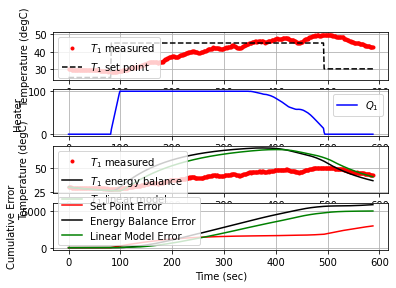

 590.1  30.00  42.42   0.00  -2.29   2.76   0.00


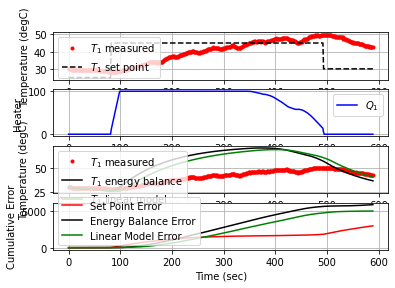

 591.6  30.00  42.42   0.00  -2.29   2.76  -0.00


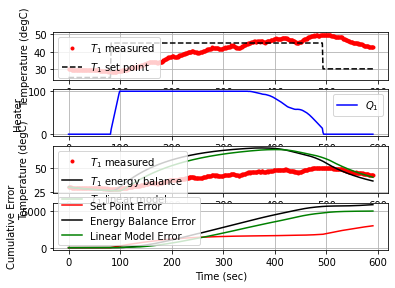

 592.9  30.00  42.37   0.00  -2.28   2.76   0.00


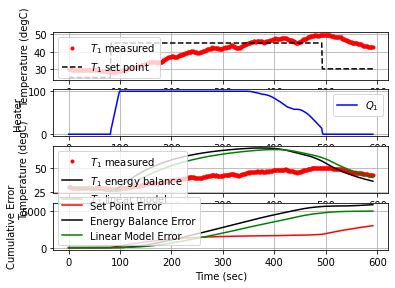

 594.2  30.00  42.24   0.00  -2.26   2.76   0.00


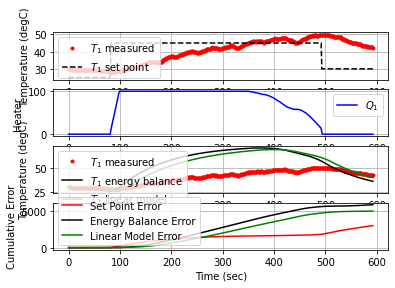

 595.5  30.00  42.02   0.00  -2.22   2.76   0.01


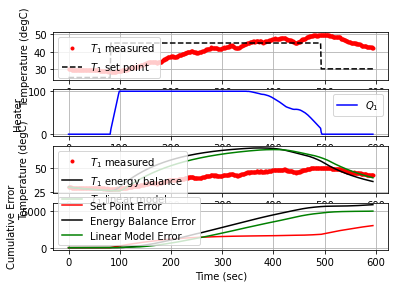

 596.9  30.00  41.78   0.00  -2.18   2.76   0.01


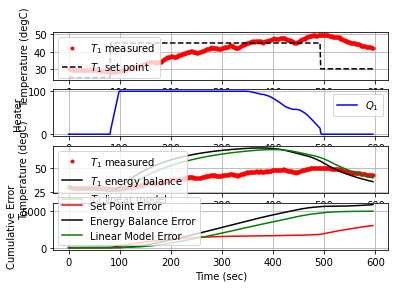

 598.5  30.00  41.81   0.00  -2.18   2.76  -0.00


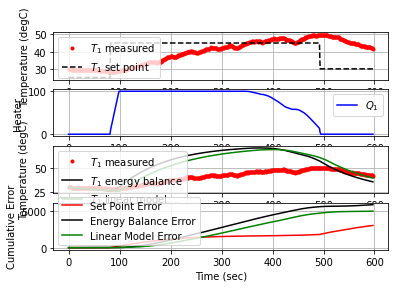

 600.0  30.00  41.50   0.00  -2.13   2.76   0.01


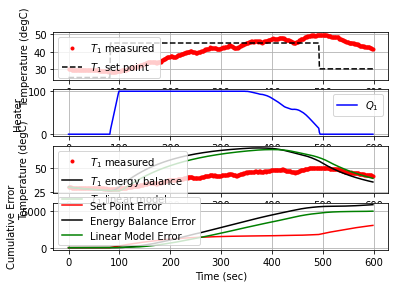

 601.6  30.00  41.06   0.00  -2.05   2.76   0.01


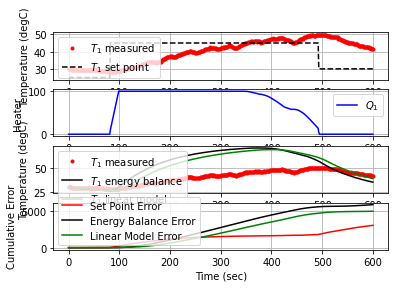

 602.9  30.00  41.03   0.00  -2.04   2.76   0.00


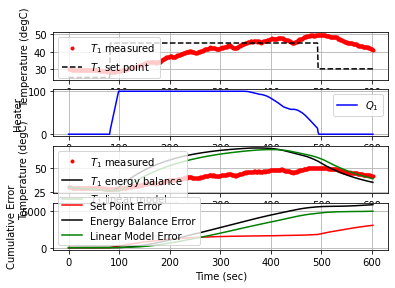

 604.2  30.00  40.84   0.00  -2.00   2.76   0.01


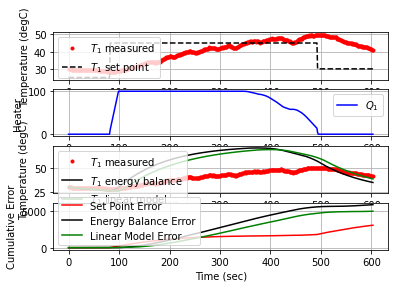

 605.6  30.00  40.71   0.00  -1.98   2.76   0.00


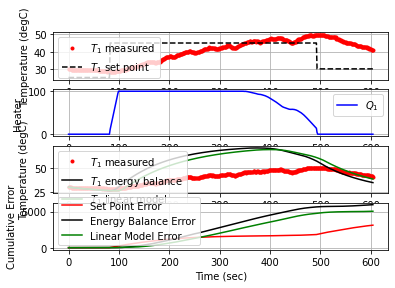

 607.0  30.00  40.69   0.00  -1.98   2.76   0.00


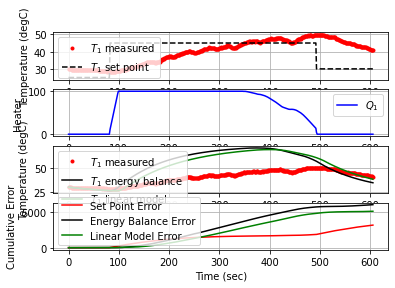

 608.3  30.00  40.41   0.00  -1.93   2.76   0.01


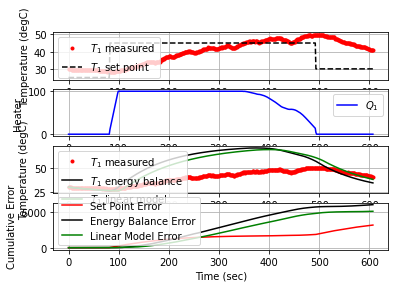

 609.7  30.00  40.44   0.00  -1.93   2.76  -0.00


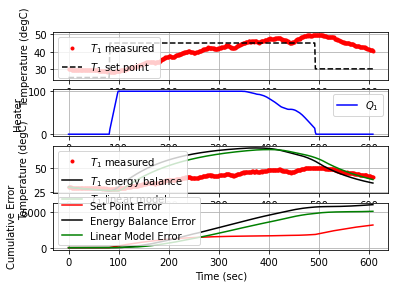

 611.0  30.00  40.39   0.00  -1.92   2.76   0.00


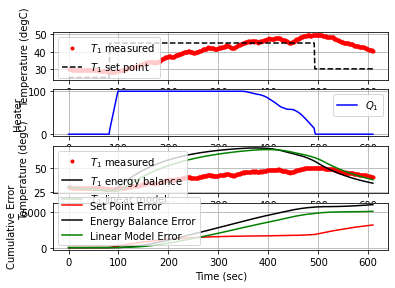

 612.3  30.00  40.25   0.00  -1.90   2.76   0.00


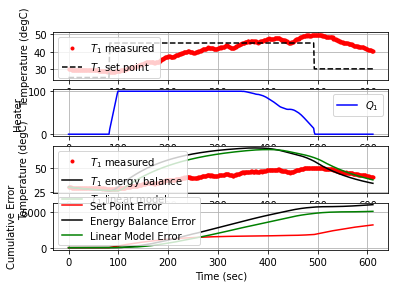

 613.8  30.00  40.18   0.00  -1.88   2.76   0.00


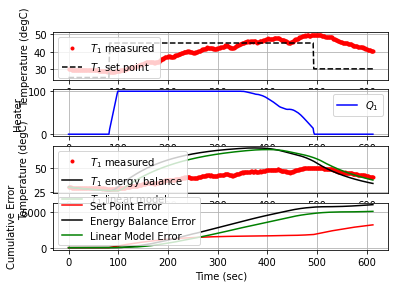

 615.1  30.00  40.12   0.00  -1.87   2.76   0.00


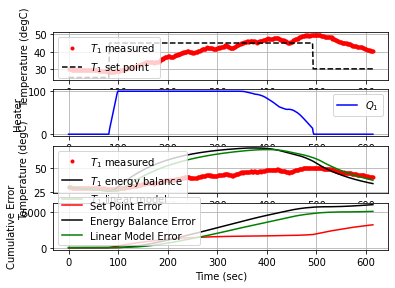

 616.4  30.00  40.05   0.00  -1.86   2.76   0.00


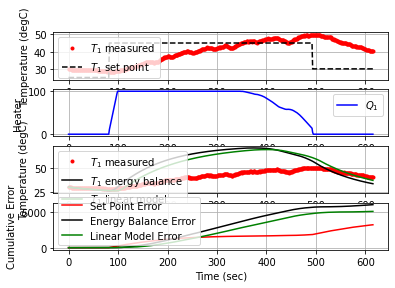

 617.8  30.00  39.94   0.00  -1.84   2.76   0.00


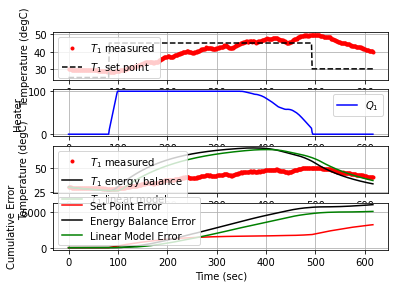

 619.3  30.00  40.02   0.00  -1.85   2.76  -0.00


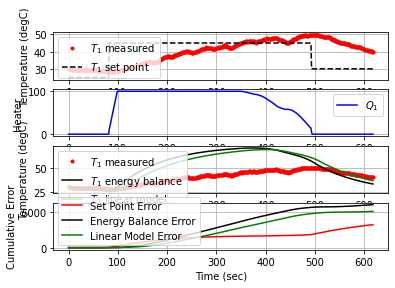

 620.9  30.00  39.80   0.00  -1.82   2.76   0.01


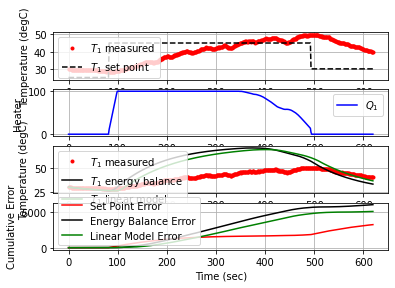

 622.6  30.00  39.70   0.00  -1.80   2.76   0.00


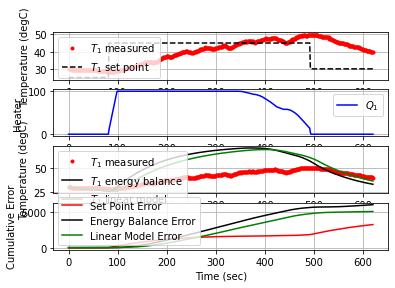

 624.1  30.00  39.53   0.00  -1.77   2.76   0.01


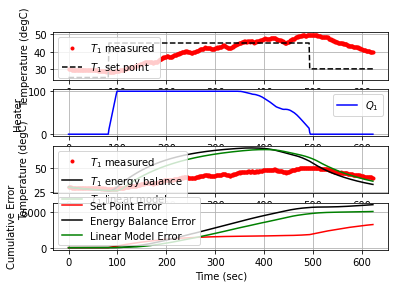

 625.6  30.00  39.44   0.00  -1.75   2.76   0.00


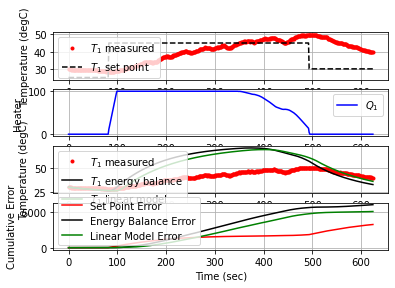

 627.0  30.00  39.37   0.00  -1.74   2.76   0.00


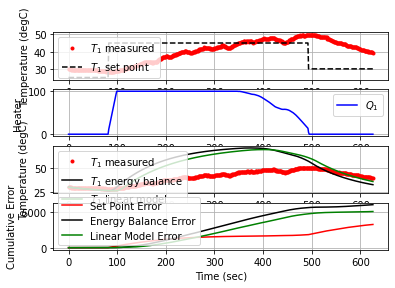

 628.5  30.00  38.99   0.00  -1.68   2.76   0.01


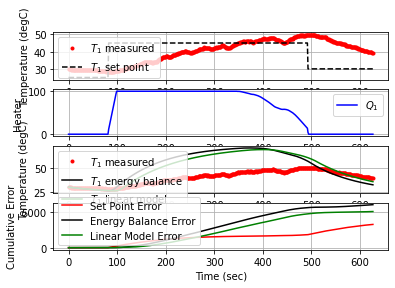

 630.1  30.00  38.83   0.00  -1.64   2.76   0.00


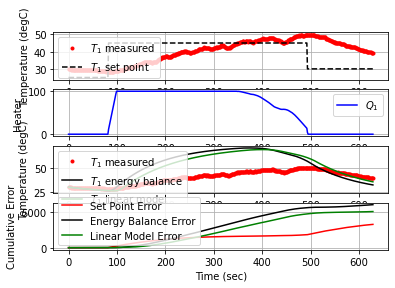

 631.5  30.00  38.48   0.00  -1.58   2.76   0.01


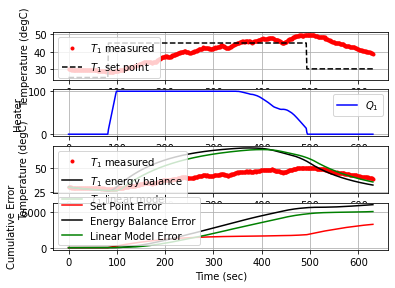

 632.9  30.00  38.62   0.00  -1.60   2.76  -0.00


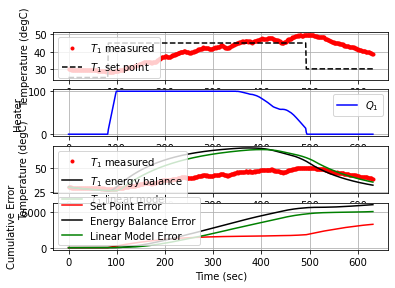

 634.3  30.00  38.40   0.00  -1.57   2.76   0.01


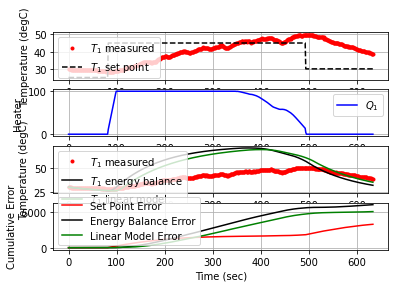

 635.6  30.00  38.46   0.00  -1.57   2.76  -0.00


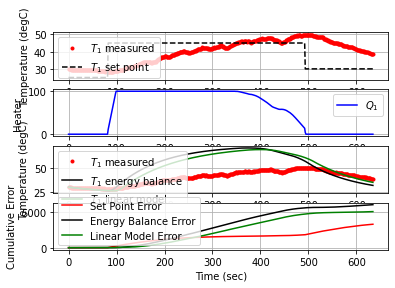

 637.1  30.00  38.48   0.00  -1.57   2.76  -0.00


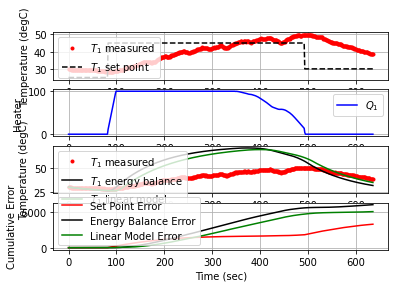

 638.4  30.00  38.44   0.00  -1.57   2.76   0.00


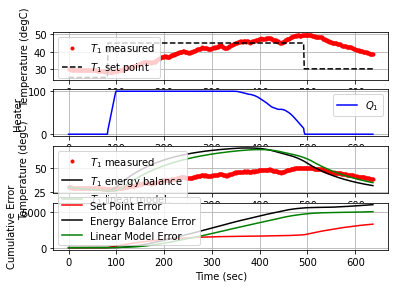

 639.7  30.00  38.32   0.00  -1.55   2.76   0.00


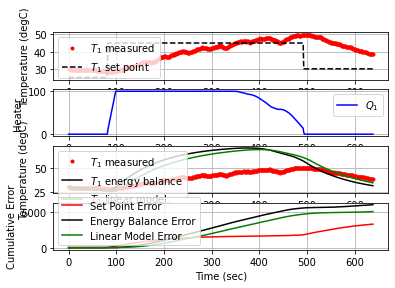

 641.0  30.00  38.32   0.00  -1.55   2.76  -0.00


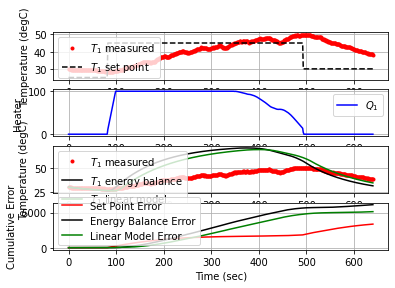

 642.3  30.00  38.16   0.00  -1.52   2.76   0.01


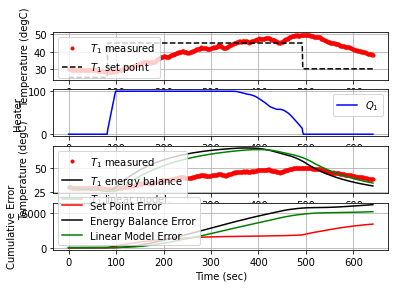

 643.7  30.00  38.12   0.00  -1.51   2.76   0.00


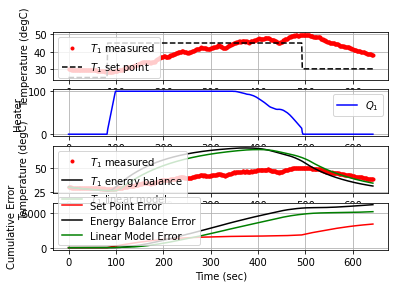

 645.1  30.00  38.00   0.00  -1.49   2.76   0.00


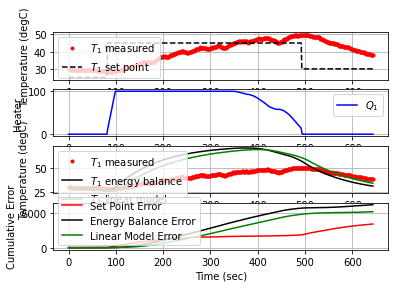

 646.5  30.00  37.84   0.00  -1.46   2.76   0.01


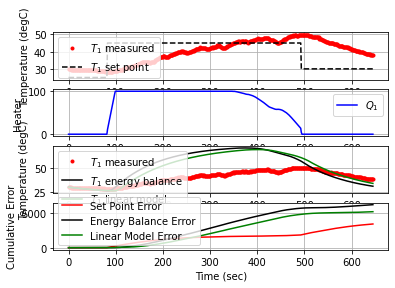

 647.8  30.00  37.90   0.00  -1.47   2.76  -0.00


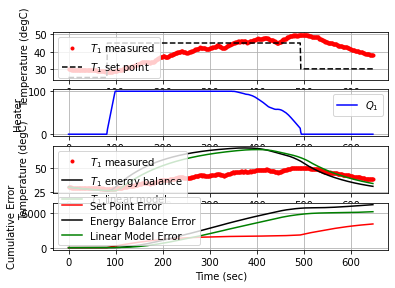

 649.1  30.00  37.70   0.00  -1.44   2.76   0.01


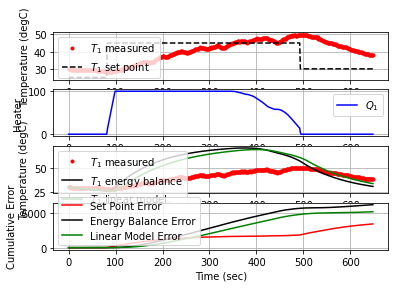

 650.4  30.00  37.77   0.00  -1.45   2.76  -0.00


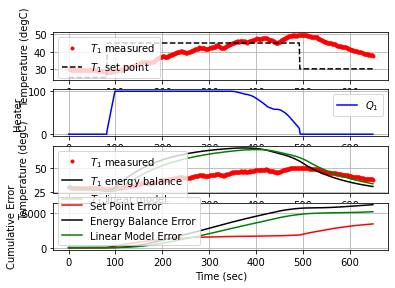

 651.9  30.00  37.51   0.00  -1.41   2.76   0.01


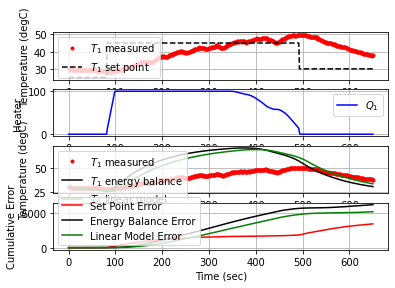

 653.2  30.00  37.42   0.00  -1.39   2.76   0.00


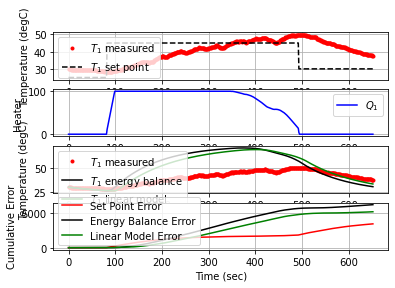

 654.6  30.00  37.33   0.00  -1.37   2.76   0.00


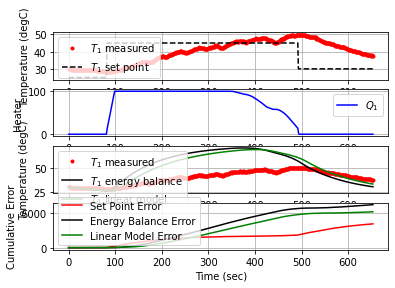

 655.9  30.00  37.10   0.00  -1.33   2.76   0.01


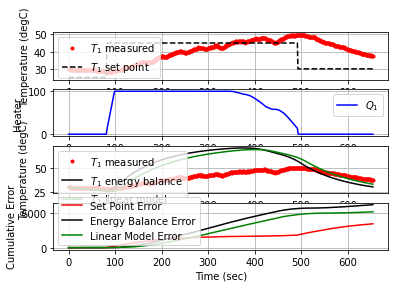

 657.3  30.00  37.00   0.00  -1.31   2.76   0.00


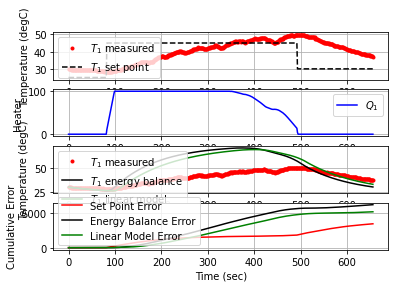

 658.7  30.00  36.75   0.00  -1.27   2.76   0.01


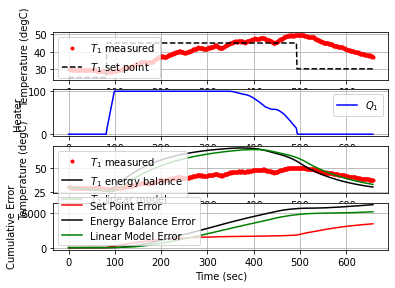

 660.0  30.00  36.87   0.00  -1.28   2.76  -0.00


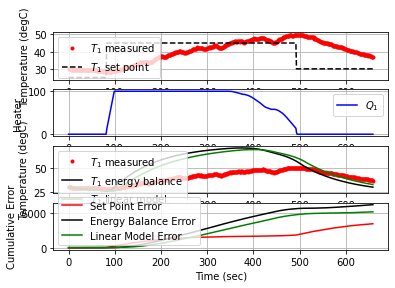

 661.3  30.00  36.81   0.00  -1.28   2.76   0.00


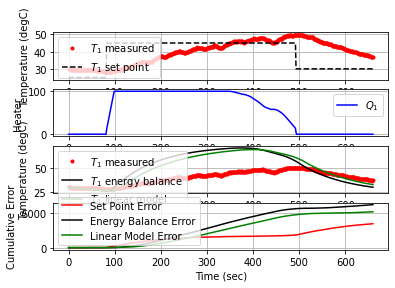

 662.7  30.00  36.73   0.00  -1.26   2.76   0.00


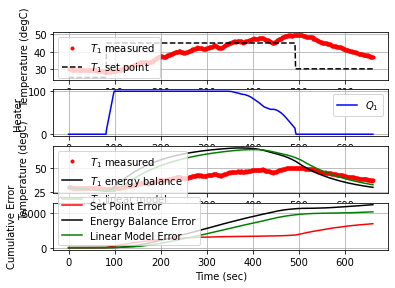

 664.0  30.00  36.79   0.00  -1.27   2.76  -0.00


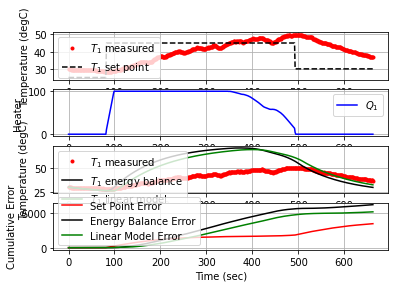

 665.4  30.00  36.83   0.00  -1.28   2.76  -0.00


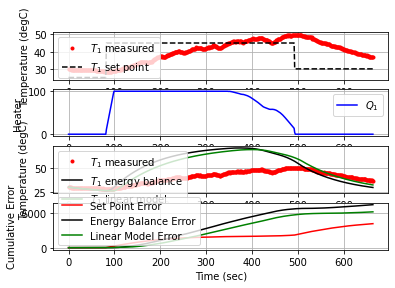

 666.8  30.00  36.74   0.00  -1.27   2.76   0.00


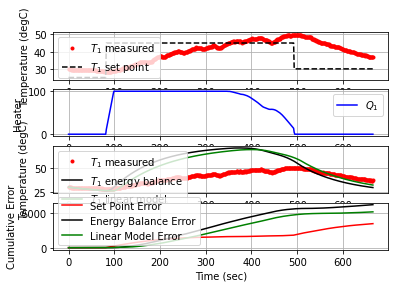

 668.1  30.00  36.48   0.00  -1.23   2.76   0.01


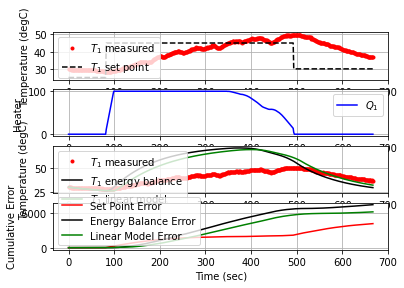

 669.4  30.00  36.55   0.00  -1.23   2.76  -0.00


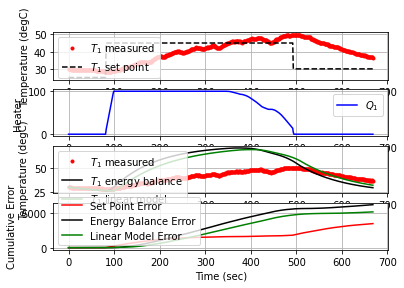

 670.7  30.00  36.45   0.00  -1.21   2.76   0.00


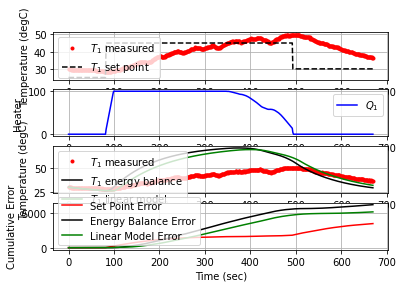

 672.0  30.00  36.33   0.00  -1.19   2.76   0.00


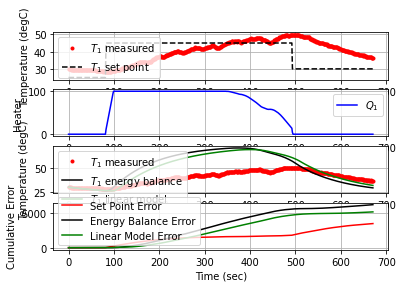

 673.4  30.00  36.21   0.00  -1.17   2.76   0.00


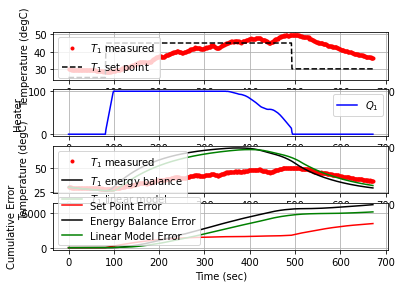

 674.8  30.00  36.08   0.00  -1.15   2.76   0.00


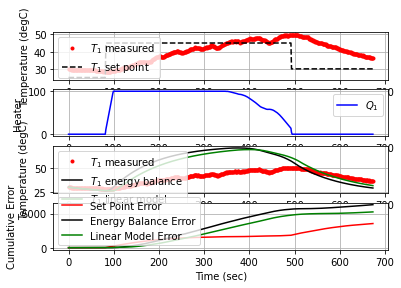

 676.1  30.00  35.86   0.00  -1.11   2.76   0.01


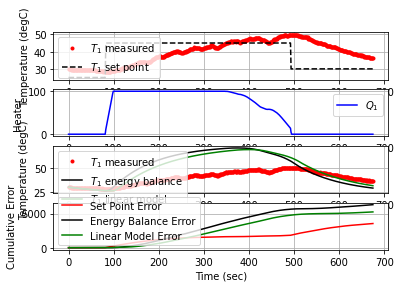

 677.5  30.00  35.72   0.00  -1.08   2.76   0.00


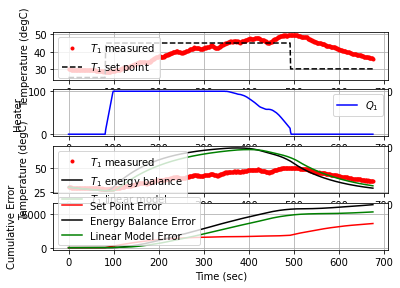

 678.9  30.00  35.68   0.00  -1.07   2.76   0.00


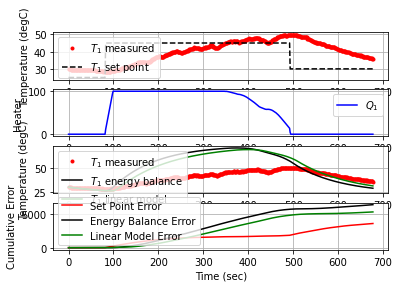

 680.4  30.00  35.76   0.00  -1.08   2.76  -0.00


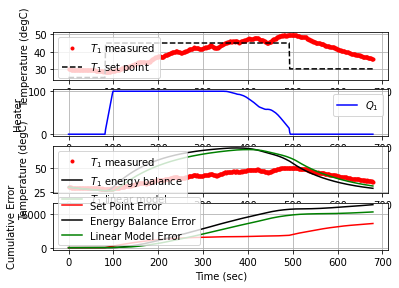

 681.7  30.00  35.62   0.00  -1.07   2.76   0.00


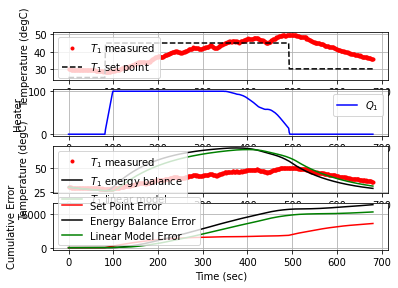

 683.1  30.00  35.67   0.00  -1.07   2.76  -0.00


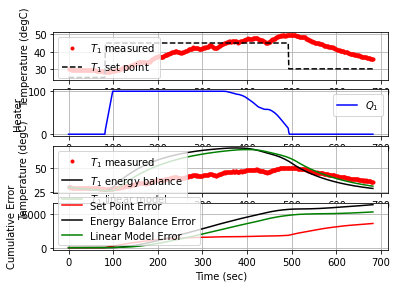

 684.4  30.00  35.58   0.00  -1.06   2.76   0.00


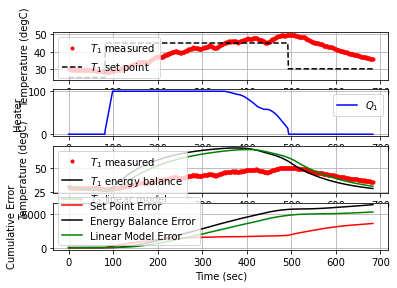

 685.7  30.00  35.38   0.00  -1.03   2.76   0.01


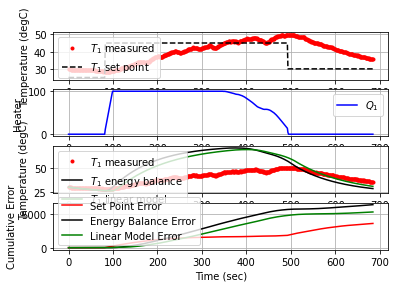

 687.2  30.00  35.23   0.00  -1.00   2.76   0.00


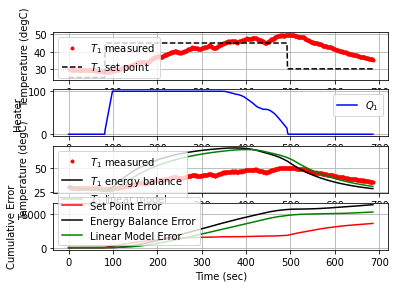

 688.6  30.00  35.36   0.00  -1.01   2.76  -0.00


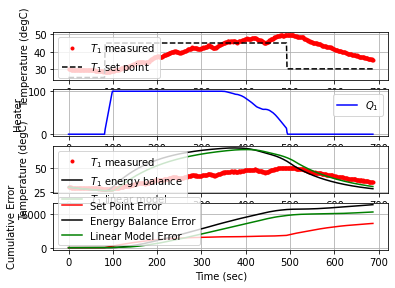

 689.9  30.00  35.25   0.00  -1.00   2.76   0.00


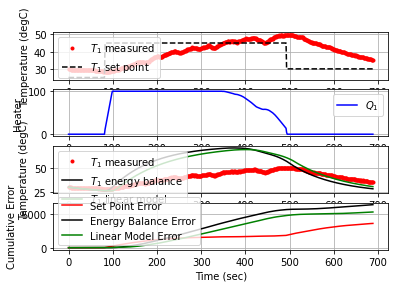

 691.3  30.00  35.28   0.00  -1.00   2.76  -0.00


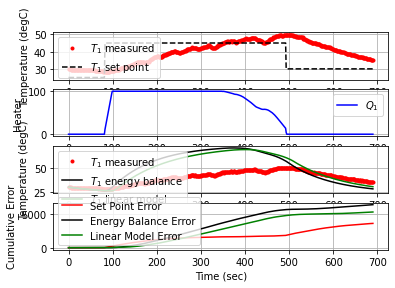

 692.6  30.00  35.13   0.00  -0.98   2.76   0.01


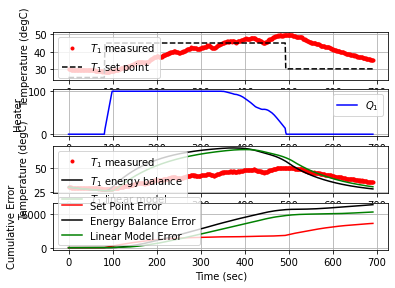

 694.1  30.00  35.22   0.00  -0.99   2.76  -0.00


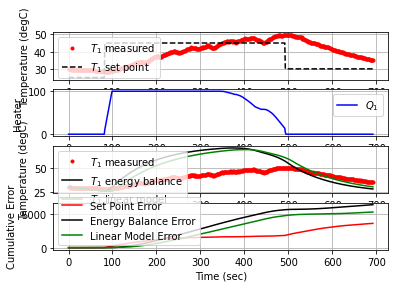

 695.4  30.00  34.98   0.00  -0.96   2.76   0.01


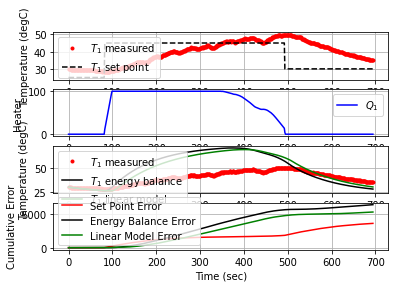

 696.8  30.00  34.86   0.00  -0.93   2.76   0.00


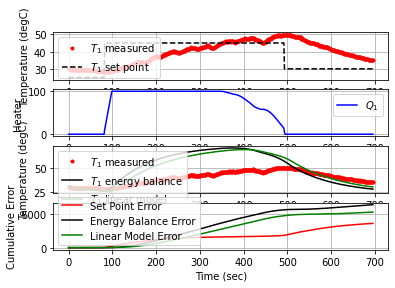

 698.1  30.00  34.87   0.00  -0.93   2.76  -0.00


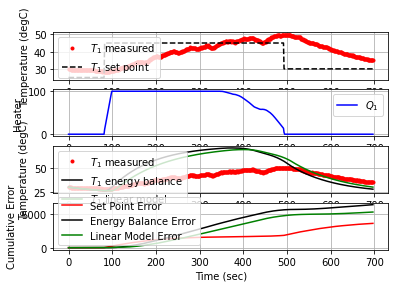

 699.5  30.00  34.70   0.05  -0.90   0.95   0.01


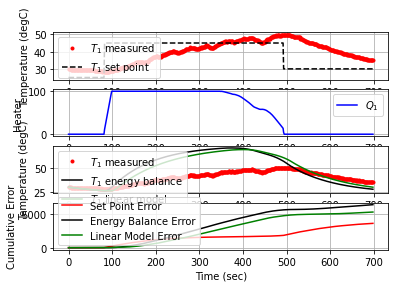

 701.0  30.00  34.64   0.00  -0.89   0.95   0.00


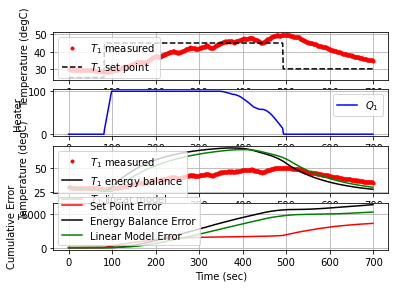

 702.3  30.00  34.62   0.00  -0.88   0.95   0.00


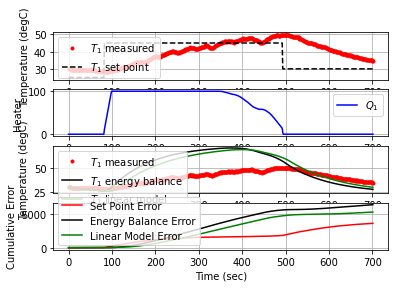

 703.6  30.00  34.67   0.00  -0.89   0.95  -0.00


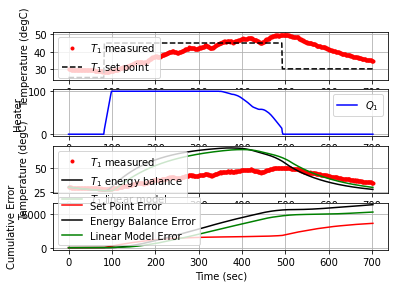

 705.0  30.00  34.53   0.00  -0.87   0.95   0.00


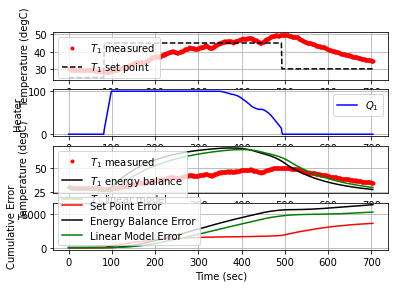

 706.3  30.00  34.54   0.00  -0.87   0.95  -0.00


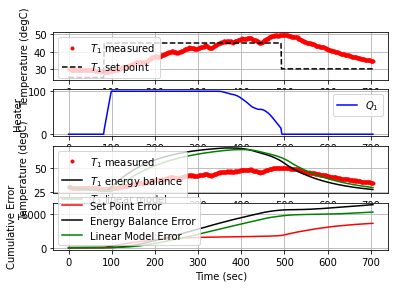

 707.9  30.00  34.49   0.00  -0.86   0.95   0.00


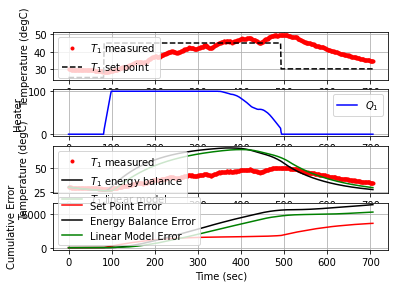

 709.2  30.00  34.38   0.00  -0.84   0.95   0.00


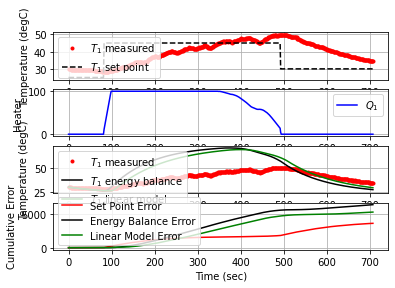

 710.6  30.00  34.29   0.00  -0.82   0.95   0.00


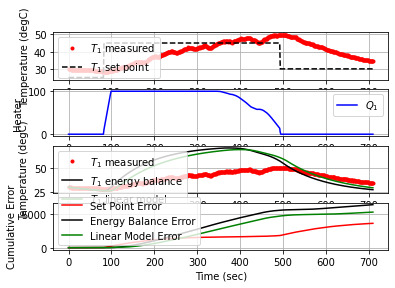

 711.9  30.00  34.26   0.00  -0.82   0.95   0.00


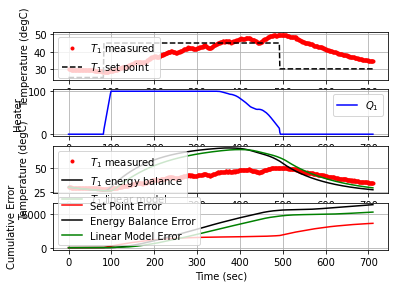

 713.3  30.00  34.20   0.00  -0.81   0.95   0.00


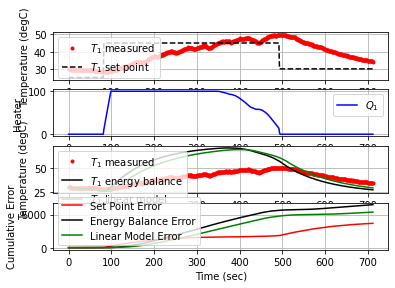

 714.8  30.00  34.20   0.00  -0.80   0.95  -0.00


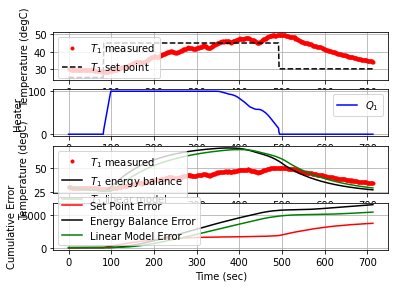

 716.1  30.00  34.12   0.00  -0.79   0.95   0.00


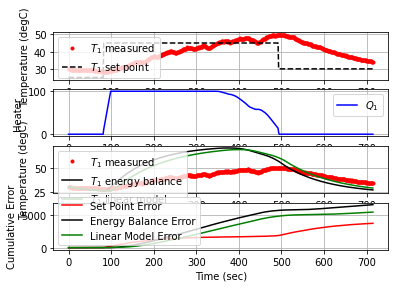

 717.5  30.00  34.08   0.00  -0.78   0.95   0.00


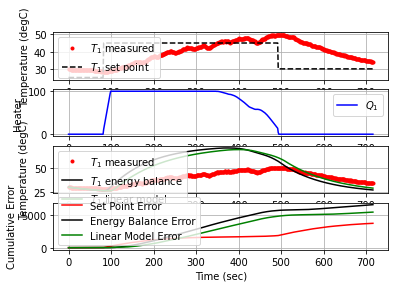

 718.8  30.00  34.04   0.00  -0.78   0.95   0.00


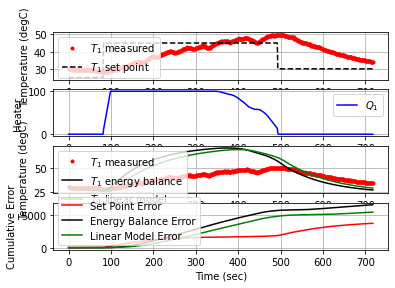

 720.2  30.00  34.02   0.00  -0.77   0.95   0.00


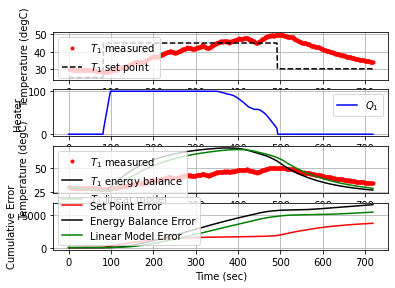

 721.6  30.00  33.90   0.00  -0.75   0.95   0.00


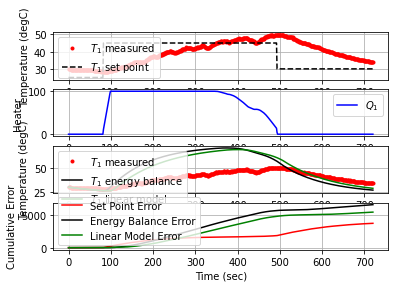

 723.0  30.00  33.89   0.00  -0.75   0.95   0.00


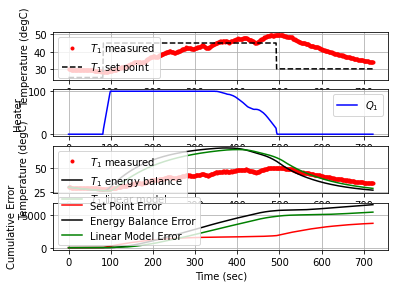

 724.3  30.00  33.86   0.00  -0.74   0.95   0.00


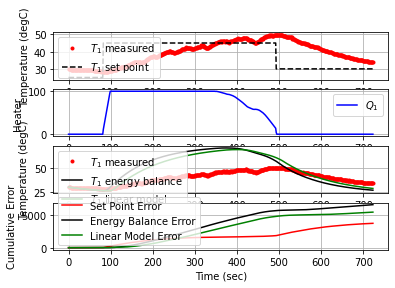

 725.7  30.00  33.80   0.00  -0.73   0.95   0.00


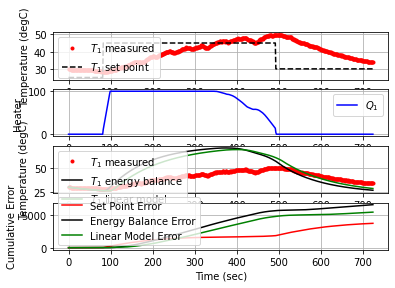

 727.0  30.00  33.73   0.00  -0.72   0.95   0.00


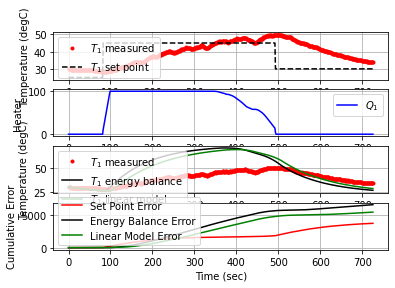

 728.5  30.00  33.66   0.00  -0.71   0.95   0.00


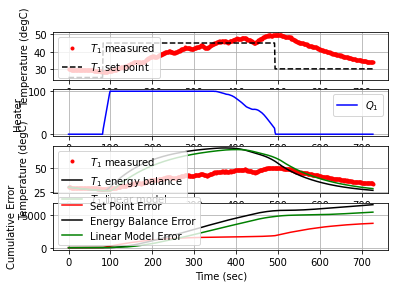

 729.8  30.00  33.66   0.00  -0.71   0.95  -0.00


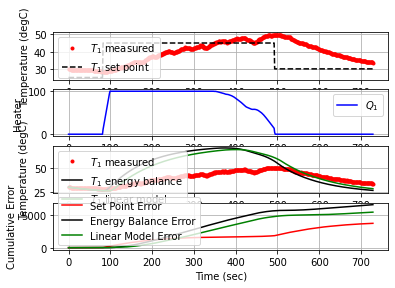

 731.2  30.00  33.34   0.00  -0.66   0.95   0.01


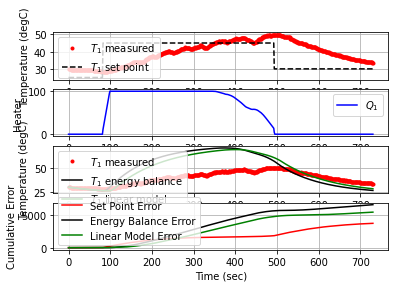

 732.5  30.00  33.42   0.00  -0.66   0.95  -0.00


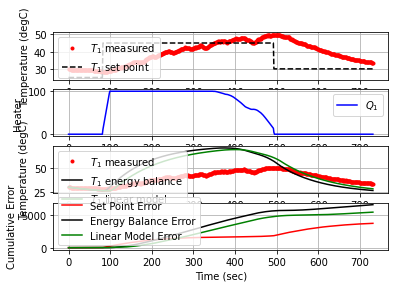

 733.8  30.00  32.90   0.00  -0.59   0.95   0.02


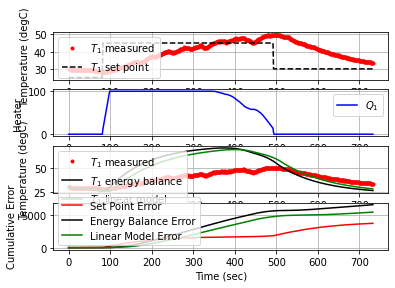

 735.3  30.00  32.85   0.00  -0.56   0.95   0.00


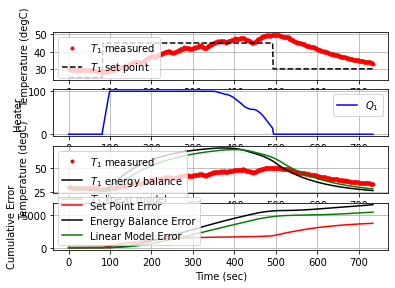

 736.6  30.00  32.58   0.00  -0.51   0.95   0.01


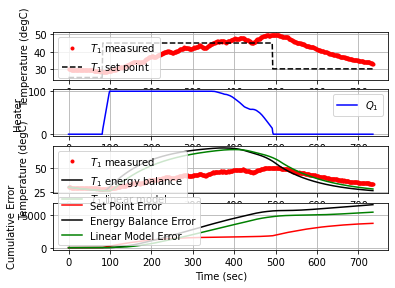

 738.0  30.00  32.47   0.00  -0.49   0.95   0.00


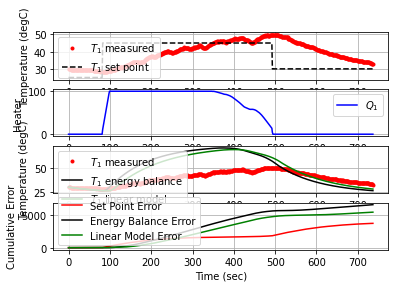

 739.4  30.00  32.25   0.00  -0.45   0.95   0.01


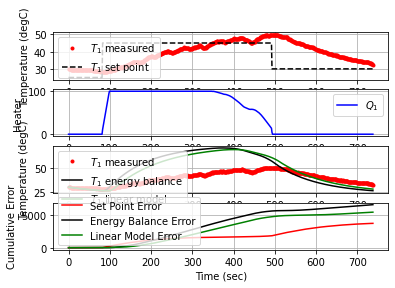

 740.7  30.00  32.26   0.00  -0.44   0.95  -0.00


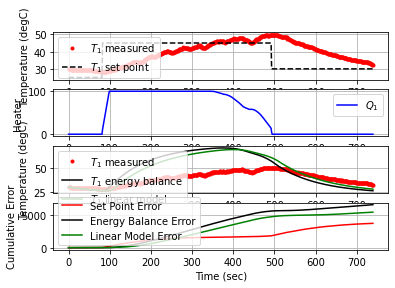

 742.2  30.00  32.18   0.00  -0.43   0.95   0.00


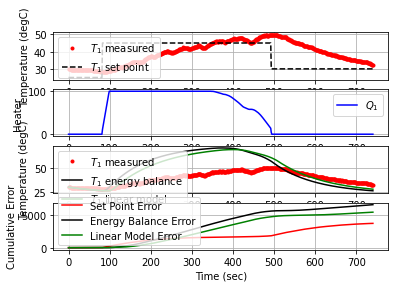

 743.5  30.00  32.23   0.00  -0.44   0.95  -0.00


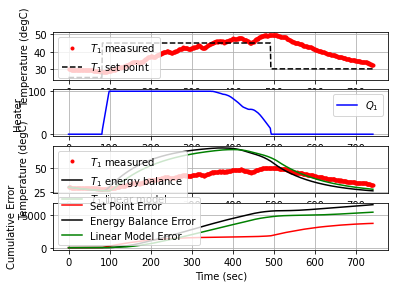

 744.8  30.00  32.16   0.00  -0.43   0.95   0.00


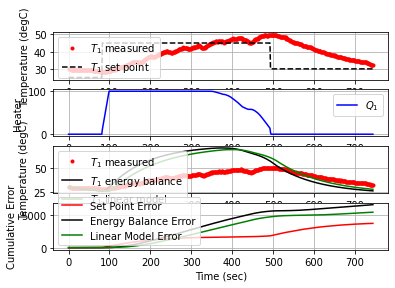

 746.2  30.00  32.48   0.00  -0.48   0.95  -0.01


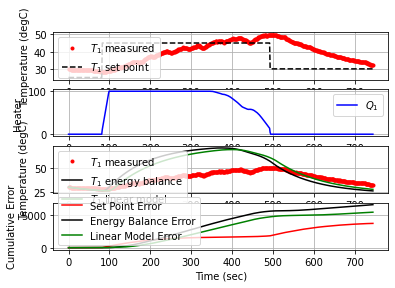

 747.6  30.00  32.41   0.00  -0.48   0.95   0.00


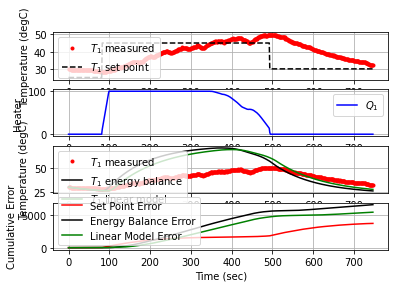

 749.3  30.00  32.32   0.00  -0.46   0.95   0.00


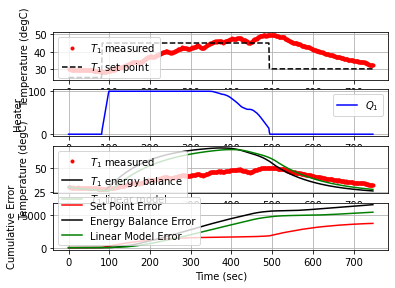

 750.7  30.00  32.30   0.00  -0.45   0.95   0.00


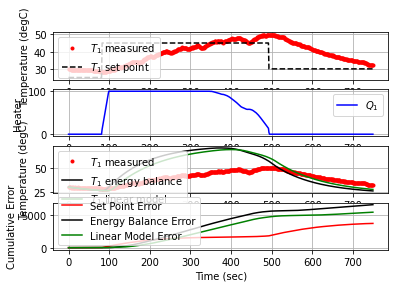

 752.1  30.00  32.48   0.00  -0.48   0.95  -0.01


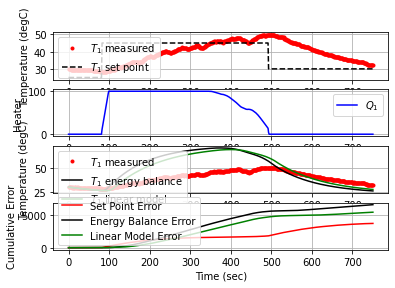

 753.4  30.00  32.34   0.00  -0.46   0.95   0.01


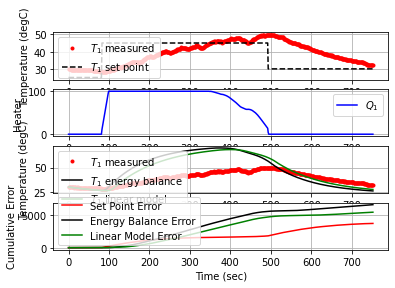

 754.7  30.00  32.29   0.00  -0.45   0.95   0.00


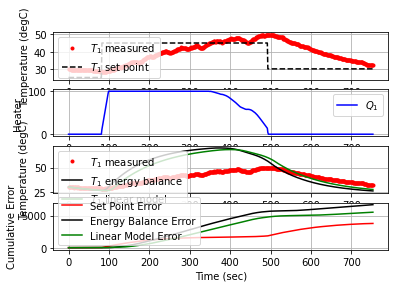

 756.3  30.00  32.04   0.00  -0.41   0.95   0.01


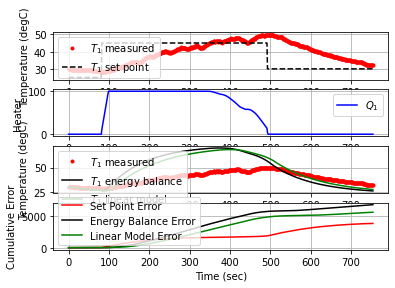

 757.8  30.00  32.09   0.00  -0.41   0.95  -0.00
Shutting down
Arduino disconnected successfully
Arduino disconnected successfully


True

<Figure size 432x288 with 0 Axes>

In [24]:
######################################################
# Do not adjust anything below this point            #
######################################################

# Connect to Arduino
a = itclab.iTCLab()
#a.encode('utf-8').strip()#modification error
# Turn LED on
print('LED On')
a.LED(100)

# Run time in minutes
run_time = 15.0

# Number of cycles
loops = int(60.0*run_time)
tm = np.zeros(loops)

# Temperature
# set point (degC)
Tsp1 = np.ones(loops) * 25.0 
Tsp1[60:] = 45.0
Tsp1[360:] = 30.0
Tsp1[660:] = 35.0
T1 = np.ones(loops) * a.T1 # measured T (degC)
error_sp = np.zeros(loops)

Tsp2 = np.ones(loops) * 23.0 # set point (degC)
T2 = np.ones(loops) * a.T2 # measured T (degC)

# Predictions
Tp = np.ones(loops) * a.T1
error_eb = np.zeros(loops)
Tpl = np.ones(loops) * a.T1
error_fopdt = np.zeros(loops)

# impulse tests (0 - 100%)
Q1 = np.ones(loops) * 0.0
Q2 = np.ones(loops) * 0.0

print('Running Main Loop. Ctrl-C to end.')
print('  Time     SP     PV     Q1   =  P   +  I  +   D')
print(('{:6.1f} {:6.2f} {:6.2f} ' + \
       '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
           tm[0],Tsp1[0],T1[0], \
           Q1[0],0.0,0.0,0.0))

# Create plot
plt.figure(figsize=(10,7))
plt.ion()
plt.show()

# Main Loop
start_time = time.time()
prev_time = start_time
# Integral error
ierr = 0.0
try:
    for i in range(1,loops):
        # Sleep time
        sleep_max = 1.0
        sleep = sleep_max - (time.time() - prev_time)
        if sleep>=0.01:
            time.sleep(sleep-0.01)
        else:
            time.sleep(0.01)

        # Record time and change in time
        t = time.time()
        dt = t - prev_time
        prev_time = t
        tm[i] = t - start_time

        # Read temperatures in Kelvin 
        T1[i] = a.T1
        T2[i] = a.T2

        # Simulate one time step with Energy Balance
        Tnext = odeint(heat,Tp[i-1]+273.15,[0,dt],args=(Q1[i-1],))
        Tp[i] = Tnext[1]-273.15

        # Simulate one time step with linear FOPDT model
        z = np.exp(-dt/tauP)
        Tpl[i] = (Tpl[i-1]-Tss) * z \
                 + (Q1[max(0,i-int(thetaP)-1)]-Qss)*(1-z)*Kp \
                 + Tss

        # Calculate PID Output (Choose one of them)
        # 1. Manually Choosen
#         [Q1[i],P,ierr,D] = pid(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # 2. Based on Deep Learning Result
        [Q1[i],P,ierr,D] = pid_dl(Tsp1[i],T1[i],T1[i-1],ierr,dt)

        # Start setpoint error accumulation after 1 minute (60 seconds)
        if i>=60:
            error_eb[i] = error_eb[i-1] + abs(Tp[i]-T1[i])
            error_fopdt[i] = error_fopdt[i-1] + abs(Tpl[i]-T1[i])
            error_sp[i] = error_sp[i-1] + abs(Tsp1[i]-T1[i])

        # Write output (0-100)
        a.Q1(Q1[i])
        a.Q2(0.0)

        # Print line of data
        print(('{:6.1f} {:6.2f} {:6.2f} ' + \
              '{:6.2f} {:6.2f} {:6.2f} {:6.2f}').format( \
                  tm[i],Tsp1[i],T1[i], \
                  Q1[i],P,ierr,D))

        # Plot
        plt.clf()
        ax=plt.subplot(4,1,1)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tsp1[0:i],'k--',label=r'$T_1$ set point')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,2)
        ax.grid()
        plt.plot(tm[0:i],Q1[0:i],'b-',label=r'$Q_1$')
        plt.ylabel('Heater')
        plt.legend(loc='best')
        ax=plt.subplot(4,1,3)
        ax.grid()
        plt.plot(tm[0:i],T1[0:i],'r.',label=r'$T_1$ measured')
        plt.plot(tm[0:i],Tp[0:i],'k-',label=r'$T_1$ energy balance')
        plt.plot(tm[0:i],Tpl[0:i],'g-',label=r'$T_1$ linear model')
        plt.ylabel('Temperature (degC)')
        plt.legend(loc=2)
        ax=plt.subplot(4,1,4)
        ax.grid()
        plt.plot(tm[0:i],error_sp[0:i],'r-',label='Set Point Error')
        plt.plot(tm[0:i],error_eb[0:i],'k-',label='Energy Balance Error')
        plt.plot(tm[0:i],error_fopdt[0:i],'g-',label='Linear Model Error')
        plt.ylabel('Cumulative Error')
        plt.legend(loc='best')
        plt.xlabel('Time (sec)')
        plt.draw()
        plt.pause(0.05)

    # Turn off heaters
    a.Q1(0)
    a.Q2(0)
    # Save figure
    plt.savefig('test_PID_dl.png')

# Allow user to end loop with Ctrl-C           
except KeyboardInterrupt:
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')

# Make sure serial connection still closes when there's an error
except:           
    # Disconnect from Arduino
    a.Q1(0)
    a.Q2(0)
    print('Error: Shutting down')
    a.close()
    plt.savefig('test_PID_dl.png')
    raise

a.close()

In [25]:
a.close()

Arduino disconnected successfully


True